<a href="https://colab.research.google.com/github/rajy4683/EVAP2/blob/master/IndianCars_R1GAN3_adam_20800_cl1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Implementation of Deep Convolutional GANs
Reference: https://arxiv.org/pdf/1511.06434.pdf

In [ ]:
!nvidia-smi

Sun Sep 20 09:37:03 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.66       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Run the comment below only when using Google Colab
# !pip install torch torchvision

In [ ]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F

In [ ]:
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
from torchvision import datasets
from torchvision import transforms
from torchvision.utils import save_image

In [ ]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import grad

In [ ]:
import numpy as np
import datetime
import os, sys

In [ ]:
import glob

In [ ]:
from PIL import Image
from matplotlib import pyplot as plt

In [ ]:
from matplotlib.pyplot import imshow, imsave
%matplotlib inline
# Set random seed for reproducibility
import random
manualSeed = 0xdeadbeef
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  3735928559


In [ ]:
MODEL_NAME = 'R1GAN'
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
IMAGE_DIM = (128, 128, 3)

In [ ]:
def get_sample_image(G, n_noise):
    """
        save sample 100 images
    """
    z = torch.randn(10, n_noise).to(DEVICE)
    y_hat = G(z).view(10, 3, 28, 28).permute(0, 2, 3, 1) # (100, 28, 28)
    result = (y_hat.detach().cpu().numpy()+1)/2.
    return result

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!cp /content/drive/My\ Drive/EVA4/S2GAN/allCars.tar.gz /content
!cp /content/drive/My\ Drive/EVA4/S2GAN/allCars_nobg.tar.gz /content
!tar -zxvf allCars.tar.gz
!tar -zxvf allCars_nobg.tar.gz



Mounted at /content/drive
allCars/
allCars/duster_00000002.jpg
allCars/duster_00000003.jpg
allCars/duster_00000004.jpg
allCars/duster_00000005.jpg
allCars/duster_00000006.jpg
allCars/duster_00000008.jpg
allCars/duster_00000009.jpg
allCars/duster_00000010.jpg
allCars/duster_00000013.jpg
allCars/duster_00000014.jpg
allCars/duster_00000015.jpg
allCars/duster_00000016.jpg
allCars/duster_00000017.jpg
allCars/duster_00000018.jpg
allCars/duster_00000019.jpg
allCars/duster_00000020.jpg
allCars/duster_00000022.jpg
allCars/duster_00000024.jpg
allCars/duster_00000025.jpg
allCars/duster_00000026.jpg
allCars/duster_00000032.jpg
allCars/duster_00000033.jpg
allCars/duster_00000034.jpg
allCars/duster_00000035.jpg
allCars/duster_00000036.jpg
allCars/duster_00000037.jpg
allCars/duster_00000040.jpg
allCars/duster_00000041.jpg
allCars/duster_00000042.jpg
allCars/duster_00000044.jpg
allCars/duster_00000045.jpg
allCars/duster_00000046.jpg
allCars/duster_00000047.jpg
allCars/duster_00000048.jpg
allCars/duste

In [ ]:
!mv content/allCars_nobg/ /content

In [ ]:
# Root directory for dataset
dataroot = "/content/allCars_nobg"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1


In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, inplanes, planes, kernel_size=3, stride=1, downsample=None, groups=1):
        super(ResidualBlock, self).__init__()
        p = kernel_size//2
        self.conv1 = nn.Sequential(
            nn.Conv2d(inplanes, planes, kernel_size, stride=stride, padding=p),
            nn.LeakyReLU(0.2)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(planes, planes, kernel_size, padding=p),
            nn.LeakyReLU(0.2)
        )
        self.proj = nn.Conv2d(inplanes, planes, 1) if inplanes != planes else None
    
    def forward(self, x):
        identity = x
        
        y = self.conv1(x)
        y = self.conv2(y)
        
        identity = identity if self.proj is None else self.proj(identity)
        y = y + identity
        return y
class Discriminator(nn.Module):
    """
        Convolutional Discriminator
    """
    def __init__(self, in_channel=1, ngpu=1):
        self.ngpu = ngpu
        super(Discriminator, self).__init__()
        self.D = nn.Sequential(
            nn.Conv2d(in_channel, 64, 3, padding=1), # (N, 64, 64, 64)
            ResidualBlock(64, 128),
            nn.AvgPool2d(3, 2, padding=1), # (N, 128, 32, 32)
            ResidualBlock(128, 256),
            nn.AvgPool2d(3, 2, padding=1), # (N, 256, 16, 16)
            ResidualBlock(256, 512),
            nn.AvgPool2d(3, 2, padding=1), # (N, 512, 8, 8)
            ResidualBlock(512, 1024),
            nn.AvgPool2d(3, 2, padding=1) # (N, 1024, 4, 4)
        )
        self.fc = nn.Linear(1024*4*4, 1) # (N, 1)
        
    def forward(self, x):
        B = x.size(0)
        h = self.D(x)
        h = h.view(B, -1)
        y = self.fc(h)
        return y

class Generator(nn.Module):
    """
        Convolutional Generator
    """
    def __init__(self, out_channel=1, n_filters=128, n_noise=512,ngpu=1):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.fc = nn.Linear(n_noise, 1024*4*4)
        self.G = nn.Sequential(
            ResidualBlock(1024, 512),
            nn.Upsample(scale_factor=2, mode='bilinear'), # (N, 512, 8, 8)
            ResidualBlock(512, 256),
            nn.Upsample(scale_factor=2, mode='bilinear'), # (N, 256, 16, 16)
            ResidualBlock(256, 128),
            nn.Upsample(scale_factor=2, mode='bilinear'), # (N, 128, 32, 32)
            ResidualBlock(128, 64),
            nn.Upsample(scale_factor=2, mode='bilinear'), # (N, 64, 64, 64)
            ResidualBlock(64, 64),
            nn.Conv2d(64, out_channel, 3, padding=1) # (N, 3, 64, 64)
        )
        
    def forward(self, z):
        B = z.size(0)
        h = self.fc(z)
        h = h.view(B, 1024, 4, 4)
        x = self.G(h)
        return x

In [ ]:
class CARS(Dataset):
    '''
    CARS Dataset
    You should download this dataset from below url.
    url: https://ai.stanford.edu/~jkrause/cars/car_dataset.html
    '''
    def __init__(self, data_path, transform=None):
        '''
        Args:
            data_path (str): path to dataset
        '''
        self.data_path = data_path
        self.transform = transform
        self.fpaths = sorted(glob.glob(os.path.join(data_path, '*.jpg')))
        #gray_lst = [266, 1085, 2176, 3048, 3439, 3469, 3539, 4577, 4848, 5177, 5502, 5713, 6947, 7383, 7693, 7774, 8137, 8144]
        #for num in gray_lst:
        #    self.fpaths.remove(os.path.join(data_path, '{:05d}.jpg'.format(num)))
        
    def __getitem__(self, idx):
        img = self.transform(Image.open(self.fpaths[idx]))
        return img

    def __len__(self):
        return len(self.fpaths)

In [ ]:
image_size=64
transform = transforms.Compose([transforms.Resize((image_size,image_size)),
                                transforms.CenterCrop(image_size),
                                transforms.ToTensor(),                                
                                transforms.Normalize(mean=(0.5, 0.5, 0.5),
                                std=(0.5, 0.5, 0.5))
                               ]
)

In [ ]:
#dataset = CARS(data_path='/home/yangyangii/git/cars_train', transform=transform)
# dataset = CARS(data_path='/content/allCars', transform=transform)
# data_loader = DataLoader(dataset=dataset, batch_size=batch_size, shuffle=True, drop_last=True, num_workers=8)

dataset = CARS(data_path='/content/allCars_nobg', transform=transform)
data_loader = DataLoader(dataset=dataset, batch_size=batch_size, shuffle=True, drop_last=True, num_workers=8)

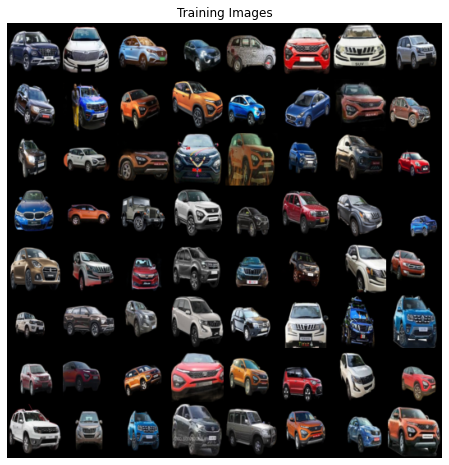

In [ ]:
import torchvision.utils as vutils

real_batch = next(iter(data_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
#netD = Discriminator(ngpu).to(device)
IMAGE_DIM=(64,64,3)
n_noise = 256
netD = Discriminator(in_channel=IMAGE_DIM[-1]).to(DEVICE)

#G = 


# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

# Create the generator
#netG = Generator(ngpu).to(device)
netG =Generator(out_channel=IMAGE_DIM[-1], n_noise=n_noise).to(DEVICE)
# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)



Discriminator(
  (D): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2)
      )
      (conv2): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2)
      )
      (proj): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1))
    )
    (2): AvgPool2d(kernel_size=3, stride=2, padding=1)
    (3): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2)
      )
      (proj): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
    )
    (4): Av

In [ ]:
D = netD
G = netG
#D_opt = torch.optim.RMSprop(D.parameters(), lr=1e-4, alpha=0.99)
#G_opt = torch.optim.RMSprop(G.parameters(), lr=1e-4, alpha=0.99)
# D_opt = torch.optim.Adam(D.parameters(), lr=2e-4, alpha=0.99)
# G_opt = torch.optim.Adam(G.parameters(), lr=2e-4, alpha=0.99)

D_opt = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
G_opt = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))

def r1loss(inputs, label=None):
    # non-saturating loss with R1 regularization
    l = -1 if label else 1
    return F.softplus(l*inputs).mean()

max_epoch = 100
step = 0

log_term = 1000
save_term = 1000

r1_gamma = 10

steps_per_epoch = len(data_loader.dataset) // batch_size
steps_per_epoch

import os
if not os.path.exists('samples'):
    os.makedirs('samples')
    
if not os.path.exists('ckpt'):
    os.makedirs('ckpt')

def save_checkpoint(state, file_name='checkpoint.pth.tar'):
    torch.save(state, file_name)


In [ ]:
def tensor2img(tensor):
    img = (np.transpose(tensor.detach().cpu().numpy(), [1,2,0])+1)/2.
    return img
def get_sample_image(G, n_noise=100, n_samples=64):
    """
        save sample 100 images
    """
    n_rows = int(np.sqrt(n_samples))
    z = (torch.rand(size=[n_samples, n_noise])*2-1).to(DEVICE) # U[-1, 1]
    x_fake = G(z)
    x_fake = torch.cat([torch.cat([x_fake[n_rows*j+i] for i in range(n_rows)], dim=1) for j in range(n_rows)], dim=2)
    result = tensor2img(x_fake)
    return result,z

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 200
r1_gamma=10
G_losses = []
D_losses = []
img_list = []
step=2800


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
#     D_scheduler.step()
#     G_scheduler.step()

In [ ]:
save_checkpoint({'global_step': step,
        'D':D.state_dict(),
        'G':G.state_dict(),
        'd_optim': D_opt.state_dict(),
        'g_optim' : G_opt.state_dict()},
    'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))

rand_z=create_graphs_and_samples(img_list, data_loader)

In [ ]:
# weights_path = "/content/ckpt/r1gan_adam002800.pth.tar"
# checkpoint = torch.load(weights_path)
# D.load_state_dict(checkpoint['D'])
# G.load_state_dict(checkpoint['G'])
# D_opt.load_state_dict(checkpoint['d_optim'])
# G_opt.load_state_dict(checkpoint['g_optim'])

#rand_z = generate_image_sample((50,50))

rand_z=create_graphs_and_samples(img_list, data_loader)

In [ ]:
!cp /content/ckpt/r1gan_adam002800.pth.tar /content/drive/My\ Drive/EVA4/S2GAN/r1gan_adam002800_nobg.pth.tar
#!cp /content/ckpt/r1gan003800.pth.tar /content/drive/My\ Drive/EVA4/S2GAN
#!cp /content/ckpt/Newr1gan004651.pth.tar /content/drive/My\ Drive/EVA4/S2GAN

In [ ]:
from torch.optim.lr_scheduler import StepLR, OneCycleLR, MultiStepLR, CyclicLR

D_scheduler = StepLR(D_opt, step_size=2, gamma=0.5)
G_scheduler = StepLR(G_opt, step_size=2, gamma=0.5)

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 200
r1_gamma=7
# G_losses = []
# D_losses = []
# img_list = []
# step=0


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    D_scheduler.step()
    G_scheduler.step()

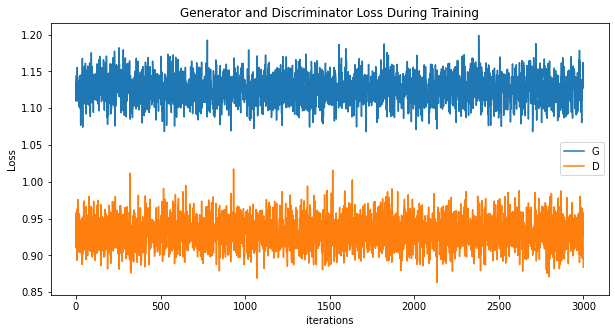

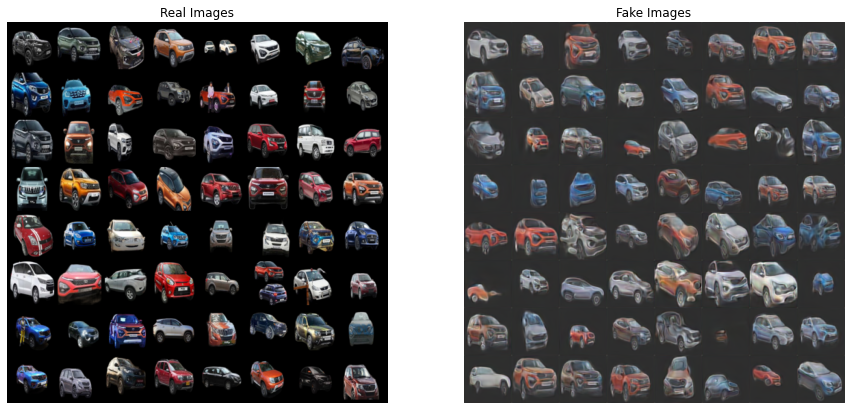

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


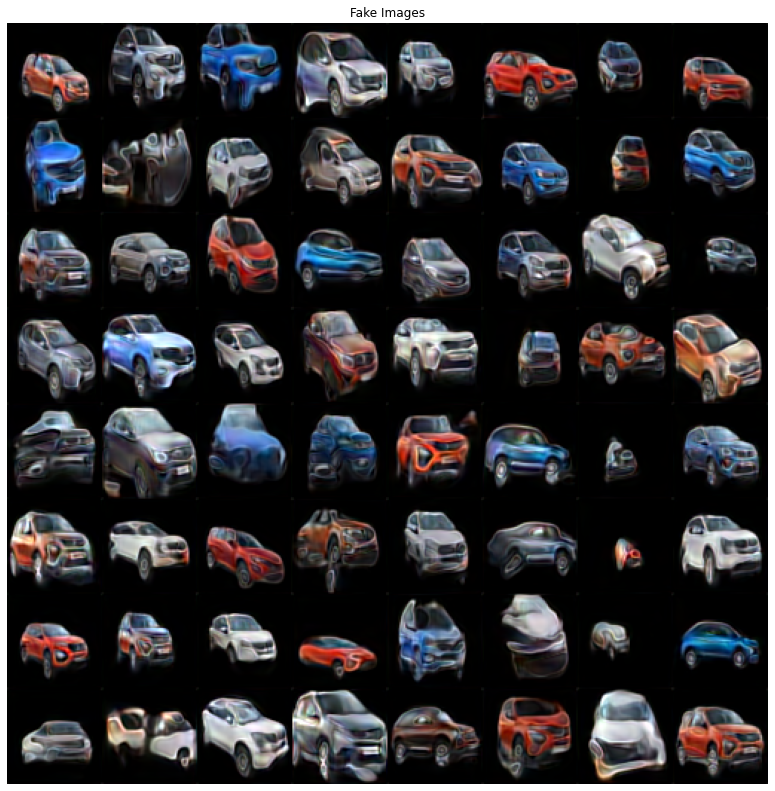

tensor([[-4.3889e-01, -7.1591e-01,  2.1669e-01,  ..., -5.7334e-01,
          1.1914e-01, -3.9618e-01],
        [-2.9256e-01,  9.5928e-04,  7.9114e-01,  ..., -2.5068e-01,
          1.4398e-02,  9.5559e-01],
        [-9.5421e-02, -3.4902e-02, -4.4206e-01,  ..., -4.0625e-01,
         -3.1510e-01, -9.0591e-01],
        ...,
        [-8.3406e-01,  8.0492e-01, -9.1669e-01,  ..., -9.8687e-01,
          6.2354e-01,  6.1570e-01],
        [ 9.2129e-01,  3.1343e-01,  4.7825e-01,  ..., -7.1300e-01,
         -4.1599e-01,  2.0996e-01],
        [-7.9794e-01,  9.4733e-01,  9.3879e-01,  ...,  6.5841e-01,
          8.1594e-01, -6.2868e-01]], device='cuda:0')

In [ ]:
save_checkpoint({'global_step': step,
        'D':D.state_dict(),
        'G':G.state_dict(),
        'd_optim': D_opt.state_dict(),
        'g_optim' : G_opt.state_dict()},
    'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
create_graphs_and_samples(img_list, data_loader)

In [ ]:
weights_path = "/content/ckpt/r1gan_adam020800.pth.tar"
checkpoint = torch.load(weights_path)
D.load_state_dict(checkpoint['D'])
G.load_state_dict(checkpoint['G'])
D_opt.load_state_dict(checkpoint['d_optim'])
G_opt.load_state_dict(checkpoint['g_optim'])



#rand_z = create_graphs_and_samples(img_list, data_loader,(50,50))

rand_z = generate_image_sample((50,50))

#create_graphs_and_samples(img_list, data_loader)

In [ ]:
!cp /content/ckpt/r1gan_adam020800.pth.tar /content/drive/My\ Drive/EVA4/S2GAN/

In [ ]:
!cp /content/drive/My\ Drive/EVA4/S2GAN/r1gan_adam020800.pth.tar /content/ckpt/

In [ ]:
!cp  /content/drive/My\ Drive/EVA4/S2GAN/r1gan_adam017816.pth.tar /content/ckpt

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 500
r1_gamma=6
# G_losses = []
# D_losses = []
# img_list = []
# step=0


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    D_scheduler.step()
    G_scheduler.step()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  app.launch_new_instance()


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch: 0/500, Step: 10320, D Loss: 0.9404, G Loss: 1.1286, gp: 0.1508, Time:20:42:51
Epoch: 0/500, Step: 10330, D Loss: 0.9860, G Loss: 1.1175, gp: 0.1403, Time:20:42:59



Epoch: 1/500, Step: 10340, D Loss: 0.9373, G Loss: 1.1457, gp: 0.1500, Time:20:43:10



Epoch: 2/500, Step: 10350, D Loss: 0.9629, G Loss: 1.0947, gp: 0.1507, Time:20:43:21
Epoch: 2/500, Step: 10360, D Loss: 0.9299, G Loss: 1.1521, gp: 0.1453, Time:20:43:29



Epoch: 3/500, Step: 10370, D Loss: 0.9385, G Loss: 1.1012, gp: 0.1522, Time:20:43:40



Epoch: 4/500, Step: 10380, D Loss: 0.9606, G Loss: 1.1274, gp: 0.1455, Time:20:43:50
Epoch: 4/500, Step: 10390, D Loss: 0.9650, G Loss: 1.1041, gp: 0.1406, Time:20:43:59



Epoch: 5/500, Step: 10400, D Loss: 0.9609, G Loss: 1.1195, gp: 0.1420, Time:20:44:11



Epoch: 6/500, Step: 10410, D Loss: 0.9445, G Loss: 1.1138, gp: 0.1410, Time:20:44:22
Epoch: 6/500, Step: 10420, D Loss: 0.9718, G Loss: 1.1427, gp: 0.1462, Time:20:44:31



Epoch: 7/500, Step: 10430, D Loss: 0.9259, G Loss: 1.1172, gp: 0.1489, Time:20:44:41



Epoch: 8/500, Step: 10440, D Loss: 0.9254, G Loss: 1.1472, gp: 0.1456, Time:20:44:52
Epoch: 8/500, Step: 10450, D Loss: 0.9779, G Loss: 1.1484, gp: 0.1464, Time:20:45:01



Epoch: 9/500, Step: 10460, D Loss: 0.9416, G Loss: 1.1312, gp: 0.1457, Time:20:45:11



Epoch: 10/500, Step: 10470, D Loss: 0.9483, G Loss: 1.1288, gp: 0.1489, Time:20:45:22
Epoch: 10/500, Step: 10480, D Loss: 0.9822, G Loss: 1.0857, gp: 0.1440, Time:20:45:31



Epoch: 11/500, Step: 10490, D Loss: 0.9541, G Loss: 1.1253, gp: 0.1483, Time:20:45:42



Epoch: 12/500, Step: 10500, D Loss: 0.9672, G Loss: 1.1614, gp: 0.1492, Time:20:45:52
Epoch: 12/500, Step: 10510, D Loss: 0.9497, G Loss: 1.1355, gp: 0.1449, Time:20:46:01



Epoch: 13/500, Step: 10520, D Loss: 0.9870, G Loss: 1.1613, gp: 0.1435, Time:20:46:12



Epoch: 14/500, Step: 10530, D Loss: 0.9754, G Loss: 1.1238, gp: 0.1435, Time:20:46:22
Epoch: 14/500, Step: 10540, D Loss: 0.9417, G Loss: 1.1049, gp: 0.1469, Time:20:46:31



Epoch: 15/500, Step: 10550, D Loss: 0.9659, G Loss: 1.1262, gp: 0.1498, Time:20:46:41



Epoch: 16/500, Step: 10560, D Loss: 0.9873, G Loss: 1.1585, gp: 0.1486, Time:20:46:52
Epoch: 16/500, Step: 10570, D Loss: 0.9315, G Loss: 1.1089, gp: 0.1475, Time:20:47:01



Epoch: 17/500, Step: 10580, D Loss: 0.9852, G Loss: 1.1431, gp: 0.1446, Time:20:47:11



Epoch: 18/500, Step: 10590, D Loss: 0.9629, G Loss: 1.1260, gp: 0.1446, Time:20:47:22
Epoch: 18/500, Step: 10600, D Loss: 0.9626, G Loss: 1.1163, gp: 0.1484, Time:20:47:32



Epoch: 19/500, Step: 10610, D Loss: 0.9742, G Loss: 1.1352, gp: 0.1475, Time:20:47:43



Epoch: 20/500, Step: 10620, D Loss: 0.9734, G Loss: 1.1136, gp: 0.1426, Time:20:47:54
Epoch: 20/500, Step: 10630, D Loss: 0.9174, G Loss: 1.0873, gp: 0.1390, Time:20:48:02



Epoch: 21/500, Step: 10640, D Loss: 0.9453, G Loss: 1.1128, gp: 0.1416, Time:20:48:13



Epoch: 22/500, Step: 10650, D Loss: 0.9602, G Loss: 1.1161, gp: 0.1451, Time:20:48:23
Epoch: 22/500, Step: 10660, D Loss: 0.9981, G Loss: 1.1326, gp: 0.1406, Time:20:48:32



Epoch: 23/500, Step: 10670, D Loss: 0.9921, G Loss: 1.0885, gp: 0.1447, Time:20:48:43



Epoch: 24/500, Step: 10680, D Loss: 0.9879, G Loss: 1.1224, gp: 0.1470, Time:20:48:54
Epoch: 24/500, Step: 10690, D Loss: 0.9398, G Loss: 1.1068, gp: 0.1521, Time:20:49:02



Epoch: 25/500, Step: 10700, D Loss: 0.9428, G Loss: 1.1091, gp: 0.1461, Time:20:49:13



Epoch: 26/500, Step: 10710, D Loss: 0.9655, G Loss: 1.1230, gp: 0.1462, Time:20:49:24
Epoch: 26/500, Step: 10720, D Loss: 0.9441, G Loss: 1.1306, gp: 0.1472, Time:20:49:32



Epoch: 27/500, Step: 10730, D Loss: 0.9512, G Loss: 1.0812, gp: 0.1471, Time:20:49:43



Epoch: 28/500, Step: 10740, D Loss: 0.9444, G Loss: 1.1550, gp: 0.1458, Time:20:49:54
Epoch: 28/500, Step: 10750, D Loss: 0.9590, G Loss: 1.1484, gp: 0.1490, Time:20:50:02



Epoch: 29/500, Step: 10760, D Loss: 0.9498, G Loss: 1.0947, gp: 0.1427, Time:20:50:13



Epoch: 30/500, Step: 10770, D Loss: 0.9735, G Loss: 1.1396, gp: 0.1454, Time:20:50:23
Epoch: 30/500, Step: 10780, D Loss: 0.9240, G Loss: 1.1068, gp: 0.1515, Time:20:50:32



Epoch: 31/500, Step: 10790, D Loss: 0.9504, G Loss: 1.1355, gp: 0.1502, Time:20:50:43



Epoch: 32/500, Step: 10800, D Loss: 0.9468, G Loss: 1.1430, gp: 0.1412, Time:20:50:55
Epoch: 32/500, Step: 10810, D Loss: 0.9936, G Loss: 1.1147, gp: 0.1487, Time:20:51:04



Epoch: 33/500, Step: 10820, D Loss: 0.9902, G Loss: 1.1386, gp: 0.1470, Time:20:51:15



Epoch: 34/500, Step: 10830, D Loss: 0.9627, G Loss: 1.1224, gp: 0.1479, Time:20:51:25
Epoch: 34/500, Step: 10840, D Loss: 0.9654, G Loss: 1.1485, gp: 0.1461, Time:20:51:34



Epoch: 35/500, Step: 10850, D Loss: 0.9970, G Loss: 1.1243, gp: 0.1405, Time:20:51:44



Epoch: 36/500, Step: 10860, D Loss: 0.9638, G Loss: 1.1285, gp: 0.1378, Time:20:51:55
Epoch: 36/500, Step: 10870, D Loss: 0.9286, G Loss: 1.1040, gp: 0.1592, Time:20:52:04



Epoch: 37/500, Step: 10880, D Loss: 0.9346, G Loss: 1.1444, gp: 0.1487, Time:20:52:14



Epoch: 38/500, Step: 10890, D Loss: 0.9599, G Loss: 1.1123, gp: 0.1447, Time:20:52:25
Epoch: 38/500, Step: 10900, D Loss: 0.9677, G Loss: 1.1179, gp: 0.1501, Time:20:52:34



Epoch: 39/500, Step: 10910, D Loss: 0.9779, G Loss: 1.1144, gp: 0.1478, Time:20:52:44



Epoch: 40/500, Step: 10920, D Loss: 0.9682, G Loss: 1.0967, gp: 0.1512, Time:20:52:55
Epoch: 40/500, Step: 10930, D Loss: 0.9382, G Loss: 1.1331, gp: 0.1535, Time:20:53:04



Epoch: 41/500, Step: 10940, D Loss: 0.9575, G Loss: 1.1330, gp: 0.1466, Time:20:53:15



Epoch: 42/500, Step: 10950, D Loss: 0.9655, G Loss: 1.1099, gp: 0.1519, Time:20:53:25
Epoch: 42/500, Step: 10960, D Loss: 0.9505, G Loss: 1.1484, gp: 0.1452, Time:20:53:34



Epoch: 43/500, Step: 10970, D Loss: 0.9728, G Loss: 1.1438, gp: 0.1436, Time:20:53:45



Epoch: 44/500, Step: 10980, D Loss: 0.9424, G Loss: 1.1077, gp: 0.1499, Time:20:53:55
Epoch: 44/500, Step: 10990, D Loss: 0.9517, G Loss: 1.1269, gp: 0.1456, Time:20:54:04



Epoch: 45/500, Step: 11000, D Loss: 0.9520, G Loss: 1.1100, gp: 0.1441, Time:20:54:16



Epoch: 46/500, Step: 11010, D Loss: 0.9329, G Loss: 1.1449, gp: 0.1497, Time:20:54:27
Epoch: 46/500, Step: 11020, D Loss: 0.9717, G Loss: 1.1435, gp: 0.1423, Time:20:54:36



Epoch: 47/500, Step: 11030, D Loss: 0.9270, G Loss: 1.1668, gp: 0.1528, Time:20:54:47



Epoch: 48/500, Step: 11040, D Loss: 0.9648, G Loss: 1.1067, gp: 0.1472, Time:20:54:57
Epoch: 48/500, Step: 11050, D Loss: 0.9737, G Loss: 1.1314, gp: 0.1457, Time:20:55:06



Epoch: 49/500, Step: 11060, D Loss: 0.9653, G Loss: 1.1240, gp: 0.1548, Time:20:55:16



Epoch: 50/500, Step: 11070, D Loss: 0.9919, G Loss: 1.1397, gp: 0.1437, Time:20:55:27
Epoch: 50/500, Step: 11080, D Loss: 0.9686, G Loss: 1.1265, gp: 0.1423, Time:20:55:36



Epoch: 51/500, Step: 11090, D Loss: 0.9224, G Loss: 1.1445, gp: 0.1504, Time:20:55:47



Epoch: 52/500, Step: 11100, D Loss: 0.9733, G Loss: 1.0922, gp: 0.1493, Time:20:55:58
Epoch: 52/500, Step: 11110, D Loss: 0.9803, G Loss: 1.1059, gp: 0.1458, Time:20:56:07



Epoch: 53/500, Step: 11120, D Loss: 0.9462, G Loss: 1.1115, gp: 0.1480, Time:20:56:17



Epoch: 54/500, Step: 11130, D Loss: 0.9229, G Loss: 1.1422, gp: 0.1470, Time:20:56:28
Epoch: 54/500, Step: 11140, D Loss: 0.9672, G Loss: 1.1021, gp: 0.1441, Time:20:56:37



Epoch: 55/500, Step: 11150, D Loss: 0.9348, G Loss: 1.0907, gp: 0.1460, Time:20:56:47



Epoch: 56/500, Step: 11160, D Loss: 0.9881, G Loss: 1.1372, gp: 0.1454, Time:20:56:58
Epoch: 56/500, Step: 11170, D Loss: 0.9377, G Loss: 1.1514, gp: 0.1498, Time:20:57:07



Epoch: 57/500, Step: 11180, D Loss: 0.9300, G Loss: 1.0755, gp: 0.1451, Time:20:57:17



Epoch: 58/500, Step: 11190, D Loss: 0.9125, G Loss: 1.1283, gp: 0.1460, Time:20:57:28
Epoch: 58/500, Step: 11200, D Loss: 0.9961, G Loss: 1.1103, gp: 0.1452, Time:20:57:38



Epoch: 59/500, Step: 11210, D Loss: 0.9894, G Loss: 1.0976, gp: 0.1501, Time:20:57:49



Epoch: 60/500, Step: 11220, D Loss: 0.9643, G Loss: 1.1056, gp: 0.1455, Time:20:58:00
Epoch: 60/500, Step: 11230, D Loss: 0.9418, G Loss: 1.1319, gp: 0.1482, Time:20:58:08



Epoch: 61/500, Step: 11240, D Loss: 0.9621, G Loss: 1.1312, gp: 0.1419, Time:20:58:19



Epoch: 62/500, Step: 11250, D Loss: 0.9688, G Loss: 1.1554, gp: 0.1456, Time:20:58:30
Epoch: 62/500, Step: 11260, D Loss: 0.9675, G Loss: 1.1275, gp: 0.1501, Time:20:58:38



Epoch: 63/500, Step: 11270, D Loss: 0.9860, G Loss: 1.1379, gp: 0.1507, Time:20:58:49



Epoch: 64/500, Step: 11280, D Loss: 0.9650, G Loss: 1.1554, gp: 0.1460, Time:20:58:59
Epoch: 64/500, Step: 11290, D Loss: 0.9446, G Loss: 1.1442, gp: 0.1403, Time:20:59:08



Epoch: 65/500, Step: 11300, D Loss: 0.9592, G Loss: 1.1382, gp: 0.1454, Time:20:59:19



Epoch: 66/500, Step: 11310, D Loss: 0.9480, G Loss: 1.1139, gp: 0.1466, Time:20:59:29
Epoch: 66/500, Step: 11320, D Loss: 0.9740, G Loss: 1.1614, gp: 0.1459, Time:20:59:38



Epoch: 67/500, Step: 11330, D Loss: 0.9570, G Loss: 1.1374, gp: 0.1453, Time:20:59:49



Epoch: 68/500, Step: 11340, D Loss: 0.9703, G Loss: 1.1243, gp: 0.1465, Time:20:59:59
Epoch: 68/500, Step: 11350, D Loss: 0.9729, G Loss: 1.1380, gp: 0.1430, Time:21:00:08



Epoch: 69/500, Step: 11360, D Loss: 0.9480, G Loss: 1.0914, gp: 0.1468, Time:21:00:19



Epoch: 70/500, Step: 11370, D Loss: 0.9669, G Loss: 1.1231, gp: 0.1432, Time:21:00:30
Epoch: 70/500, Step: 11380, D Loss: 0.9693, G Loss: 1.1165, gp: 0.1435, Time:21:00:39



Epoch: 71/500, Step: 11390, D Loss: 0.9231, G Loss: 1.1178, gp: 0.1530, Time:21:00:50



Epoch: 72/500, Step: 11400, D Loss: 0.9989, G Loss: 1.1478, gp: 0.1451, Time:21:01:02
Epoch: 72/500, Step: 11410, D Loss: 0.9866, G Loss: 1.1249, gp: 0.1390, Time:21:01:11



Epoch: 73/500, Step: 11420, D Loss: 0.9730, G Loss: 1.0895, gp: 0.1438, Time:21:01:21



Epoch: 74/500, Step: 11430, D Loss: 0.9479, G Loss: 1.1490, gp: 0.1468, Time:21:01:32
Epoch: 74/500, Step: 11440, D Loss: 0.9601, G Loss: 1.1518, gp: 0.1415, Time:21:01:41



Epoch: 75/500, Step: 11450, D Loss: 0.9660, G Loss: 1.1012, gp: 0.1373, Time:21:01:51



Epoch: 76/500, Step: 11460, D Loss: 0.9454, G Loss: 1.1211, gp: 0.1487, Time:21:02:02
Epoch: 76/500, Step: 11470, D Loss: 0.9628, G Loss: 1.1131, gp: 0.1418, Time:21:02:11



Epoch: 77/500, Step: 11480, D Loss: 0.9554, G Loss: 1.1499, gp: 0.1516, Time:21:02:21



Epoch: 78/500, Step: 11490, D Loss: 0.9448, G Loss: 1.1610, gp: 0.1450, Time:21:02:32
Epoch: 78/500, Step: 11500, D Loss: 0.9667, G Loss: 1.1252, gp: 0.1395, Time:21:02:41



Epoch: 79/500, Step: 11510, D Loss: 0.9474, G Loss: 1.1255, gp: 0.1460, Time:21:02:51



Epoch: 80/500, Step: 11520, D Loss: 0.9295, G Loss: 1.1556, gp: 0.1464, Time:21:03:02
Epoch: 80/500, Step: 11530, D Loss: 0.9579, G Loss: 1.1322, gp: 0.1481, Time:21:03:10



Epoch: 81/500, Step: 11540, D Loss: 0.9926, G Loss: 1.1576, gp: 0.1425, Time:21:03:21



Epoch: 82/500, Step: 11550, D Loss: 0.9427, G Loss: 1.1063, gp: 0.1475, Time:21:03:32
Epoch: 82/500, Step: 11560, D Loss: 0.9702, G Loss: 1.0996, gp: 0.1417, Time:21:03:41



Epoch: 83/500, Step: 11570, D Loss: 0.9444, G Loss: 1.1294, gp: 0.1460, Time:21:03:51



Epoch: 84/500, Step: 11580, D Loss: 0.9523, G Loss: 1.1520, gp: 0.1410, Time:21:04:02
Epoch: 84/500, Step: 11590, D Loss: 0.9924, G Loss: 1.1018, gp: 0.1433, Time:21:04:11



Epoch: 85/500, Step: 11600, D Loss: 0.9540, G Loss: 1.1208, gp: 0.1431, Time:21:04:23



Epoch: 86/500, Step: 11610, D Loss: 0.9231, G Loss: 1.1290, gp: 0.1561, Time:21:04:33
Epoch: 86/500, Step: 11620, D Loss: 0.9574, G Loss: 1.1337, gp: 0.1453, Time:21:04:42



Epoch: 87/500, Step: 11630, D Loss: 0.9227, G Loss: 1.1007, gp: 0.1435, Time:21:04:52



Epoch: 88/500, Step: 11640, D Loss: 0.9427, G Loss: 1.1379, gp: 0.1459, Time:21:05:03
Epoch: 88/500, Step: 11650, D Loss: 0.9255, G Loss: 1.1262, gp: 0.1528, Time:21:05:12



Epoch: 89/500, Step: 11660, D Loss: 0.9623, G Loss: 1.1448, gp: 0.1451, Time:21:05:22



Epoch: 90/500, Step: 11670, D Loss: 0.9372, G Loss: 1.1225, gp: 0.1514, Time:21:05:33
Epoch: 90/500, Step: 11680, D Loss: 0.9789, G Loss: 1.1501, gp: 0.1440, Time:21:05:42



Epoch: 91/500, Step: 11690, D Loss: 0.9528, G Loss: 1.1213, gp: 0.1470, Time:21:05:53



Epoch: 92/500, Step: 11700, D Loss: 0.9382, G Loss: 1.1386, gp: 0.1488, Time:21:06:03
Epoch: 92/500, Step: 11710, D Loss: 0.9990, G Loss: 1.0913, gp: 0.1355, Time:21:06:12



Epoch: 93/500, Step: 11720, D Loss: 0.9215, G Loss: 1.1262, gp: 0.1471, Time:21:06:22



Epoch: 94/500, Step: 11730, D Loss: 0.9187, G Loss: 1.1344, gp: 0.1489, Time:21:06:33
Epoch: 94/500, Step: 11740, D Loss: 0.9362, G Loss: 1.1428, gp: 0.1475, Time:21:06:42



Epoch: 95/500, Step: 11750, D Loss: 0.9187, G Loss: 1.1324, gp: 0.1482, Time:21:06:52



Epoch: 96/500, Step: 11760, D Loss: 0.9690, G Loss: 1.1330, gp: 0.1398, Time:21:07:03
Epoch: 96/500, Step: 11770, D Loss: 0.9615, G Loss: 1.1215, gp: 0.1440, Time:21:07:12



Epoch: 97/500, Step: 11780, D Loss: 0.9390, G Loss: 1.1091, gp: 0.1394, Time:21:07:23



Epoch: 98/500, Step: 11790, D Loss: 0.9533, G Loss: 1.1277, gp: 0.1446, Time:21:07:33
Epoch: 98/500, Step: 11800, D Loss: 0.9213, G Loss: 1.1098, gp: 0.1472, Time:21:07:44



Epoch: 99/500, Step: 11810, D Loss: 0.9228, G Loss: 1.1179, gp: 0.1481, Time:21:07:55



Epoch: 100/500, Step: 11820, D Loss: 0.9537, G Loss: 1.1144, gp: 0.1465, Time:21:08:05
Epoch: 100/500, Step: 11830, D Loss: 0.9459, G Loss: 1.1489, gp: 0.1484, Time:21:08:14



Epoch: 101/500, Step: 11840, D Loss: 0.9346, G Loss: 1.1182, gp: 0.1442, Time:21:08:25



Epoch: 102/500, Step: 11850, D Loss: 0.9352, G Loss: 1.1240, gp: 0.1470, Time:21:08:35
Epoch: 102/500, Step: 11860, D Loss: 0.9476, G Loss: 1.1330, gp: 0.1444, Time:21:08:44



Epoch: 103/500, Step: 11870, D Loss: 0.9644, G Loss: 1.1176, gp: 0.1456, Time:21:08:55



Epoch: 104/500, Step: 11880, D Loss: 0.9699, G Loss: 1.1409, gp: 0.1497, Time:21:09:06
Epoch: 104/500, Step: 11890, D Loss: 0.9385, G Loss: 1.1316, gp: 0.1448, Time:21:09:15



Epoch: 105/500, Step: 11900, D Loss: 0.9501, G Loss: 1.1494, gp: 0.1436, Time:21:09:25



Epoch: 106/500, Step: 11910, D Loss: 0.9794, G Loss: 1.1051, gp: 0.1458, Time:21:09:36
Epoch: 106/500, Step: 11920, D Loss: 0.9263, G Loss: 1.1358, gp: 0.1448, Time:21:09:45



Epoch: 107/500, Step: 11930, D Loss: 0.9559, G Loss: 1.1179, gp: 0.1465, Time:21:09:55



Epoch: 108/500, Step: 11940, D Loss: 0.9342, G Loss: 1.1181, gp: 0.1468, Time:21:10:06
Epoch: 108/500, Step: 11950, D Loss: 0.9656, G Loss: 1.1416, gp: 0.1506, Time:21:10:15



Epoch: 109/500, Step: 11960, D Loss: 0.9372, G Loss: 1.1485, gp: 0.1437, Time:21:10:25



Epoch: 110/500, Step: 11970, D Loss: 0.9651, G Loss: 1.1238, gp: 0.1492, Time:21:10:36
Epoch: 110/500, Step: 11980, D Loss: 0.9696, G Loss: 1.1491, gp: 0.1454, Time:21:10:45



Epoch: 111/500, Step: 11990, D Loss: 0.9253, G Loss: 1.1205, gp: 0.1511, Time:21:10:56



Epoch: 112/500, Step: 12000, D Loss: 0.9700, G Loss: 1.1330, gp: 0.1396, Time:21:11:08
Epoch: 112/500, Step: 12010, D Loss: 0.9903, G Loss: 1.1040, gp: 0.1490, Time:21:11:17



Epoch: 113/500, Step: 12020, D Loss: 0.9302, G Loss: 1.1275, gp: 0.1499, Time:21:11:27



Epoch: 114/500, Step: 12030, D Loss: 0.9603, G Loss: 1.0986, gp: 0.1490, Time:21:11:38
Epoch: 114/500, Step: 12040, D Loss: 0.9798, G Loss: 1.1260, gp: 0.1488, Time:21:11:46



Epoch: 115/500, Step: 12050, D Loss: 0.9704, G Loss: 1.0854, gp: 0.1435, Time:21:11:57



Epoch: 116/500, Step: 12060, D Loss: 0.9987, G Loss: 1.1476, gp: 0.1520, Time:21:12:08
Epoch: 116/500, Step: 12070, D Loss: 0.9444, G Loss: 1.1415, gp: 0.1429, Time:21:12:16



Epoch: 117/500, Step: 12080, D Loss: 0.9798, G Loss: 1.1054, gp: 0.1462, Time:21:12:27



Epoch: 118/500, Step: 12090, D Loss: 0.9331, G Loss: 1.1147, gp: 0.1438, Time:21:12:38
Epoch: 118/500, Step: 12100, D Loss: 0.9504, G Loss: 1.1107, gp: 0.1439, Time:21:12:46



Epoch: 119/500, Step: 12110, D Loss: 0.9559, G Loss: 1.1286, gp: 0.1499, Time:21:12:57



Epoch: 120/500, Step: 12120, D Loss: 0.9621, G Loss: 1.1462, gp: 0.1428, Time:21:13:08
Epoch: 120/500, Step: 12130, D Loss: 0.9453, G Loss: 1.1120, gp: 0.1515, Time:21:13:17



Epoch: 121/500, Step: 12140, D Loss: 0.9514, G Loss: 1.1095, gp: 0.1437, Time:21:13:27



Epoch: 122/500, Step: 12150, D Loss: 0.9495, G Loss: 1.1411, gp: 0.1436, Time:21:13:38
Epoch: 122/500, Step: 12160, D Loss: 0.9723, G Loss: 1.1168, gp: 0.1477, Time:21:13:47



Epoch: 123/500, Step: 12170, D Loss: 0.9605, G Loss: 1.1203, gp: 0.1490, Time:21:13:58



Epoch: 124/500, Step: 12180, D Loss: 0.9711, G Loss: 1.1274, gp: 0.1479, Time:21:14:09
Epoch: 124/500, Step: 12190, D Loss: 0.9650, G Loss: 1.1097, gp: 0.1415, Time:21:14:17



Epoch: 125/500, Step: 12200, D Loss: 0.9433, G Loss: 1.1395, gp: 0.1461, Time:21:14:29



Epoch: 126/500, Step: 12210, D Loss: 0.9209, G Loss: 1.1716, gp: 0.1398, Time:21:14:40
Epoch: 126/500, Step: 12220, D Loss: 0.9789, G Loss: 1.1516, gp: 0.1465, Time:21:14:49



Epoch: 127/500, Step: 12230, D Loss: 0.9781, G Loss: 1.1367, gp: 0.1424, Time:21:15:00



Epoch: 128/500, Step: 12240, D Loss: 0.9828, G Loss: 1.1180, gp: 0.1432, Time:21:15:11
Epoch: 128/500, Step: 12250, D Loss: 0.9471, G Loss: 1.1130, gp: 0.1464, Time:21:15:19



Epoch: 129/500, Step: 12260, D Loss: 0.9574, G Loss: 1.1454, gp: 0.1459, Time:21:15:30



Epoch: 130/500, Step: 12270, D Loss: 0.9781, G Loss: 1.1449, gp: 0.1412, Time:21:15:41
Epoch: 130/500, Step: 12280, D Loss: 0.9830, G Loss: 1.1413, gp: 0.1475, Time:21:15:50



Epoch: 131/500, Step: 12290, D Loss: 0.9542, G Loss: 1.1593, gp: 0.1468, Time:21:16:00



Epoch: 132/500, Step: 12300, D Loss: 0.9612, G Loss: 1.1304, gp: 0.1493, Time:21:16:11
Epoch: 132/500, Step: 12310, D Loss: 0.9464, G Loss: 1.1224, gp: 0.1505, Time:21:16:20



Epoch: 133/500, Step: 12320, D Loss: 0.9774, G Loss: 1.1561, gp: 0.1421, Time:21:16:30



Epoch: 134/500, Step: 12330, D Loss: 0.9909, G Loss: 1.1655, gp: 0.1468, Time:21:16:41
Epoch: 134/500, Step: 12340, D Loss: 0.9640, G Loss: 1.1124, gp: 0.1520, Time:21:16:49



Epoch: 135/500, Step: 12350, D Loss: 0.9821, G Loss: 1.1420, gp: 0.1430, Time:21:17:00



Epoch: 136/500, Step: 12360, D Loss: 0.9431, G Loss: 1.1525, gp: 0.1417, Time:21:17:11
Epoch: 136/500, Step: 12370, D Loss: 0.9608, G Loss: 1.1147, gp: 0.1451, Time:21:17:19



Epoch: 137/500, Step: 12380, D Loss: 0.9854, G Loss: 1.1111, gp: 0.1406, Time:21:17:30



Epoch: 138/500, Step: 12390, D Loss: 0.9685, G Loss: 1.1140, gp: 0.1374, Time:21:17:41
Epoch: 138/500, Step: 12400, D Loss: 0.9721, G Loss: 1.1514, gp: 0.1445, Time:21:17:51



Epoch: 139/500, Step: 12410, D Loss: 0.9572, G Loss: 1.1693, gp: 0.1463, Time:21:18:01



Epoch: 140/500, Step: 12420, D Loss: 0.9399, G Loss: 1.1157, gp: 0.1554, Time:21:18:12
Epoch: 140/500, Step: 12430, D Loss: 0.9650, G Loss: 1.1227, gp: 0.1451, Time:21:18:21



Epoch: 141/500, Step: 12440, D Loss: 0.9118, G Loss: 1.1440, gp: 0.1488, Time:21:18:31



Epoch: 142/500, Step: 12450, D Loss: 0.9716, G Loss: 1.1309, gp: 0.1513, Time:21:18:42
Epoch: 142/500, Step: 12460, D Loss: 0.9894, G Loss: 1.1475, gp: 0.1420, Time:21:18:51



Epoch: 143/500, Step: 12470, D Loss: 0.9484, G Loss: 1.1521, gp: 0.1526, Time:21:19:02



Epoch: 144/500, Step: 12480, D Loss: 0.9267, G Loss: 1.1203, gp: 0.1519, Time:21:19:12
Epoch: 144/500, Step: 12490, D Loss: 0.9750, G Loss: 1.0928, gp: 0.1483, Time:21:19:21



Epoch: 145/500, Step: 12500, D Loss: 0.9658, G Loss: 1.1455, gp: 0.1435, Time:21:19:32



Epoch: 146/500, Step: 12510, D Loss: 0.9704, G Loss: 1.1566, gp: 0.1471, Time:21:19:43
Epoch: 146/500, Step: 12520, D Loss: 0.9592, G Loss: 1.1269, gp: 0.1418, Time:21:19:51



Epoch: 147/500, Step: 12530, D Loss: 0.9553, G Loss: 1.1737, gp: 0.1550, Time:21:20:02



Epoch: 148/500, Step: 12540, D Loss: 0.9568, G Loss: 1.1361, gp: 0.1455, Time:21:20:12
Epoch: 148/500, Step: 12550, D Loss: 0.9414, G Loss: 1.1205, gp: 0.1515, Time:21:20:21



Epoch: 149/500, Step: 12560, D Loss: 0.9445, G Loss: 1.1030, gp: 0.1473, Time:21:20:32



Epoch: 150/500, Step: 12570, D Loss: 0.9487, G Loss: 1.1382, gp: 0.1407, Time:21:20:42
Epoch: 150/500, Step: 12580, D Loss: 0.9837, G Loss: 1.1000, gp: 0.1455, Time:21:20:51



Epoch: 151/500, Step: 12590, D Loss: 0.9447, G Loss: 1.1123, gp: 0.1491, Time:21:21:02



Epoch: 152/500, Step: 12600, D Loss: 0.9113, G Loss: 1.0924, gp: 0.1481, Time:21:21:14
Epoch: 152/500, Step: 12610, D Loss: 0.9566, G Loss: 1.1296, gp: 0.1434, Time:21:21:23



Epoch: 153/500, Step: 12620, D Loss: 0.9434, G Loss: 1.1253, gp: 0.1482, Time:21:21:33



Epoch: 154/500, Step: 12630, D Loss: 0.9912, G Loss: 1.1357, gp: 0.1451, Time:21:21:44
Epoch: 154/500, Step: 12640, D Loss: 0.9649, G Loss: 1.1000, gp: 0.1498, Time:21:21:53



Epoch: 155/500, Step: 12650, D Loss: 0.9194, G Loss: 1.1078, gp: 0.1489, Time:21:22:04



Epoch: 156/500, Step: 12660, D Loss: 0.9699, G Loss: 1.1091, gp: 0.1398, Time:21:22:14
Epoch: 156/500, Step: 12670, D Loss: 0.9637, G Loss: 1.1491, gp: 0.1456, Time:21:22:23



Epoch: 157/500, Step: 12680, D Loss: 0.9485, G Loss: 1.1214, gp: 0.1512, Time:21:22:34



Epoch: 158/500, Step: 12690, D Loss: 0.9699, G Loss: 1.1082, gp: 0.1447, Time:21:22:44
Epoch: 158/500, Step: 12700, D Loss: 0.9579, G Loss: 1.1140, gp: 0.1504, Time:21:22:53



Epoch: 159/500, Step: 12710, D Loss: 0.9381, G Loss: 1.1569, gp: 0.1441, Time:21:23:04



Epoch: 160/500, Step: 12720, D Loss: 0.9561, G Loss: 1.1221, gp: 0.1422, Time:21:23:15
Epoch: 160/500, Step: 12730, D Loss: 0.9387, G Loss: 1.1305, gp: 0.1509, Time:21:23:23



Epoch: 161/500, Step: 12740, D Loss: 0.9620, G Loss: 1.1473, gp: 0.1455, Time:21:23:34



Epoch: 162/500, Step: 12750, D Loss: 0.9362, G Loss: 1.1144, gp: 0.1531, Time:21:23:45
Epoch: 162/500, Step: 12760, D Loss: 0.9258, G Loss: 1.1231, gp: 0.1467, Time:21:23:53



Epoch: 163/500, Step: 12770, D Loss: 0.9658, G Loss: 1.1331, gp: 0.1473, Time:21:24:04



Epoch: 164/500, Step: 12780, D Loss: 0.9520, G Loss: 1.1400, gp: 0.1467, Time:21:24:15
Epoch: 164/500, Step: 12790, D Loss: 0.9369, G Loss: 1.1163, gp: 0.1466, Time:21:24:24



Epoch: 165/500, Step: 12800, D Loss: 0.9661, G Loss: 1.1389, gp: 0.1467, Time:21:24:36



Epoch: 166/500, Step: 12810, D Loss: 0.9336, G Loss: 1.1461, gp: 0.1481, Time:21:24:47
Epoch: 166/500, Step: 12820, D Loss: 0.9765, G Loss: 1.1260, gp: 0.1531, Time:21:24:56



Epoch: 167/500, Step: 12830, D Loss: 0.9439, G Loss: 1.1004, gp: 0.1419, Time:21:25:06



Epoch: 168/500, Step: 12840, D Loss: 0.9565, G Loss: 1.1082, gp: 0.1488, Time:21:25:17
Epoch: 168/500, Step: 12850, D Loss: 0.9407, G Loss: 1.1380, gp: 0.1440, Time:21:25:26



Epoch: 169/500, Step: 12860, D Loss: 0.9348, G Loss: 1.1192, gp: 0.1499, Time:21:25:37



Epoch: 170/500, Step: 12870, D Loss: 0.9204, G Loss: 1.1255, gp: 0.1506, Time:21:25:48
Epoch: 170/500, Step: 12880, D Loss: 0.9645, G Loss: 1.0817, gp: 0.1455, Time:21:25:56



Epoch: 171/500, Step: 12890, D Loss: 0.9438, G Loss: 1.1218, gp: 0.1500, Time:21:26:07



Epoch: 172/500, Step: 12900, D Loss: 0.9650, G Loss: 1.1305, gp: 0.1437, Time:21:26:18
Epoch: 172/500, Step: 12910, D Loss: 0.9638, G Loss: 1.1219, gp: 0.1512, Time:21:26:27



Epoch: 173/500, Step: 12920, D Loss: 0.9552, G Loss: 1.1310, gp: 0.1452, Time:21:26:38



Epoch: 174/500, Step: 12930, D Loss: 0.9626, G Loss: 1.1322, gp: 0.1477, Time:21:26:48
Epoch: 174/500, Step: 12940, D Loss: 0.9502, G Loss: 1.1454, gp: 0.1484, Time:21:26:57



Epoch: 175/500, Step: 12950, D Loss: 0.9734, G Loss: 1.1171, gp: 0.1455, Time:21:27:08



Epoch: 176/500, Step: 12960, D Loss: 0.9416, G Loss: 1.1316, gp: 0.1448, Time:21:27:19
Epoch: 176/500, Step: 12970, D Loss: 0.9595, G Loss: 1.1294, gp: 0.1478, Time:21:27:27



Epoch: 177/500, Step: 12980, D Loss: 0.9674, G Loss: 1.1425, gp: 0.1435, Time:21:27:38



Epoch: 178/500, Step: 12990, D Loss: 0.9654, G Loss: 1.1225, gp: 0.1409, Time:21:27:49
Epoch: 178/500, Step: 13000, D Loss: 0.9467, G Loss: 1.1132, gp: 0.1465, Time:21:27:59



Epoch: 179/500, Step: 13010, D Loss: 0.9569, G Loss: 1.1262, gp: 0.1476, Time:21:28:10



Epoch: 180/500, Step: 13020, D Loss: 0.9409, G Loss: 1.1277, gp: 0.1531, Time:21:28:21
Epoch: 180/500, Step: 13030, D Loss: 0.9409, G Loss: 1.1339, gp: 0.1445, Time:21:28:29



Epoch: 181/500, Step: 13040, D Loss: 0.9268, G Loss: 1.1611, gp: 0.1476, Time:21:28:40



Epoch: 182/500, Step: 13050, D Loss: 0.9796, G Loss: 1.1230, gp: 0.1472, Time:21:28:51
Epoch: 182/500, Step: 13060, D Loss: 0.9619, G Loss: 1.1316, gp: 0.1407, Time:21:29:00



Epoch: 183/500, Step: 13070, D Loss: 0.9560, G Loss: 1.1214, gp: 0.1506, Time:21:29:11



Epoch: 184/500, Step: 13080, D Loss: 0.9464, G Loss: 1.1320, gp: 0.1447, Time:21:29:21
Epoch: 184/500, Step: 13090, D Loss: 0.9576, G Loss: 1.1352, gp: 0.1568, Time:21:29:30



Epoch: 185/500, Step: 13100, D Loss: 0.9984, G Loss: 1.0921, gp: 0.1448, Time:21:29:41



Epoch: 186/500, Step: 13110, D Loss: 0.9284, G Loss: 1.1537, gp: 0.1482, Time:21:29:52
Epoch: 186/500, Step: 13120, D Loss: 0.9611, G Loss: 1.1239, gp: 0.1475, Time:21:30:00



Epoch: 187/500, Step: 13130, D Loss: 0.9576, G Loss: 1.1224, gp: 0.1456, Time:21:30:11



Epoch: 188/500, Step: 13140, D Loss: 0.9597, G Loss: 1.1214, gp: 0.1459, Time:21:30:22
Epoch: 188/500, Step: 13150, D Loss: 0.9619, G Loss: 1.1033, gp: 0.1479, Time:21:30:31



Epoch: 189/500, Step: 13160, D Loss: 0.9325, G Loss: 1.1110, gp: 0.1508, Time:21:30:41



Epoch: 190/500, Step: 13170, D Loss: 0.9506, G Loss: 1.1376, gp: 0.1483, Time:21:30:52
Epoch: 190/500, Step: 13180, D Loss: 0.9387, G Loss: 1.1432, gp: 0.1444, Time:21:31:01



Epoch: 191/500, Step: 13190, D Loss: 0.9688, G Loss: 1.1464, gp: 0.1400, Time:21:31:12



Epoch: 192/500, Step: 13200, D Loss: 0.9288, G Loss: 1.1290, gp: 0.1467, Time:21:31:24
Epoch: 192/500, Step: 13210, D Loss: 0.9358, G Loss: 1.1362, gp: 0.1467, Time:21:31:33



Epoch: 193/500, Step: 13220, D Loss: 0.9223, G Loss: 1.1165, gp: 0.1492, Time:21:31:44



Epoch: 194/500, Step: 13230, D Loss: 0.9889, G Loss: 1.0938, gp: 0.1452, Time:21:31:54
Epoch: 194/500, Step: 13240, D Loss: 0.9576, G Loss: 1.1441, gp: 0.1496, Time:21:32:03



Epoch: 195/500, Step: 13250, D Loss: 0.9890, G Loss: 1.1409, gp: 0.1461, Time:21:32:14



Epoch: 196/500, Step: 13260, D Loss: 0.9608, G Loss: 1.1170, gp: 0.1474, Time:21:32:25
Epoch: 196/500, Step: 13270, D Loss: 0.9565, G Loss: 1.1609, gp: 0.1471, Time:21:32:33



Epoch: 197/500, Step: 13280, D Loss: 0.9325, G Loss: 1.1330, gp: 0.1407, Time:21:32:44



Epoch: 198/500, Step: 13290, D Loss: 0.9578, G Loss: 1.1120, gp: 0.1519, Time:21:32:55
Epoch: 198/500, Step: 13300, D Loss: 0.9629, G Loss: 1.1119, gp: 0.1431, Time:21:33:04



Epoch: 199/500, Step: 13310, D Loss: 0.9512, G Loss: 1.1457, gp: 0.1402, Time:21:33:14



Epoch: 200/500, Step: 13320, D Loss: 0.9677, G Loss: 1.1409, gp: 0.1438, Time:21:33:25
Epoch: 200/500, Step: 13330, D Loss: 0.9928, G Loss: 1.1171, gp: 0.1444, Time:21:33:34



Epoch: 201/500, Step: 13340, D Loss: 0.9635, G Loss: 1.1285, gp: 0.1489, Time:21:33:45



Epoch: 202/500, Step: 13350, D Loss: 0.9493, G Loss: 1.1129, gp: 0.1411, Time:21:33:56
Epoch: 202/500, Step: 13360, D Loss: 0.9274, G Loss: 1.1122, gp: 0.1480, Time:21:34:05



Epoch: 203/500, Step: 13370, D Loss: 0.9272, G Loss: 1.1590, gp: 0.1494, Time:21:34:15



Epoch: 204/500, Step: 13380, D Loss: 0.9282, G Loss: 1.1138, gp: 0.1456, Time:21:34:26
Epoch: 204/500, Step: 13390, D Loss: 0.9614, G Loss: 1.1234, gp: 0.1488, Time:21:34:35



Epoch: 205/500, Step: 13400, D Loss: 0.9589, G Loss: 1.1174, gp: 0.1469, Time:21:34:47



Epoch: 206/500, Step: 13410, D Loss: 0.9704, G Loss: 1.1265, gp: 0.1461, Time:21:34:58
Epoch: 206/500, Step: 13420, D Loss: 0.9277, G Loss: 1.1059, gp: 0.1526, Time:21:35:06



Epoch: 207/500, Step: 13430, D Loss: 0.9938, G Loss: 1.1300, gp: 0.1477, Time:21:35:17



Epoch: 208/500, Step: 13440, D Loss: 0.9990, G Loss: 1.1166, gp: 0.1488, Time:21:35:28
Epoch: 208/500, Step: 13450, D Loss: 0.9615, G Loss: 1.1304, gp: 0.1449, Time:21:35:36



Epoch: 209/500, Step: 13460, D Loss: 0.9602, G Loss: 1.1248, gp: 0.1451, Time:21:35:47



Epoch: 210/500, Step: 13470, D Loss: 0.9567, G Loss: 1.1444, gp: 0.1471, Time:21:35:58
Epoch: 210/500, Step: 13480, D Loss: 0.8986, G Loss: 1.1275, gp: 0.1515, Time:21:36:07



Epoch: 211/500, Step: 13490, D Loss: 0.9390, G Loss: 1.1207, gp: 0.1548, Time:21:36:18



Epoch: 212/500, Step: 13500, D Loss: 0.9184, G Loss: 1.1188, gp: 0.1497, Time:21:36:29
Epoch: 212/500, Step: 13510, D Loss: 0.9818, G Loss: 1.1476, gp: 0.1442, Time:21:36:37



Epoch: 213/500, Step: 13520, D Loss: 0.9544, G Loss: 1.1376, gp: 0.1508, Time:21:36:48



Epoch: 214/500, Step: 13530, D Loss: 0.9540, G Loss: 1.1241, gp: 0.1430, Time:21:36:59
Epoch: 214/500, Step: 13540, D Loss: 0.9315, G Loss: 1.1255, gp: 0.1424, Time:21:37:08



Epoch: 215/500, Step: 13550, D Loss: 0.9592, G Loss: 1.1064, gp: 0.1383, Time:21:37:19



Epoch: 216/500, Step: 13560, D Loss: 0.9436, G Loss: 1.1233, gp: 0.1501, Time:21:37:29
Epoch: 216/500, Step: 13570, D Loss: 0.9807, G Loss: 1.1543, gp: 0.1430, Time:21:37:38



Epoch: 217/500, Step: 13580, D Loss: 0.9327, G Loss: 1.1112, gp: 0.1449, Time:21:37:49



Epoch: 218/500, Step: 13590, D Loss: 0.9764, G Loss: 1.1539, gp: 0.1510, Time:21:38:00
Epoch: 218/500, Step: 13600, D Loss: 0.9650, G Loss: 1.1394, gp: 0.1420, Time:21:38:10



Epoch: 219/500, Step: 13610, D Loss: 0.9417, G Loss: 1.1330, gp: 0.1454, Time:21:38:21



Epoch: 220/500, Step: 13620, D Loss: 0.9849, G Loss: 1.1443, gp: 0.1500, Time:21:38:31
Epoch: 220/500, Step: 13630, D Loss: 0.9744, G Loss: 1.1451, gp: 0.1481, Time:21:38:40



Epoch: 221/500, Step: 13640, D Loss: 0.9340, G Loss: 1.1463, gp: 0.1411, Time:21:38:51



Epoch: 222/500, Step: 13650, D Loss: 0.9738, G Loss: 1.1085, gp: 0.1447, Time:21:39:02
Epoch: 222/500, Step: 13660, D Loss: 0.9602, G Loss: 1.0853, gp: 0.1458, Time:21:39:11



Epoch: 223/500, Step: 13670, D Loss: 0.9366, G Loss: 1.1443, gp: 0.1432, Time:21:39:21



Epoch: 224/500, Step: 13680, D Loss: 0.9404, G Loss: 1.1603, gp: 0.1492, Time:21:39:32
Epoch: 224/500, Step: 13690, D Loss: 0.9835, G Loss: 1.1234, gp: 0.1446, Time:21:39:41



Epoch: 225/500, Step: 13700, D Loss: 0.9408, G Loss: 1.1671, gp: 0.1519, Time:21:39:52



Epoch: 226/500, Step: 13710, D Loss: 0.9656, G Loss: 1.1092, gp: 0.1503, Time:21:40:02
Epoch: 226/500, Step: 13720, D Loss: 0.9364, G Loss: 1.1191, gp: 0.1409, Time:21:40:11



Epoch: 227/500, Step: 13730, D Loss: 0.9418, G Loss: 1.1102, gp: 0.1450, Time:21:40:22



Epoch: 228/500, Step: 13740, D Loss: 0.9455, G Loss: 1.1134, gp: 0.1463, Time:21:40:33
Epoch: 228/500, Step: 13750, D Loss: 0.9492, G Loss: 1.1097, gp: 0.1420, Time:21:40:42



Epoch: 229/500, Step: 13760, D Loss: 0.9519, G Loss: 1.1323, gp: 0.1459, Time:21:40:52



Epoch: 230/500, Step: 13770, D Loss: 0.9500, G Loss: 1.1378, gp: 0.1456, Time:21:41:03
Epoch: 230/500, Step: 13780, D Loss: 0.9309, G Loss: 1.1419, gp: 0.1493, Time:21:41:12



Epoch: 231/500, Step: 13790, D Loss: 0.9593, G Loss: 1.1567, gp: 0.1463, Time:21:41:23



Epoch: 232/500, Step: 13800, D Loss: 0.9620, G Loss: 1.1298, gp: 0.1469, Time:21:41:36
Epoch: 232/500, Step: 13810, D Loss: 0.9313, G Loss: 1.0944, gp: 0.1529, Time:21:41:44



Epoch: 233/500, Step: 13820, D Loss: 0.9338, G Loss: 1.1451, gp: 0.1494, Time:21:41:56



Epoch: 234/500, Step: 13830, D Loss: 0.9354, G Loss: 1.1462, gp: 0.1501, Time:21:42:08
Epoch: 234/500, Step: 13840, D Loss: 0.9593, G Loss: 1.1159, gp: 0.1441, Time:21:42:17



Epoch: 235/500, Step: 13850, D Loss: 0.9627, G Loss: 1.1136, gp: 0.1428, Time:21:42:28



Epoch: 236/500, Step: 13860, D Loss: 0.9601, G Loss: 1.1346, gp: 0.1391, Time:21:42:39
Epoch: 236/500, Step: 13870, D Loss: 0.9521, G Loss: 1.1267, gp: 0.1480, Time:21:42:48



Epoch: 237/500, Step: 13880, D Loss: 0.9529, G Loss: 1.1249, gp: 0.1539, Time:21:42:58



Epoch: 238/500, Step: 13890, D Loss: 0.9456, G Loss: 1.1512, gp: 0.1488, Time:21:43:09
Epoch: 238/500, Step: 13900, D Loss: 0.9438, G Loss: 1.1397, gp: 0.1437, Time:21:43:18



Epoch: 239/500, Step: 13910, D Loss: 0.9220, G Loss: 1.1018, gp: 0.1433, Time:21:43:29



Epoch: 240/500, Step: 13920, D Loss: 0.9771, G Loss: 1.1380, gp: 0.1429, Time:21:43:40
Epoch: 240/500, Step: 13930, D Loss: 0.9434, G Loss: 1.1256, gp: 0.1462, Time:21:43:49



Epoch: 241/500, Step: 13940, D Loss: 0.9707, G Loss: 1.1338, gp: 0.1449, Time:21:44:00



Epoch: 242/500, Step: 13950, D Loss: 0.9393, G Loss: 1.1510, gp: 0.1457, Time:21:44:10
Epoch: 242/500, Step: 13960, D Loss: 0.9851, G Loss: 1.1498, gp: 0.1425, Time:21:44:19



Epoch: 243/500, Step: 13970, D Loss: 0.9456, G Loss: 1.1112, gp: 0.1489, Time:21:44:30



Epoch: 244/500, Step: 13980, D Loss: 0.9506, G Loss: 1.1220, gp: 0.1508, Time:21:44:41
Epoch: 244/500, Step: 13990, D Loss: 0.9465, G Loss: 1.1319, gp: 0.1491, Time:21:44:49



Epoch: 245/500, Step: 14000, D Loss: 0.9482, G Loss: 1.0814, gp: 0.1483, Time:21:45:02



Epoch: 246/500, Step: 14010, D Loss: 0.9516, G Loss: 1.1325, gp: 0.1518, Time:21:45:13
Epoch: 246/500, Step: 14020, D Loss: 0.9545, G Loss: 1.1111, gp: 0.1433, Time:21:45:21



Epoch: 247/500, Step: 14030, D Loss: 0.9576, G Loss: 1.1224, gp: 0.1459, Time:21:45:32



Epoch: 248/500, Step: 14040, D Loss: 0.9691, G Loss: 1.1426, gp: 0.1439, Time:21:45:43
Epoch: 248/500, Step: 14050, D Loss: 0.9805, G Loss: 1.0896, gp: 0.1458, Time:21:45:52



Epoch: 249/500, Step: 14060, D Loss: 0.9358, G Loss: 1.1633, gp: 0.1459, Time:21:46:02



Epoch: 250/500, Step: 14070, D Loss: 0.9488, G Loss: 1.1094, gp: 0.1526, Time:21:46:13
Epoch: 250/500, Step: 14080, D Loss: 0.9341, G Loss: 1.1091, gp: 0.1441, Time:21:46:22



Epoch: 251/500, Step: 14090, D Loss: 0.9485, G Loss: 1.1165, gp: 0.1518, Time:21:46:33



Epoch: 252/500, Step: 14100, D Loss: 0.9779, G Loss: 1.1469, gp: 0.1484, Time:21:46:44
Epoch: 252/500, Step: 14110, D Loss: 0.9667, G Loss: 1.0958, gp: 0.1435, Time:21:46:53



Epoch: 253/500, Step: 14120, D Loss: 0.9673, G Loss: 1.1250, gp: 0.1449, Time:21:47:04



Epoch: 254/500, Step: 14130, D Loss: 0.9629, G Loss: 1.1218, gp: 0.1480, Time:21:47:14
Epoch: 254/500, Step: 14140, D Loss: 0.9230, G Loss: 1.1296, gp: 0.1539, Time:21:47:23



Epoch: 255/500, Step: 14150, D Loss: 0.9437, G Loss: 1.1411, gp: 0.1448, Time:21:47:33



Epoch: 256/500, Step: 14160, D Loss: 0.9606, G Loss: 1.1431, gp: 0.1401, Time:21:47:44
Epoch: 256/500, Step: 14170, D Loss: 0.9907, G Loss: 1.0852, gp: 0.1505, Time:21:47:53



Epoch: 257/500, Step: 14180, D Loss: 0.9469, G Loss: 1.1322, gp: 0.1539, Time:21:48:04



Epoch: 258/500, Step: 14190, D Loss: 0.9230, G Loss: 1.1346, gp: 0.1504, Time:21:48:15
Epoch: 258/500, Step: 14200, D Loss: 0.9715, G Loss: 1.1163, gp: 0.1435, Time:21:48:25



Epoch: 259/500, Step: 14210, D Loss: 0.9308, G Loss: 1.1300, gp: 0.1427, Time:21:48:36



Epoch: 260/500, Step: 14220, D Loss: 0.9854, G Loss: 1.1258, gp: 0.1468, Time:21:48:47
Epoch: 260/500, Step: 14230, D Loss: 0.9602, G Loss: 1.1174, gp: 0.1452, Time:21:48:56



Epoch: 261/500, Step: 14240, D Loss: 0.9583, G Loss: 1.0969, gp: 0.1459, Time:21:49:06



Epoch: 262/500, Step: 14250, D Loss: 0.9615, G Loss: 1.1567, gp: 0.1504, Time:21:49:17
Epoch: 262/500, Step: 14260, D Loss: 0.9451, G Loss: 1.1266, gp: 0.1433, Time:21:49:26



Epoch: 263/500, Step: 14270, D Loss: 0.9722, G Loss: 1.1220, gp: 0.1400, Time:21:49:37



Epoch: 264/500, Step: 14280, D Loss: 0.9656, G Loss: 1.1348, gp: 0.1464, Time:21:49:48
Epoch: 264/500, Step: 14290, D Loss: 0.9581, G Loss: 1.1295, gp: 0.1459, Time:21:49:56



Epoch: 265/500, Step: 14300, D Loss: 0.9611, G Loss: 1.1094, gp: 0.1477, Time:21:50:07



Epoch: 266/500, Step: 14310, D Loss: 0.9697, G Loss: 1.1198, gp: 0.1421, Time:21:50:18
Epoch: 266/500, Step: 14320, D Loss: 0.9633, G Loss: 1.1237, gp: 0.1439, Time:21:50:27



Epoch: 267/500, Step: 14330, D Loss: 0.9218, G Loss: 1.1063, gp: 0.1526, Time:21:50:38



Epoch: 268/500, Step: 14340, D Loss: 0.9404, G Loss: 1.1030, gp: 0.1530, Time:21:50:49
Epoch: 268/500, Step: 14350, D Loss: 0.9802, G Loss: 1.1639, gp: 0.1404, Time:21:50:58



Epoch: 269/500, Step: 14360, D Loss: 0.9092, G Loss: 1.1449, gp: 0.1493, Time:21:51:09



Epoch: 270/500, Step: 14370, D Loss: 0.9385, G Loss: 1.1156, gp: 0.1487, Time:21:51:19
Epoch: 270/500, Step: 14380, D Loss: 0.9859, G Loss: 1.1268, gp: 0.1435, Time:21:51:28



Epoch: 271/500, Step: 14390, D Loss: 0.9632, G Loss: 1.1334, gp: 0.1417, Time:21:51:39



Epoch: 272/500, Step: 14400, D Loss: 0.9317, G Loss: 1.1263, gp: 0.1466, Time:21:51:52
Epoch: 272/500, Step: 14410, D Loss: 0.9679, G Loss: 1.1230, gp: 0.1524, Time:21:52:00



Epoch: 273/500, Step: 14420, D Loss: 0.9755, G Loss: 1.1204, gp: 0.1445, Time:21:52:11



Epoch: 274/500, Step: 14430, D Loss: 0.9674, G Loss: 1.1177, gp: 0.1463, Time:21:52:22
Epoch: 274/500, Step: 14440, D Loss: 0.9392, G Loss: 1.1237, gp: 0.1436, Time:21:52:31



Epoch: 275/500, Step: 14450, D Loss: 0.9334, G Loss: 1.1352, gp: 0.1482, Time:21:52:42



Epoch: 276/500, Step: 14460, D Loss: 0.9495, G Loss: 1.1459, gp: 0.1572, Time:21:52:53
Epoch: 276/500, Step: 14470, D Loss: 0.9585, G Loss: 1.1560, gp: 0.1421, Time:21:53:02



Epoch: 277/500, Step: 14480, D Loss: 0.9607, G Loss: 1.1311, gp: 0.1485, Time:21:53:12



Epoch: 278/500, Step: 14490, D Loss: 0.9759, G Loss: 1.1506, gp: 0.1477, Time:21:53:23
Epoch: 278/500, Step: 14500, D Loss: 0.9055, G Loss: 1.1171, gp: 0.1425, Time:21:53:32



Epoch: 279/500, Step: 14510, D Loss: 0.9293, G Loss: 1.1527, gp: 0.1463, Time:21:53:43



Epoch: 280/500, Step: 14520, D Loss: 0.9654, G Loss: 1.0886, gp: 0.1515, Time:21:53:53
Epoch: 280/500, Step: 14530, D Loss: 0.9674, G Loss: 1.1233, gp: 0.1513, Time:21:54:02



Epoch: 281/500, Step: 14540, D Loss: 0.9429, G Loss: 1.1681, gp: 0.1422, Time:21:54:13



Epoch: 282/500, Step: 14550, D Loss: 0.9258, G Loss: 1.1269, gp: 0.1440, Time:21:54:24
Epoch: 282/500, Step: 14560, D Loss: 0.9867, G Loss: 1.1064, gp: 0.1437, Time:21:54:33



Epoch: 283/500, Step: 14570, D Loss: 0.9491, G Loss: 1.1346, gp: 0.1516, Time:21:54:44



Epoch: 284/500, Step: 14580, D Loss: 0.9564, G Loss: 1.1246, gp: 0.1486, Time:21:54:55
Epoch: 284/500, Step: 14590, D Loss: 0.9471, G Loss: 1.1424, gp: 0.1518, Time:21:55:03



Epoch: 285/500, Step: 14600, D Loss: 0.9509, G Loss: 1.1346, gp: 0.1519, Time:21:55:16



Epoch: 286/500, Step: 14610, D Loss: 0.9392, G Loss: 1.1062, gp: 0.1490, Time:21:55:27
Epoch: 286/500, Step: 14620, D Loss: 0.9723, G Loss: 1.1388, gp: 0.1456, Time:21:55:35



Epoch: 287/500, Step: 14630, D Loss: 0.9716, G Loss: 1.1311, gp: 0.1428, Time:21:55:46



Epoch: 288/500, Step: 14640, D Loss: 0.9355, G Loss: 1.1346, gp: 0.1547, Time:21:55:57
Epoch: 288/500, Step: 14650, D Loss: 0.9591, G Loss: 1.1157, gp: 0.1473, Time:21:56:06



Epoch: 289/500, Step: 14660, D Loss: 0.9282, G Loss: 1.1279, gp: 0.1446, Time:21:56:16



Epoch: 290/500, Step: 14670, D Loss: 0.9546, G Loss: 1.1301, gp: 0.1516, Time:21:56:27
Epoch: 290/500, Step: 14680, D Loss: 0.9702, G Loss: 1.1275, gp: 0.1494, Time:21:56:36



Epoch: 291/500, Step: 14690, D Loss: 0.9550, G Loss: 1.1223, gp: 0.1447, Time:21:56:47



Epoch: 292/500, Step: 14700, D Loss: 0.9457, G Loss: 1.1377, gp: 0.1569, Time:21:56:57
Epoch: 292/500, Step: 14710, D Loss: 0.9767, G Loss: 1.1590, gp: 0.1436, Time:21:57:06



Epoch: 293/500, Step: 14720, D Loss: 0.9708, G Loss: 1.1455, gp: 0.1545, Time:21:57:17



Epoch: 294/500, Step: 14730, D Loss: 0.9181, G Loss: 1.1051, gp: 0.1498, Time:21:57:27
Epoch: 294/500, Step: 14740, D Loss: 0.9692, G Loss: 1.1077, gp: 0.1438, Time:21:57:36



Epoch: 295/500, Step: 14750, D Loss: 0.9577, G Loss: 1.1374, gp: 0.1494, Time:21:57:47



Epoch: 296/500, Step: 14760, D Loss: 0.9545, G Loss: 1.1304, gp: 0.1434, Time:21:57:58
Epoch: 296/500, Step: 14770, D Loss: 0.9756, G Loss: 1.1149, gp: 0.1511, Time:21:58:07



Epoch: 297/500, Step: 14780, D Loss: 0.9537, G Loss: 1.1356, gp: 0.1430, Time:21:58:18



Epoch: 298/500, Step: 14790, D Loss: 1.0002, G Loss: 1.1539, gp: 0.1418, Time:21:58:29
Epoch: 298/500, Step: 14800, D Loss: 0.9584, G Loss: 1.1384, gp: 0.1439, Time:21:58:39



Epoch: 299/500, Step: 14810, D Loss: 0.9567, G Loss: 1.1301, gp: 0.1523, Time:21:58:50



Epoch: 300/500, Step: 14820, D Loss: 0.9696, G Loss: 1.1297, gp: 0.1442, Time:21:59:01
Epoch: 300/500, Step: 14830, D Loss: 0.9600, G Loss: 1.1297, gp: 0.1454, Time:21:59:10



Epoch: 301/500, Step: 14840, D Loss: 0.9839, G Loss: 1.0988, gp: 0.1478, Time:21:59:20



Epoch: 302/500, Step: 14850, D Loss: 0.9635, G Loss: 1.1002, gp: 0.1437, Time:21:59:31
Epoch: 302/500, Step: 14860, D Loss: 0.9765, G Loss: 1.1209, gp: 0.1440, Time:21:59:40



Epoch: 303/500, Step: 14870, D Loss: 0.9280, G Loss: 1.1203, gp: 0.1480, Time:21:59:51



Epoch: 304/500, Step: 14880, D Loss: 0.9620, G Loss: 1.1264, gp: 0.1484, Time:22:00:02
Epoch: 304/500, Step: 14890, D Loss: 0.9204, G Loss: 1.1329, gp: 0.1534, Time:22:00:10



Epoch: 305/500, Step: 14900, D Loss: 0.9645, G Loss: 1.1219, gp: 0.1511, Time:22:00:21



Epoch: 306/500, Step: 14910, D Loss: 0.9319, G Loss: 1.1696, gp: 0.1535, Time:22:00:32
Epoch: 306/500, Step: 14920, D Loss: 0.9616, G Loss: 1.1322, gp: 0.1458, Time:22:00:41



Epoch: 307/500, Step: 14930, D Loss: 0.9302, G Loss: 1.1411, gp: 0.1526, Time:22:00:52



Epoch: 308/500, Step: 14940, D Loss: 0.9587, G Loss: 1.1483, gp: 0.1489, Time:22:01:03
Epoch: 308/500, Step: 14950, D Loss: 0.9880, G Loss: 1.1203, gp: 0.1430, Time:22:01:11



Epoch: 309/500, Step: 14960, D Loss: 0.9659, G Loss: 1.1323, gp: 0.1489, Time:22:01:22



Epoch: 310/500, Step: 14970, D Loss: 0.9722, G Loss: 1.1319, gp: 0.1463, Time:22:01:33
Epoch: 310/500, Step: 14980, D Loss: 0.9377, G Loss: 1.1008, gp: 0.1504, Time:22:01:42



Epoch: 311/500, Step: 14990, D Loss: 0.9736, G Loss: 1.1154, gp: 0.1518, Time:22:01:53



Epoch: 312/500, Step: 15000, D Loss: 0.9444, G Loss: 1.1184, gp: 0.1463, Time:22:02:05
Epoch: 312/500, Step: 15010, D Loss: 0.9377, G Loss: 1.1288, gp: 0.1522, Time:22:02:14



Epoch: 313/500, Step: 15020, D Loss: 0.9430, G Loss: 1.1663, gp: 0.1425, Time:22:02:24



Epoch: 314/500, Step: 15030, D Loss: 0.9520, G Loss: 1.0875, gp: 0.1499, Time:22:02:35
Epoch: 314/500, Step: 15040, D Loss: 0.9486, G Loss: 1.1361, gp: 0.1459, Time:22:02:44



Epoch: 315/500, Step: 15050, D Loss: 0.9187, G Loss: 1.1658, gp: 0.1468, Time:22:02:55



Epoch: 316/500, Step: 15060, D Loss: 0.9693, G Loss: 1.1408, gp: 0.1419, Time:22:03:05
Epoch: 316/500, Step: 15070, D Loss: 0.9854, G Loss: 1.1492, gp: 0.1466, Time:22:03:14



Epoch: 317/500, Step: 15080, D Loss: 0.9525, G Loss: 1.1151, gp: 0.1427, Time:22:03:25



Epoch: 318/500, Step: 15090, D Loss: 0.9825, G Loss: 1.1287, gp: 0.1467, Time:22:03:36
Epoch: 318/500, Step: 15100, D Loss: 0.9667, G Loss: 1.1725, gp: 0.1548, Time:22:03:44



Epoch: 319/500, Step: 15110, D Loss: 0.9605, G Loss: 1.1336, gp: 0.1483, Time:22:03:55



Epoch: 320/500, Step: 15120, D Loss: 0.9626, G Loss: 1.1122, gp: 0.1491, Time:22:04:06
Epoch: 320/500, Step: 15130, D Loss: 0.9591, G Loss: 1.1079, gp: 0.1517, Time:22:04:15



Epoch: 321/500, Step: 15140, D Loss: 0.9545, G Loss: 1.1309, gp: 0.1492, Time:22:04:26



Epoch: 322/500, Step: 15150, D Loss: 0.9451, G Loss: 1.1129, gp: 0.1497, Time:22:04:37
Epoch: 322/500, Step: 15160, D Loss: 0.9468, G Loss: 1.1152, gp: 0.1458, Time:22:04:46



Epoch: 323/500, Step: 15170, D Loss: 0.9762, G Loss: 1.1136, gp: 0.1529, Time:22:04:57



Epoch: 324/500, Step: 15180, D Loss: 0.9282, G Loss: 1.1284, gp: 0.1398, Time:22:05:08
Epoch: 324/500, Step: 15190, D Loss: 0.9367, G Loss: 1.1183, gp: 0.1478, Time:22:05:16



Epoch: 325/500, Step: 15200, D Loss: 1.0085, G Loss: 1.1611, gp: 0.1448, Time:22:05:29



Epoch: 326/500, Step: 15210, D Loss: 0.9812, G Loss: 1.1210, gp: 0.1477, Time:22:05:39
Epoch: 326/500, Step: 15220, D Loss: 0.9547, G Loss: 1.1088, gp: 0.1483, Time:22:05:48



Epoch: 327/500, Step: 15230, D Loss: 0.9537, G Loss: 1.1504, gp: 0.1480, Time:22:05:59



Epoch: 328/500, Step: 15240, D Loss: 0.9620, G Loss: 1.1446, gp: 0.1410, Time:22:06:10
Epoch: 328/500, Step: 15250, D Loss: 0.9433, G Loss: 1.1479, gp: 0.1455, Time:22:06:18



Epoch: 329/500, Step: 15260, D Loss: 0.9788, G Loss: 1.1410, gp: 0.1397, Time:22:06:29



Epoch: 330/500, Step: 15270, D Loss: 0.9508, G Loss: 1.1379, gp: 0.1497, Time:22:06:40
Epoch: 330/500, Step: 15280, D Loss: 0.9196, G Loss: 1.1200, gp: 0.1481, Time:22:06:49



Epoch: 331/500, Step: 15290, D Loss: 0.9459, G Loss: 1.1076, gp: 0.1498, Time:22:07:00



Epoch: 332/500, Step: 15300, D Loss: 0.9446, G Loss: 1.1251, gp: 0.1484, Time:22:07:11
Epoch: 332/500, Step: 15310, D Loss: 0.9380, G Loss: 1.1312, gp: 0.1490, Time:22:07:19



Epoch: 333/500, Step: 15320, D Loss: 0.9666, G Loss: 1.1294, gp: 0.1464, Time:22:07:30



Epoch: 334/500, Step: 15330, D Loss: 0.9697, G Loss: 1.1355, gp: 0.1477, Time:22:07:41
Epoch: 334/500, Step: 15340, D Loss: 0.9657, G Loss: 1.1416, gp: 0.1443, Time:22:07:50



Epoch: 335/500, Step: 15350, D Loss: 0.9589, G Loss: 1.1591, gp: 0.1482, Time:22:08:01



Epoch: 336/500, Step: 15360, D Loss: 0.9755, G Loss: 1.1414, gp: 0.1450, Time:22:08:12
Epoch: 336/500, Step: 15370, D Loss: 0.9760, G Loss: 1.1367, gp: 0.1440, Time:22:08:21



Epoch: 337/500, Step: 15380, D Loss: 0.9810, G Loss: 1.1393, gp: 0.1514, Time:22:08:31



Epoch: 338/500, Step: 15390, D Loss: 0.9753, G Loss: 1.1224, gp: 0.1544, Time:22:08:42
Epoch: 338/500, Step: 15400, D Loss: 0.9592, G Loss: 1.1543, gp: 0.1441, Time:22:08:52



Epoch: 339/500, Step: 15410, D Loss: 0.9636, G Loss: 1.1712, gp: 0.1456, Time:22:09:03



Epoch: 340/500, Step: 15420, D Loss: 0.9672, G Loss: 1.1397, gp: 0.1527, Time:22:09:14
Epoch: 340/500, Step: 15430, D Loss: 1.0184, G Loss: 1.1086, gp: 0.1410, Time:22:09:23



Epoch: 341/500, Step: 15440, D Loss: 1.0022, G Loss: 1.1601, gp: 0.1438, Time:22:09:34



Epoch: 342/500, Step: 15450, D Loss: 0.9758, G Loss: 1.1012, gp: 0.1470, Time:22:09:45
Epoch: 342/500, Step: 15460, D Loss: 0.9348, G Loss: 1.1451, gp: 0.1483, Time:22:09:54



Epoch: 343/500, Step: 15470, D Loss: 0.9140, G Loss: 1.1235, gp: 0.1490, Time:22:10:04



Epoch: 344/500, Step: 15480, D Loss: 0.9671, G Loss: 1.1534, gp: 0.1475, Time:22:10:15
Epoch: 344/500, Step: 15490, D Loss: 0.9393, G Loss: 1.1255, gp: 0.1483, Time:22:10:24



Epoch: 345/500, Step: 15500, D Loss: 0.9668, G Loss: 1.1424, gp: 0.1504, Time:22:10:34



Epoch: 346/500, Step: 15510, D Loss: 0.9663, G Loss: 1.1293, gp: 0.1460, Time:22:10:45
Epoch: 346/500, Step: 15520, D Loss: 0.9778, G Loss: 1.1146, gp: 0.1442, Time:22:10:54



Epoch: 347/500, Step: 15530, D Loss: 0.9657, G Loss: 1.1179, gp: 0.1465, Time:22:11:05



Epoch: 348/500, Step: 15540, D Loss: 0.9394, G Loss: 1.1275, gp: 0.1476, Time:22:11:16
Epoch: 348/500, Step: 15550, D Loss: 0.9100, G Loss: 1.1444, gp: 0.1531, Time:22:11:25



Epoch: 349/500, Step: 15560, D Loss: 0.9469, G Loss: 1.1047, gp: 0.1487, Time:22:11:35



Epoch: 350/500, Step: 15570, D Loss: 0.9464, G Loss: 1.0979, gp: 0.1462, Time:22:11:46
Epoch: 350/500, Step: 15580, D Loss: 0.9161, G Loss: 1.1583, gp: 0.1461, Time:22:11:55



Epoch: 351/500, Step: 15590, D Loss: 0.9842, G Loss: 1.1674, gp: 0.1362, Time:22:12:06



Epoch: 352/500, Step: 15600, D Loss: 0.9604, G Loss: 1.1093, gp: 0.1446, Time:22:12:18
Epoch: 352/500, Step: 15610, D Loss: 0.9415, G Loss: 1.1301, gp: 0.1444, Time:22:12:27



Epoch: 353/500, Step: 15620, D Loss: 0.9435, G Loss: 1.1472, gp: 0.1462, Time:22:12:38



Epoch: 354/500, Step: 15630, D Loss: 0.9195, G Loss: 1.1135, gp: 0.1459, Time:22:12:48
Epoch: 354/500, Step: 15640, D Loss: 0.9478, G Loss: 1.1383, gp: 0.1413, Time:22:12:57



Epoch: 355/500, Step: 15650, D Loss: 0.9307, G Loss: 1.1357, gp: 0.1493, Time:22:13:08



Epoch: 356/500, Step: 15660, D Loss: 0.9496, G Loss: 1.0915, gp: 0.1450, Time:22:13:19
Epoch: 356/500, Step: 15670, D Loss: 0.9731, G Loss: 1.1097, gp: 0.1460, Time:22:13:28



Epoch: 357/500, Step: 15680, D Loss: 0.9787, G Loss: 1.1318, gp: 0.1467, Time:22:13:39



Epoch: 358/500, Step: 15690, D Loss: 0.9698, G Loss: 1.1091, gp: 0.1533, Time:22:13:50
Epoch: 358/500, Step: 15700, D Loss: 0.9468, G Loss: 1.1423, gp: 0.1471, Time:22:13:58



Epoch: 359/500, Step: 15710, D Loss: 0.9385, G Loss: 1.1435, gp: 0.1512, Time:22:14:09



Epoch: 360/500, Step: 15720, D Loss: 0.9691, G Loss: 1.1249, gp: 0.1454, Time:22:14:20
Epoch: 360/500, Step: 15730, D Loss: 0.9728, G Loss: 1.1217, gp: 0.1442, Time:22:14:29



Epoch: 361/500, Step: 15740, D Loss: 0.9574, G Loss: 1.1227, gp: 0.1429, Time:22:14:40



Epoch: 362/500, Step: 15750, D Loss: 0.9574, G Loss: 1.1196, gp: 0.1463, Time:22:14:51
Epoch: 362/500, Step: 15760, D Loss: 0.9678, G Loss: 1.1254, gp: 0.1456, Time:22:14:59



Epoch: 363/500, Step: 15770, D Loss: 0.9470, G Loss: 1.1372, gp: 0.1483, Time:22:15:10



Epoch: 364/500, Step: 15780, D Loss: 0.9623, G Loss: 1.1152, gp: 0.1468, Time:22:15:21
Epoch: 364/500, Step: 15790, D Loss: 0.9984, G Loss: 1.1296, gp: 0.1481, Time:22:15:30



Epoch: 365/500, Step: 15800, D Loss: 0.9193, G Loss: 1.1379, gp: 0.1471, Time:22:15:42



Epoch: 366/500, Step: 15810, D Loss: 0.9323, G Loss: 1.1666, gp: 0.1476, Time:22:15:53
Epoch: 366/500, Step: 15820, D Loss: 0.9520, G Loss: 1.1218, gp: 0.1419, Time:22:16:02



Epoch: 367/500, Step: 15830, D Loss: 0.9697, G Loss: 1.1360, gp: 0.1470, Time:22:16:13



Epoch: 368/500, Step: 15840, D Loss: 0.9958, G Loss: 1.1282, gp: 0.1400, Time:22:16:24
Epoch: 368/500, Step: 15850, D Loss: 0.9160, G Loss: 1.1371, gp: 0.1433, Time:22:16:33



Epoch: 369/500, Step: 15860, D Loss: 0.9614, G Loss: 1.1380, gp: 0.1497, Time:22:16:44



Epoch: 370/500, Step: 15870, D Loss: 0.9386, G Loss: 1.1206, gp: 0.1497, Time:22:16:55
Epoch: 370/500, Step: 15880, D Loss: 0.9781, G Loss: 1.1337, gp: 0.1418, Time:22:17:04



Epoch: 371/500, Step: 15890, D Loss: 0.9582, G Loss: 1.1131, gp: 0.1534, Time:22:17:15



Epoch: 372/500, Step: 15900, D Loss: 0.9328, G Loss: 1.1138, gp: 0.1477, Time:22:17:26
Epoch: 372/500, Step: 15910, D Loss: 0.9428, G Loss: 1.1565, gp: 0.1427, Time:22:17:34



Epoch: 373/500, Step: 15920, D Loss: 0.9854, G Loss: 1.1439, gp: 0.1417, Time:22:17:45



Epoch: 374/500, Step: 15930, D Loss: 0.9978, G Loss: 1.1097, gp: 0.1421, Time:22:17:56
Epoch: 374/500, Step: 15940, D Loss: 0.9898, G Loss: 1.1076, gp: 0.1452, Time:22:18:05



Epoch: 375/500, Step: 15950, D Loss: 0.9484, G Loss: 1.1567, gp: 0.1510, Time:22:18:16



Epoch: 376/500, Step: 15960, D Loss: 0.9590, G Loss: 1.1271, gp: 0.1426, Time:22:18:27
Epoch: 376/500, Step: 15970, D Loss: 0.9149, G Loss: 1.1282, gp: 0.1473, Time:22:18:35



Epoch: 377/500, Step: 15980, D Loss: 0.9504, G Loss: 1.1467, gp: 0.1383, Time:22:18:46



Epoch: 378/500, Step: 15990, D Loss: 0.9436, G Loss: 1.1545, gp: 0.1483, Time:22:18:57
Epoch: 378/500, Step: 16000, D Loss: 0.9684, G Loss: 1.1365, gp: 0.1468, Time:22:19:07



Epoch: 379/500, Step: 16010, D Loss: 0.9505, G Loss: 1.1445, gp: 0.1449, Time:22:19:19



Epoch: 380/500, Step: 16020, D Loss: 0.9400, G Loss: 1.1352, gp: 0.1401, Time:22:19:29
Epoch: 380/500, Step: 16030, D Loss: 0.9595, G Loss: 1.0934, gp: 0.1419, Time:22:19:38



Epoch: 381/500, Step: 16040, D Loss: 0.9523, G Loss: 1.0950, gp: 0.1404, Time:22:19:49



Epoch: 382/500, Step: 16050, D Loss: 0.9775, G Loss: 1.1696, gp: 0.1487, Time:22:20:00
Epoch: 382/500, Step: 16060, D Loss: 0.9402, G Loss: 1.1075, gp: 0.1421, Time:22:20:09



Epoch: 383/500, Step: 16070, D Loss: 0.9159, G Loss: 1.1018, gp: 0.1476, Time:22:20:20



Epoch: 384/500, Step: 16080, D Loss: 0.9473, G Loss: 1.0942, gp: 0.1447, Time:22:20:31
Epoch: 384/500, Step: 16090, D Loss: 0.9666, G Loss: 1.1577, gp: 0.1431, Time:22:20:40



Epoch: 385/500, Step: 16100, D Loss: 0.9517, G Loss: 1.1071, gp: 0.1526, Time:22:20:51



Epoch: 386/500, Step: 16110, D Loss: 0.9525, G Loss: 1.1198, gp: 0.1398, Time:22:21:02
Epoch: 386/500, Step: 16120, D Loss: 0.9689, G Loss: 1.1172, gp: 0.1489, Time:22:21:11



Epoch: 387/500, Step: 16130, D Loss: 0.9473, G Loss: 1.0887, gp: 0.1466, Time:22:21:22



Epoch: 388/500, Step: 16140, D Loss: 0.9706, G Loss: 1.1123, gp: 0.1500, Time:22:21:33
Epoch: 388/500, Step: 16150, D Loss: 0.9638, G Loss: 1.1538, gp: 0.1518, Time:22:21:41



Epoch: 389/500, Step: 16160, D Loss: 0.9813, G Loss: 1.1467, gp: 0.1462, Time:22:21:52



Epoch: 390/500, Step: 16170, D Loss: 0.9352, G Loss: 1.1191, gp: 0.1441, Time:22:22:03
Epoch: 390/500, Step: 16180, D Loss: 0.9455, G Loss: 1.0916, gp: 0.1504, Time:22:22:12



Epoch: 391/500, Step: 16190, D Loss: 0.9197, G Loss: 1.1298, gp: 0.1506, Time:22:22:23



Epoch: 392/500, Step: 16200, D Loss: 0.9415, G Loss: 1.1507, gp: 0.1499, Time:22:22:35
Epoch: 392/500, Step: 16210, D Loss: 0.9254, G Loss: 1.1430, gp: 0.1532, Time:22:22:44



Epoch: 393/500, Step: 16220, D Loss: 0.9762, G Loss: 1.1076, gp: 0.1494, Time:22:22:55



Epoch: 394/500, Step: 16230, D Loss: 0.9654, G Loss: 1.1081, gp: 0.1456, Time:22:23:06
Epoch: 394/500, Step: 16240, D Loss: 0.9679, G Loss: 1.1304, gp: 0.1463, Time:22:23:15



Epoch: 395/500, Step: 16250, D Loss: 0.9203, G Loss: 1.1517, gp: 0.1421, Time:22:23:26



Epoch: 396/500, Step: 16260, D Loss: 0.9441, G Loss: 1.0970, gp: 0.1452, Time:22:23:37
Epoch: 396/500, Step: 16270, D Loss: 0.9742, G Loss: 1.1471, gp: 0.1513, Time:22:23:46



Epoch: 397/500, Step: 16280, D Loss: 0.9479, G Loss: 1.1245, gp: 0.1426, Time:22:23:57



Epoch: 398/500, Step: 16290, D Loss: 0.9588, G Loss: 1.0991, gp: 0.1415, Time:22:24:08
Epoch: 398/500, Step: 16300, D Loss: 0.9641, G Loss: 1.1232, gp: 0.1488, Time:22:24:16



Epoch: 399/500, Step: 16310, D Loss: 0.9575, G Loss: 1.1389, gp: 0.1463, Time:22:24:27



Epoch: 400/500, Step: 16320, D Loss: 0.9254, G Loss: 1.1020, gp: 0.1539, Time:22:24:38
Epoch: 400/500, Step: 16330, D Loss: 0.9623, G Loss: 1.1215, gp: 0.1502, Time:22:24:47



Epoch: 401/500, Step: 16340, D Loss: 0.9525, G Loss: 1.0966, gp: 0.1519, Time:22:24:58



Epoch: 402/500, Step: 16350, D Loss: 0.9561, G Loss: 1.1246, gp: 0.1433, Time:22:25:09
Epoch: 402/500, Step: 16360, D Loss: 0.9326, G Loss: 1.1284, gp: 0.1510, Time:22:25:18



Epoch: 403/500, Step: 16370, D Loss: 0.9804, G Loss: 1.1562, gp: 0.1379, Time:22:25:29



Epoch: 404/500, Step: 16380, D Loss: 0.9559, G Loss: 1.1112, gp: 0.1483, Time:22:25:40
Epoch: 404/500, Step: 16390, D Loss: 0.9649, G Loss: 1.1242, gp: 0.1476, Time:22:25:49



Epoch: 405/500, Step: 16400, D Loss: 0.9802, G Loss: 1.1170, gp: 0.1461, Time:22:26:01



Epoch: 406/500, Step: 16410, D Loss: 0.9202, G Loss: 1.1334, gp: 0.1489, Time:22:26:12
Epoch: 406/500, Step: 16420, D Loss: 0.9534, G Loss: 1.1050, gp: 0.1530, Time:22:26:20



Epoch: 407/500, Step: 16430, D Loss: 0.9726, G Loss: 1.1660, gp: 0.1524, Time:22:26:31



Epoch: 408/500, Step: 16440, D Loss: 0.9416, G Loss: 1.1481, gp: 0.1416, Time:22:26:42
Epoch: 408/500, Step: 16450, D Loss: 0.9442, G Loss: 1.0931, gp: 0.1490, Time:22:26:51



Epoch: 409/500, Step: 16460, D Loss: 0.9700, G Loss: 1.1462, gp: 0.1488, Time:22:27:02



Epoch: 410/500, Step: 16470, D Loss: 0.9299, G Loss: 1.1290, gp: 0.1393, Time:22:27:13
Epoch: 410/500, Step: 16480, D Loss: 0.9365, G Loss: 1.1303, gp: 0.1517, Time:22:27:22



Epoch: 411/500, Step: 16490, D Loss: 0.9500, G Loss: 1.1268, gp: 0.1439, Time:22:27:33



Epoch: 412/500, Step: 16500, D Loss: 0.9169, G Loss: 1.1127, gp: 0.1533, Time:22:27:44
Epoch: 412/500, Step: 16510, D Loss: 0.9269, G Loss: 1.1472, gp: 0.1481, Time:22:27:53



Epoch: 413/500, Step: 16520, D Loss: 0.9526, G Loss: 1.1068, gp: 0.1457, Time:22:28:04



Epoch: 414/500, Step: 16530, D Loss: 0.9452, G Loss: 1.1376, gp: 0.1451, Time:22:28:15
Epoch: 414/500, Step: 16540, D Loss: 0.9683, G Loss: 1.1080, gp: 0.1477, Time:22:28:23



Epoch: 415/500, Step: 16550, D Loss: 0.9373, G Loss: 1.1268, gp: 0.1406, Time:22:28:34



Epoch: 416/500, Step: 16560, D Loss: 1.0017, G Loss: 1.1340, gp: 0.1523, Time:22:28:45
Epoch: 416/500, Step: 16570, D Loss: 0.9897, G Loss: 1.1323, gp: 0.1459, Time:22:28:54



Epoch: 417/500, Step: 16580, D Loss: 0.9358, G Loss: 1.1283, gp: 0.1432, Time:22:29:05



Epoch: 418/500, Step: 16590, D Loss: 0.9197, G Loss: 1.1206, gp: 0.1448, Time:22:29:16
Epoch: 418/500, Step: 16600, D Loss: 0.9401, G Loss: 1.1478, gp: 0.1501, Time:22:29:26



Epoch: 419/500, Step: 16610, D Loss: 0.9598, G Loss: 1.1262, gp: 0.1490, Time:22:29:37



Epoch: 420/500, Step: 16620, D Loss: 0.9696, G Loss: 1.1246, gp: 0.1456, Time:22:29:48
Epoch: 420/500, Step: 16630, D Loss: 0.9506, G Loss: 1.1241, gp: 0.1466, Time:22:29:56



Epoch: 421/500, Step: 16640, D Loss: 0.9447, G Loss: 1.1294, gp: 0.1496, Time:22:30:07



Epoch: 422/500, Step: 16650, D Loss: 0.9504, G Loss: 1.0937, gp: 0.1439, Time:22:30:18
Epoch: 422/500, Step: 16660, D Loss: 0.9686, G Loss: 1.1553, gp: 0.1423, Time:22:30:27



Epoch: 423/500, Step: 16670, D Loss: 0.9706, G Loss: 1.1252, gp: 0.1501, Time:22:30:38



Epoch: 424/500, Step: 16680, D Loss: 0.9605, G Loss: 1.1395, gp: 0.1464, Time:22:30:49
Epoch: 424/500, Step: 16690, D Loss: 0.9660, G Loss: 1.1087, gp: 0.1481, Time:22:30:58



Epoch: 425/500, Step: 16700, D Loss: 0.9744, G Loss: 1.1069, gp: 0.1485, Time:22:31:09



Epoch: 426/500, Step: 16710, D Loss: 0.9513, G Loss: 1.1273, gp: 0.1500, Time:22:31:20
Epoch: 426/500, Step: 16720, D Loss: 0.9538, G Loss: 1.1456, gp: 0.1442, Time:22:31:29



Epoch: 427/500, Step: 16730, D Loss: 0.9471, G Loss: 1.1161, gp: 0.1508, Time:22:31:40



Epoch: 428/500, Step: 16740, D Loss: 0.9375, G Loss: 1.1120, gp: 0.1427, Time:22:31:51
Epoch: 428/500, Step: 16750, D Loss: 0.9669, G Loss: 1.1212, gp: 0.1506, Time:22:32:00



Epoch: 429/500, Step: 16760, D Loss: 0.9845, G Loss: 1.1074, gp: 0.1472, Time:22:32:11



Epoch: 430/500, Step: 16770, D Loss: 0.9669, G Loss: 1.1663, gp: 0.1463, Time:22:32:22
Epoch: 430/500, Step: 16780, D Loss: 0.9374, G Loss: 1.1356, gp: 0.1565, Time:22:32:30



Epoch: 431/500, Step: 16790, D Loss: 0.9704, G Loss: 1.1175, gp: 0.1488, Time:22:32:42



Epoch: 432/500, Step: 16800, D Loss: 0.9361, G Loss: 1.1354, gp: 0.1477, Time:22:32:54
Epoch: 432/500, Step: 16810, D Loss: 0.9532, G Loss: 1.0995, gp: 0.1492, Time:22:33:03



Epoch: 433/500, Step: 16820, D Loss: 0.9696, G Loss: 1.1341, gp: 0.1472, Time:22:33:14



Epoch: 434/500, Step: 16830, D Loss: 0.9443, G Loss: 1.1407, gp: 0.1498, Time:22:33:25
Epoch: 434/500, Step: 16840, D Loss: 0.9901, G Loss: 1.1806, gp: 0.1483, Time:22:33:33



Epoch: 435/500, Step: 16850, D Loss: 0.9482, G Loss: 1.1295, gp: 0.1506, Time:22:33:44



Epoch: 436/500, Step: 16860, D Loss: 0.9358, G Loss: 1.0956, gp: 0.1484, Time:22:33:55
Epoch: 436/500, Step: 16870, D Loss: 0.9429, G Loss: 1.1282, gp: 0.1465, Time:22:34:04



Epoch: 437/500, Step: 16880, D Loss: 0.9229, G Loss: 1.1505, gp: 0.1424, Time:22:34:15



Epoch: 438/500, Step: 16890, D Loss: 0.9211, G Loss: 1.0983, gp: 0.1417, Time:22:34:26
Epoch: 438/500, Step: 16900, D Loss: 0.9396, G Loss: 1.1385, gp: 0.1444, Time:22:34:35



Epoch: 439/500, Step: 16910, D Loss: 0.9232, G Loss: 1.1399, gp: 0.1493, Time:22:34:46



Epoch: 440/500, Step: 16920, D Loss: 0.9718, G Loss: 1.0881, gp: 0.1345, Time:22:34:57
Epoch: 440/500, Step: 16930, D Loss: 0.9453, G Loss: 1.1433, gp: 0.1467, Time:22:35:06



Epoch: 441/500, Step: 16940, D Loss: 0.9546, G Loss: 1.1440, gp: 0.1428, Time:22:35:17



Epoch: 442/500, Step: 16950, D Loss: 0.9649, G Loss: 1.1075, gp: 0.1486, Time:22:35:28
Epoch: 442/500, Step: 16960, D Loss: 0.9598, G Loss: 1.1083, gp: 0.1450, Time:22:35:37



Epoch: 443/500, Step: 16970, D Loss: 0.9357, G Loss: 1.1676, gp: 0.1487, Time:22:35:47



Epoch: 444/500, Step: 16980, D Loss: 0.9557, G Loss: 1.0887, gp: 0.1454, Time:22:35:59
Epoch: 444/500, Step: 16990, D Loss: 0.9645, G Loss: 1.1443, gp: 0.1411, Time:22:36:07



Epoch: 445/500, Step: 17000, D Loss: 0.9474, G Loss: 1.1138, gp: 0.1514, Time:22:36:20



Epoch: 446/500, Step: 17010, D Loss: 0.9836, G Loss: 1.1507, gp: 0.1442, Time:22:36:31
Epoch: 446/500, Step: 17020, D Loss: 0.9301, G Loss: 1.0997, gp: 0.1492, Time:22:36:40



Epoch: 447/500, Step: 17030, D Loss: 0.9604, G Loss: 1.1158, gp: 0.1477, Time:22:36:51



Epoch: 448/500, Step: 17040, D Loss: 0.9522, G Loss: 1.1315, gp: 0.1472, Time:22:37:02
Epoch: 448/500, Step: 17050, D Loss: 1.0010, G Loss: 1.1313, gp: 0.1387, Time:22:37:11



Epoch: 449/500, Step: 17060, D Loss: 0.9195, G Loss: 1.0994, gp: 0.1491, Time:22:37:22



Epoch: 450/500, Step: 17070, D Loss: 0.9528, G Loss: 1.1374, gp: 0.1500, Time:22:37:33
Epoch: 450/500, Step: 17080, D Loss: 0.9706, G Loss: 1.1333, gp: 0.1480, Time:22:37:41



Epoch: 451/500, Step: 17090, D Loss: 0.9488, G Loss: 1.1415, gp: 0.1479, Time:22:37:53



Epoch: 452/500, Step: 17100, D Loss: 0.9699, G Loss: 1.1434, gp: 0.1471, Time:22:38:04
Epoch: 452/500, Step: 17110, D Loss: 0.9511, G Loss: 1.1489, gp: 0.1464, Time:22:38:12



Epoch: 453/500, Step: 17120, D Loss: 0.9604, G Loss: 1.1092, gp: 0.1475, Time:22:38:24



Epoch: 454/500, Step: 17130, D Loss: 0.9405, G Loss: 1.1085, gp: 0.1490, Time:22:38:35
Epoch: 454/500, Step: 17140, D Loss: 0.9743, G Loss: 1.1053, gp: 0.1445, Time:22:38:44



Epoch: 455/500, Step: 17150, D Loss: 0.9552, G Loss: 1.1176, gp: 0.1442, Time:22:38:55



Epoch: 456/500, Step: 17160, D Loss: 0.9595, G Loss: 1.1452, gp: 0.1374, Time:22:39:06
Epoch: 456/500, Step: 17170, D Loss: 0.9448, G Loss: 1.1119, gp: 0.1482, Time:22:39:15



Epoch: 457/500, Step: 17180, D Loss: 0.9566, G Loss: 1.0896, gp: 0.1459, Time:22:39:26



Epoch: 458/500, Step: 17190, D Loss: 0.9927, G Loss: 1.1903, gp: 0.1505, Time:22:39:37
Epoch: 458/500, Step: 17200, D Loss: 0.9559, G Loss: 1.1712, gp: 0.1378, Time:22:39:47



Epoch: 459/500, Step: 17210, D Loss: 0.9454, G Loss: 1.1091, gp: 0.1495, Time:22:39:58



Epoch: 460/500, Step: 17220, D Loss: 0.9285, G Loss: 1.0959, gp: 0.1471, Time:22:40:09
Epoch: 460/500, Step: 17230, D Loss: 0.9859, G Loss: 1.1126, gp: 0.1497, Time:22:40:18



Epoch: 461/500, Step: 17240, D Loss: 0.9581, G Loss: 1.1059, gp: 0.1491, Time:22:40:28



Epoch: 462/500, Step: 17250, D Loss: 0.9252, G Loss: 1.1314, gp: 0.1493, Time:22:40:39
Epoch: 462/500, Step: 17260, D Loss: 0.9482, G Loss: 1.1166, gp: 0.1407, Time:22:40:48



Epoch: 463/500, Step: 17270, D Loss: 0.9115, G Loss: 1.0999, gp: 0.1584, Time:22:40:59



Epoch: 464/500, Step: 17280, D Loss: 0.9607, G Loss: 1.1142, gp: 0.1399, Time:22:41:10
Epoch: 464/500, Step: 17290, D Loss: 0.9687, G Loss: 1.1117, gp: 0.1535, Time:22:41:19



Epoch: 465/500, Step: 17300, D Loss: 0.9161, G Loss: 1.1311, gp: 0.1440, Time:22:41:30



Epoch: 466/500, Step: 17310, D Loss: 0.9693, G Loss: 1.1390, gp: 0.1462, Time:22:41:41
Epoch: 466/500, Step: 17320, D Loss: 0.9666, G Loss: 1.1518, gp: 0.1413, Time:22:41:50



Epoch: 467/500, Step: 17330, D Loss: 0.9174, G Loss: 1.1260, gp: 0.1462, Time:22:42:01



Epoch: 468/500, Step: 17340, D Loss: 0.9785, G Loss: 1.1558, gp: 0.1537, Time:22:42:12
Epoch: 468/500, Step: 17350, D Loss: 0.9607, G Loss: 1.1175, gp: 0.1427, Time:22:42:21



Epoch: 469/500, Step: 17360, D Loss: 0.9160, G Loss: 1.1570, gp: 0.1564, Time:22:42:32



Epoch: 470/500, Step: 17370, D Loss: 0.9512, G Loss: 1.1278, gp: 0.1475, Time:22:42:43
Epoch: 470/500, Step: 17380, D Loss: 0.9752, G Loss: 1.1477, gp: 0.1435, Time:22:42:51



Epoch: 471/500, Step: 17390, D Loss: 0.9743, G Loss: 1.1072, gp: 0.1454, Time:22:43:02



Epoch: 472/500, Step: 17400, D Loss: 0.9562, G Loss: 1.1503, gp: 0.1476, Time:22:43:15
Epoch: 472/500, Step: 17410, D Loss: 0.9809, G Loss: 1.1413, gp: 0.1440, Time:22:43:24



Epoch: 473/500, Step: 17420, D Loss: 0.9812, G Loss: 1.1400, gp: 0.1451, Time:22:43:34



Epoch: 474/500, Step: 17430, D Loss: 0.9731, G Loss: 1.1124, gp: 0.1426, Time:22:43:45
Epoch: 474/500, Step: 17440, D Loss: 0.9971, G Loss: 1.1051, gp: 0.1447, Time:22:43:54



Epoch: 475/500, Step: 17450, D Loss: 0.9803, G Loss: 1.1326, gp: 0.1476, Time:22:44:05



Epoch: 476/500, Step: 17460, D Loss: 0.9887, G Loss: 1.1206, gp: 0.1480, Time:22:44:16
Epoch: 476/500, Step: 17470, D Loss: 0.9356, G Loss: 1.1256, gp: 0.1423, Time:22:44:25



Epoch: 477/500, Step: 17480, D Loss: 0.9812, G Loss: 1.1239, gp: 0.1480, Time:22:44:36



Epoch: 478/500, Step: 17490, D Loss: 0.9576, G Loss: 1.1510, gp: 0.1496, Time:22:44:47
Epoch: 478/500, Step: 17500, D Loss: 0.9603, G Loss: 1.0957, gp: 0.1431, Time:22:44:56



Epoch: 479/500, Step: 17510, D Loss: 0.9487, G Loss: 1.1239, gp: 0.1484, Time:22:45:07



Epoch: 480/500, Step: 17520, D Loss: 0.9546, G Loss: 1.1080, gp: 0.1466, Time:22:45:18
Epoch: 480/500, Step: 17530, D Loss: 0.9275, G Loss: 1.1492, gp: 0.1466, Time:22:45:27



Epoch: 481/500, Step: 17540, D Loss: 0.9184, G Loss: 1.1500, gp: 0.1482, Time:22:45:38



Epoch: 482/500, Step: 17550, D Loss: 0.9235, G Loss: 1.0613, gp: 0.1499, Time:22:45:49
Epoch: 482/500, Step: 17560, D Loss: 0.9735, G Loss: 1.1260, gp: 0.1479, Time:22:45:58



Epoch: 483/500, Step: 17570, D Loss: 0.9433, G Loss: 1.1329, gp: 0.1452, Time:22:46:09



Epoch: 484/500, Step: 17580, D Loss: 0.9323, G Loss: 1.1142, gp: 0.1464, Time:22:46:20
Epoch: 484/500, Step: 17590, D Loss: 0.9513, G Loss: 1.1046, gp: 0.1506, Time:22:46:28



Epoch: 485/500, Step: 17600, D Loss: 0.9274, G Loss: 1.1377, gp: 0.1513, Time:22:46:41



Epoch: 486/500, Step: 17610, D Loss: 0.9759, G Loss: 1.1062, gp: 0.1450, Time:22:46:52
Epoch: 486/500, Step: 17620, D Loss: 0.9677, G Loss: 1.1180, gp: 0.1376, Time:22:47:01



Epoch: 487/500, Step: 17630, D Loss: 0.9597, G Loss: 1.1244, gp: 0.1438, Time:22:47:11



Epoch: 488/500, Step: 17640, D Loss: 0.9605, G Loss: 1.1116, gp: 0.1437, Time:22:47:22
Epoch: 488/500, Step: 17650, D Loss: 0.9244, G Loss: 1.1012, gp: 0.1436, Time:22:47:31



Epoch: 489/500, Step: 17660, D Loss: 0.9560, G Loss: 1.1380, gp: 0.1549, Time:22:47:42



Epoch: 490/500, Step: 17670, D Loss: 0.9416, G Loss: 1.1320, gp: 0.1487, Time:22:47:53
Epoch: 490/500, Step: 17680, D Loss: 0.9663, G Loss: 1.0989, gp: 0.1370, Time:22:48:02



Epoch: 491/500, Step: 17690, D Loss: 0.9234, G Loss: 1.1018, gp: 0.1497, Time:22:48:13



Epoch: 492/500, Step: 17700, D Loss: 0.9705, G Loss: 1.1232, gp: 0.1469, Time:22:48:24
Epoch: 492/500, Step: 17710, D Loss: 0.9434, G Loss: 1.0795, gp: 0.1438, Time:22:48:33



Epoch: 493/500, Step: 17720, D Loss: 0.9582, G Loss: 1.1058, gp: 0.1433, Time:22:48:44



Epoch: 494/500, Step: 17730, D Loss: 0.9369, G Loss: 1.1262, gp: 0.1525, Time:22:48:55
Epoch: 494/500, Step: 17740, D Loss: 0.9544, G Loss: 1.1340, gp: 0.1437, Time:22:49:04



Epoch: 495/500, Step: 17750, D Loss: 0.9606, G Loss: 1.1063, gp: 0.1457, Time:22:49:15



Epoch: 496/500, Step: 17760, D Loss: 0.9504, G Loss: 1.1149, gp: 0.1465, Time:22:49:25
Epoch: 496/500, Step: 17770, D Loss: 0.9427, G Loss: 1.1156, gp: 0.1474, Time:22:49:34



Epoch: 497/500, Step: 17780, D Loss: 0.9513, G Loss: 1.1387, gp: 0.1411, Time:22:49:45



Epoch: 498/500, Step: 17790, D Loss: 0.9545, G Loss: 1.1431, gp: 0.1428, Time:22:49:56
Epoch: 498/500, Step: 17800, D Loss: 0.9890, G Loss: 1.1152, gp: 0.1541, Time:22:50:06



Epoch: 499/500, Step: 17810, D Loss: 0.9598, G Loss: 1.1257, gp: 0.1419, Time:22:50:17



In [ ]:
#rand_z = create_graphs_and_samples(img_list, data_loader,(50,50))

rand_z = generate_image_sample((50,50))

#create_graphs_and_samples(img_list, data_loader)

In [ ]:
save_checkpoint({'global_step': step,
        'D':D.state_dict(),
        'G':G.state_dict(),
        'd_optim': D_opt.state_dict(),
        'g_optim' : G_opt.state_dict()},
    'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
!cp $(ls -1rt /content/ckpt/* |tail -3) /content/drive/My\ Drive/EVA4/S2GAN/

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 200
r1_gamma=5
G_losses = []
D_losses = []
img_list = []
step=17800


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    D_scheduler.step()
    G_scheduler.step()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  app.launch_new_instance()


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch: 0/200, Step: 17800, D Loss: 0.9393, G Loss: 1.1436, gp: 0.1215, Time:09:46:30
Epoch: 0/200, Step: 17810, D Loss: 0.9283, G Loss: 1.1161, gp: 0.1229, Time:09:46:43



Epoch: 1/200, Step: 17820, D Loss: 0.9546, G Loss: 1.1020, gp: 0.1229, Time:09:46:57



Epoch: 2/200, Step: 17830, D Loss: 0.9432, G Loss: 1.1452, gp: 0.1214, Time:09:47:12
Epoch: 2/200, Step: 17840, D Loss: 0.9091, G Loss: 1.0743, gp: 0.1259, Time:09:47:25



Epoch: 3/200, Step: 17850, D Loss: 0.9155, G Loss: 1.1569, gp: 0.1285, Time:09:47:39



Epoch: 4/200, Step: 17860, D Loss: 0.8942, G Loss: 1.1293, gp: 0.1222, Time:09:47:54
Epoch: 4/200, Step: 17870, D Loss: 0.9182, G Loss: 1.1574, gp: 0.1257, Time:09:48:07



Epoch: 5/200, Step: 17880, D Loss: 0.9076, G Loss: 1.1031, gp: 0.1218, Time:09:48:22



Epoch: 6/200, Step: 17890, D Loss: 0.9663, G Loss: 1.1317, gp: 0.1172, Time:09:48:37
Epoch: 6/200, Step: 17900, D Loss: 0.9202, G Loss: 1.1324, gp: 0.1200, Time:09:48:50



Epoch: 7/200, Step: 17910, D Loss: 0.8999, G Loss: 1.1250, gp: 0.1288, Time:09:49:05



Epoch: 8/200, Step: 17920, D Loss: 0.9374, G Loss: 1.1224, gp: 0.1250, Time:09:49:20
Epoch: 8/200, Step: 17930, D Loss: 0.9749, G Loss: 1.1208, gp: 0.1121, Time:09:49:34



Epoch: 9/200, Step: 17940, D Loss: 0.9073, G Loss: 1.1496, gp: 0.1235, Time:09:49:49



Epoch: 10/200, Step: 17950, D Loss: 0.9497, G Loss: 1.1339, gp: 0.1205, Time:09:50:05
Epoch: 10/200, Step: 17960, D Loss: 0.9302, G Loss: 1.1249, gp: 0.1268, Time:09:50:19



Epoch: 11/200, Step: 17970, D Loss: 0.9212, G Loss: 1.1237, gp: 0.1214, Time:09:50:34



Epoch: 12/200, Step: 17980, D Loss: 0.9175, G Loss: 1.1709, gp: 0.1248, Time:09:50:49
Epoch: 12/200, Step: 17990, D Loss: 0.9311, G Loss: 1.1406, gp: 0.1167, Time:09:51:03



Epoch: 13/200, Step: 18000, D Loss: 0.9427, G Loss: 1.1155, gp: 0.1237, Time:09:51:20



Epoch: 14/200, Step: 18010, D Loss: 0.9351, G Loss: 1.0992, gp: 0.1250, Time:09:51:36
Epoch: 14/200, Step: 18020, D Loss: 0.9058, G Loss: 1.1688, gp: 0.1192, Time:09:51:50



Epoch: 15/200, Step: 18030, D Loss: 0.9161, G Loss: 1.0759, gp: 0.1227, Time:09:52:05



Epoch: 16/200, Step: 18040, D Loss: 0.9101, G Loss: 1.1591, gp: 0.1185, Time:09:52:21
Epoch: 16/200, Step: 18050, D Loss: 0.9270, G Loss: 1.1370, gp: 0.1265, Time:09:52:35



Epoch: 17/200, Step: 18060, D Loss: 0.9672, G Loss: 1.1344, gp: 0.1257, Time:09:52:50



Epoch: 18/200, Step: 18070, D Loss: 0.9027, G Loss: 1.1526, gp: 0.1292, Time:09:53:06
Epoch: 18/200, Step: 18080, D Loss: 0.9147, G Loss: 1.1794, gp: 0.1216, Time:09:53:20



Epoch: 19/200, Step: 18090, D Loss: 0.9650, G Loss: 1.1225, gp: 0.1209, Time:09:53:35



Epoch: 20/200, Step: 18100, D Loss: 0.9413, G Loss: 1.1298, gp: 0.1191, Time:09:53:51
Epoch: 20/200, Step: 18110, D Loss: 0.9239, G Loss: 1.1608, gp: 0.1198, Time:09:54:05



Epoch: 21/200, Step: 18120, D Loss: 0.9771, G Loss: 1.0981, gp: 0.1204, Time:09:54:20



Epoch: 22/200, Step: 18130, D Loss: 0.9187, G Loss: 1.1213, gp: 0.1232, Time:09:54:36
Epoch: 22/200, Step: 18140, D Loss: 0.9370, G Loss: 1.1133, gp: 0.1168, Time:09:54:50



Epoch: 23/200, Step: 18150, D Loss: 0.9526, G Loss: 1.1466, gp: 0.1219, Time:09:55:05



Epoch: 24/200, Step: 18160, D Loss: 0.9246, G Loss: 1.1249, gp: 0.1233, Time:09:55:21
Epoch: 24/200, Step: 18170, D Loss: 0.9284, G Loss: 1.1094, gp: 0.1241, Time:09:55:35



Epoch: 25/200, Step: 18180, D Loss: 0.9391, G Loss: 1.1405, gp: 0.1244, Time:09:55:50



Epoch: 26/200, Step: 18190, D Loss: 0.9216, G Loss: 1.1325, gp: 0.1188, Time:09:56:06
Epoch: 26/200, Step: 18200, D Loss: 0.9149, G Loss: 1.1297, gp: 0.1223, Time:09:56:21



Epoch: 27/200, Step: 18210, D Loss: 0.9808, G Loss: 1.0948, gp: 0.1235, Time:09:56:37



Epoch: 28/200, Step: 18220, D Loss: 0.9428, G Loss: 1.0980, gp: 0.1264, Time:09:56:52
Epoch: 28/200, Step: 18230, D Loss: 0.9151, G Loss: 1.1155, gp: 0.1235, Time:09:57:06



Epoch: 29/200, Step: 18240, D Loss: 0.9262, G Loss: 1.1331, gp: 0.1197, Time:09:57:21



Epoch: 30/200, Step: 18250, D Loss: 0.9169, G Loss: 1.1081, gp: 0.1186, Time:09:57:37
Epoch: 30/200, Step: 18260, D Loss: 0.9304, G Loss: 1.1099, gp: 0.1281, Time:09:57:51



Epoch: 31/200, Step: 18270, D Loss: 0.9113, G Loss: 1.1416, gp: 0.1242, Time:09:58:06



Epoch: 32/200, Step: 18280, D Loss: 0.9195, G Loss: 1.1164, gp: 0.1237, Time:09:58:22
Epoch: 32/200, Step: 18290, D Loss: 0.9228, G Loss: 1.1452, gp: 0.1215, Time:09:58:36



Epoch: 33/200, Step: 18300, D Loss: 0.9483, G Loss: 1.1354, gp: 0.1210, Time:09:58:51



Epoch: 34/200, Step: 18310, D Loss: 0.9385, G Loss: 1.1490, gp: 0.1184, Time:09:59:07
Epoch: 34/200, Step: 18320, D Loss: 0.9271, G Loss: 1.0855, gp: 0.1229, Time:09:59:21



Epoch: 35/200, Step: 18330, D Loss: 0.9084, G Loss: 1.1343, gp: 0.1249, Time:09:59:37



Epoch: 36/200, Step: 18340, D Loss: 0.9444, G Loss: 1.1275, gp: 0.1216, Time:09:59:52
Epoch: 36/200, Step: 18350, D Loss: 0.8976, G Loss: 1.1257, gp: 0.1209, Time:10:00:06



Epoch: 37/200, Step: 18360, D Loss: 0.9289, G Loss: 1.1170, gp: 0.1189, Time:10:00:22



Epoch: 38/200, Step: 18370, D Loss: 0.9209, G Loss: 1.1643, gp: 0.1262, Time:10:00:37
Epoch: 38/200, Step: 18380, D Loss: 0.9211, G Loss: 1.1406, gp: 0.1229, Time:10:00:51



Epoch: 39/200, Step: 18390, D Loss: 0.9471, G Loss: 1.1693, gp: 0.1206, Time:10:01:07



Epoch: 40/200, Step: 18400, D Loss: 0.9324, G Loss: 1.1179, gp: 0.1147, Time:10:01:23
Epoch: 40/200, Step: 18410, D Loss: 0.9251, G Loss: 1.1348, gp: 0.1252, Time:10:01:37



Epoch: 41/200, Step: 18420, D Loss: 0.9180, G Loss: 1.1004, gp: 0.1210, Time:10:01:53



Epoch: 42/200, Step: 18430, D Loss: 0.9308, G Loss: 1.1074, gp: 0.1213, Time:10:02:08
Epoch: 42/200, Step: 18440, D Loss: 0.9401, G Loss: 1.0882, gp: 0.1218, Time:10:02:22



Epoch: 43/200, Step: 18450, D Loss: 0.9331, G Loss: 1.1364, gp: 0.1200, Time:10:02:38



Epoch: 44/200, Step: 18460, D Loss: 0.9359, G Loss: 1.1334, gp: 0.1276, Time:10:02:53
Epoch: 44/200, Step: 18470, D Loss: 0.9497, G Loss: 1.1305, gp: 0.1255, Time:10:03:07



Epoch: 45/200, Step: 18480, D Loss: 0.9288, G Loss: 1.1403, gp: 0.1250, Time:10:03:23



Epoch: 46/200, Step: 18490, D Loss: 0.9102, G Loss: 1.0926, gp: 0.1250, Time:10:03:38
Epoch: 46/200, Step: 18500, D Loss: 0.9411, G Loss: 1.1478, gp: 0.1231, Time:10:03:52



Epoch: 47/200, Step: 18510, D Loss: 0.9381, G Loss: 1.1252, gp: 0.1226, Time:10:04:08



Epoch: 48/200, Step: 18520, D Loss: 0.9245, G Loss: 1.1153, gp: 0.1219, Time:10:04:24
Epoch: 48/200, Step: 18530, D Loss: 0.9331, G Loss: 1.1273, gp: 0.1232, Time:10:04:38



Epoch: 49/200, Step: 18540, D Loss: 0.9387, G Loss: 1.1455, gp: 0.1199, Time:10:04:53



Epoch: 50/200, Step: 18550, D Loss: 0.9028, G Loss: 1.1316, gp: 0.1217, Time:10:05:09
Epoch: 50/200, Step: 18560, D Loss: 0.9212, G Loss: 1.1435, gp: 0.1199, Time:10:05:23



Epoch: 51/200, Step: 18570, D Loss: 0.9461, G Loss: 1.1301, gp: 0.1239, Time:10:05:38



Epoch: 52/200, Step: 18580, D Loss: 0.9216, G Loss: 1.1410, gp: 0.1223, Time:10:05:54
Epoch: 52/200, Step: 18590, D Loss: 0.9010, G Loss: 1.1212, gp: 0.1232, Time:10:06:08



Epoch: 53/200, Step: 18600, D Loss: 0.9188, G Loss: 1.1199, gp: 0.1248, Time:10:06:25



Epoch: 54/200, Step: 18610, D Loss: 0.9199, G Loss: 1.1252, gp: 0.1216, Time:10:06:40
Epoch: 54/200, Step: 18620, D Loss: 0.9255, G Loss: 1.0879, gp: 0.1270, Time:10:06:54



Epoch: 55/200, Step: 18630, D Loss: 0.8878, G Loss: 1.1146, gp: 0.1200, Time:10:07:10



Epoch: 56/200, Step: 18640, D Loss: 0.9343, G Loss: 1.1317, gp: 0.1252, Time:10:07:26
Epoch: 56/200, Step: 18650, D Loss: 0.8964, G Loss: 1.1109, gp: 0.1216, Time:10:07:40



Epoch: 57/200, Step: 18660, D Loss: 0.9252, G Loss: 1.1130, gp: 0.1221, Time:10:07:55



Epoch: 58/200, Step: 18670, D Loss: 0.8990, G Loss: 1.1128, gp: 0.1224, Time:10:08:11
Epoch: 58/200, Step: 18680, D Loss: 0.9564, G Loss: 1.1258, gp: 0.1192, Time:10:08:25



Epoch: 59/200, Step: 18690, D Loss: 0.9675, G Loss: 1.1331, gp: 0.1223, Time:10:08:40



Epoch: 60/200, Step: 18700, D Loss: 0.9413, G Loss: 1.1281, gp: 0.1225, Time:10:08:55
Epoch: 60/200, Step: 18710, D Loss: 0.9195, G Loss: 1.1186, gp: 0.1246, Time:10:09:09



Epoch: 61/200, Step: 18720, D Loss: 0.9379, G Loss: 1.1384, gp: 0.1301, Time:10:09:25



Epoch: 62/200, Step: 18730, D Loss: 0.9177, G Loss: 1.1431, gp: 0.1236, Time:10:09:41
Epoch: 62/200, Step: 18740, D Loss: 0.9562, G Loss: 1.1259, gp: 0.1214, Time:10:09:55



Epoch: 63/200, Step: 18750, D Loss: 0.9062, G Loss: 1.1258, gp: 0.1285, Time:10:10:10



Epoch: 64/200, Step: 18760, D Loss: 0.9445, G Loss: 1.1162, gp: 0.1240, Time:10:10:26
Epoch: 64/200, Step: 18770, D Loss: 0.8973, G Loss: 1.1324, gp: 0.1282, Time:10:10:40



Epoch: 65/200, Step: 18780, D Loss: 0.9220, G Loss: 1.1274, gp: 0.1203, Time:10:10:55



Epoch: 66/200, Step: 18790, D Loss: 0.9636, G Loss: 1.1392, gp: 0.1149, Time:10:11:11
Epoch: 66/200, Step: 18800, D Loss: 0.9389, G Loss: 1.1299, gp: 0.1238, Time:10:11:26



Epoch: 67/200, Step: 18810, D Loss: 0.9036, G Loss: 1.1205, gp: 0.1232, Time:10:11:42



Epoch: 68/200, Step: 18820, D Loss: 0.9564, G Loss: 1.1295, gp: 0.1214, Time:10:11:57
Epoch: 68/200, Step: 18830, D Loss: 0.9312, G Loss: 1.0835, gp: 0.1224, Time:10:12:11



Epoch: 69/200, Step: 18840, D Loss: 0.9399, G Loss: 1.1461, gp: 0.1219, Time:10:12:27



Epoch: 70/200, Step: 18850, D Loss: 0.9448, G Loss: 1.1384, gp: 0.1171, Time:10:12:42
Epoch: 70/200, Step: 18860, D Loss: 0.9301, G Loss: 1.1107, gp: 0.1178, Time:10:12:56



Epoch: 71/200, Step: 18870, D Loss: 0.8689, G Loss: 1.1283, gp: 0.1263, Time:10:13:11



Epoch: 72/200, Step: 18880, D Loss: 0.9362, G Loss: 1.1341, gp: 0.1243, Time:10:13:27
Epoch: 72/200, Step: 18890, D Loss: 0.9250, G Loss: 1.1488, gp: 0.1208, Time:10:13:41



Epoch: 73/200, Step: 18900, D Loss: 0.9591, G Loss: 1.0930, gp: 0.1192, Time:10:13:56



Epoch: 74/200, Step: 18910, D Loss: 0.9535, G Loss: 1.1221, gp: 0.1240, Time:10:14:12
Epoch: 74/200, Step: 18920, D Loss: 0.9058, G Loss: 1.1081, gp: 0.1262, Time:10:14:26



Epoch: 75/200, Step: 18930, D Loss: 0.9122, G Loss: 1.1362, gp: 0.1181, Time:10:14:41



Epoch: 76/200, Step: 18940, D Loss: 0.9232, G Loss: 1.1436, gp: 0.1220, Time:10:14:57
Epoch: 76/200, Step: 18950, D Loss: 0.9438, G Loss: 1.1215, gp: 0.1246, Time:10:15:11



Epoch: 77/200, Step: 18960, D Loss: 0.9339, G Loss: 1.1394, gp: 0.1206, Time:10:15:26



Epoch: 78/200, Step: 18970, D Loss: 0.9491, G Loss: 1.1292, gp: 0.1236, Time:10:15:41
Epoch: 78/200, Step: 18980, D Loss: 0.9625, G Loss: 1.1465, gp: 0.1228, Time:10:15:55



Epoch: 79/200, Step: 18990, D Loss: 0.9448, G Loss: 1.1551, gp: 0.1218, Time:10:16:11



Epoch: 80/200, Step: 19000, D Loss: 0.9287, G Loss: 1.1228, gp: 0.1247, Time:10:16:28
Epoch: 80/200, Step: 19010, D Loss: 0.9223, G Loss: 1.1591, gp: 0.1186, Time:10:16:42



Epoch: 81/200, Step: 19020, D Loss: 0.9341, G Loss: 1.0930, gp: 0.1228, Time:10:16:58



Epoch: 82/200, Step: 19030, D Loss: 0.9181, G Loss: 1.1288, gp: 0.1280, Time:10:17:13
Epoch: 82/200, Step: 19040, D Loss: 0.9707, G Loss: 1.1445, gp: 0.1259, Time:10:17:27



Epoch: 83/200, Step: 19050, D Loss: 0.8850, G Loss: 1.1275, gp: 0.1214, Time:10:17:43



Epoch: 84/200, Step: 19060, D Loss: 0.9164, G Loss: 1.1028, gp: 0.1287, Time:10:17:59
Epoch: 84/200, Step: 19070, D Loss: 0.9225, G Loss: 1.1360, gp: 0.1205, Time:10:18:13



Epoch: 85/200, Step: 19080, D Loss: 0.9247, G Loss: 1.1584, gp: 0.1269, Time:10:18:28



Epoch: 86/200, Step: 19090, D Loss: 0.9465, G Loss: 1.1353, gp: 0.1177, Time:10:18:44
Epoch: 86/200, Step: 19100, D Loss: 0.9420, G Loss: 1.1660, gp: 0.1228, Time:10:18:58



Epoch: 87/200, Step: 19110, D Loss: 0.9137, G Loss: 1.1093, gp: 0.1202, Time:10:19:13



Epoch: 88/200, Step: 19120, D Loss: 0.8991, G Loss: 1.0873, gp: 0.1251, Time:10:19:29
Epoch: 88/200, Step: 19130, D Loss: 0.9300, G Loss: 1.1112, gp: 0.1179, Time:10:19:43



Epoch: 89/200, Step: 19140, D Loss: 0.9087, G Loss: 1.0963, gp: 0.1297, Time:10:19:58



Epoch: 90/200, Step: 19150, D Loss: 0.9101, G Loss: 1.1303, gp: 0.1250, Time:10:20:14
Epoch: 90/200, Step: 19160, D Loss: 0.9271, G Loss: 1.1140, gp: 0.1200, Time:10:20:28



Epoch: 91/200, Step: 19170, D Loss: 0.9339, G Loss: 1.1262, gp: 0.1239, Time:10:20:44



Epoch: 92/200, Step: 19180, D Loss: 0.9547, G Loss: 1.0881, gp: 0.1218, Time:10:20:59
Epoch: 92/200, Step: 19190, D Loss: 0.9140, G Loss: 1.1505, gp: 0.1257, Time:10:21:13



Epoch: 93/200, Step: 19200, D Loss: 0.9265, G Loss: 1.1384, gp: 0.1148, Time:10:21:30



Epoch: 94/200, Step: 19210, D Loss: 0.9589, G Loss: 1.0922, gp: 0.1259, Time:10:21:46
Epoch: 94/200, Step: 19220, D Loss: 0.8875, G Loss: 1.1272, gp: 0.1227, Time:10:22:00



Epoch: 95/200, Step: 19230, D Loss: 0.9478, G Loss: 1.1263, gp: 0.1215, Time:10:22:15



Epoch: 96/200, Step: 19240, D Loss: 0.9182, G Loss: 1.1378, gp: 0.1259, Time:10:22:31
Epoch: 96/200, Step: 19250, D Loss: 0.9389, G Loss: 1.1289, gp: 0.1216, Time:10:22:45



Epoch: 97/200, Step: 19260, D Loss: 0.9405, G Loss: 1.1505, gp: 0.1219, Time:10:23:00



Epoch: 98/200, Step: 19270, D Loss: 0.9823, G Loss: 1.1378, gp: 0.1179, Time:10:23:16
Epoch: 98/200, Step: 19280, D Loss: 0.9521, G Loss: 1.1325, gp: 0.1212, Time:10:23:30



Epoch: 99/200, Step: 19290, D Loss: 0.9523, G Loss: 1.1152, gp: 0.1199, Time:10:23:46



Epoch: 100/200, Step: 19300, D Loss: 0.9121, G Loss: 1.1342, gp: 0.1206, Time:10:24:01
Epoch: 100/200, Step: 19310, D Loss: 0.9847, G Loss: 1.1367, gp: 0.1212, Time:10:24:15



Epoch: 101/200, Step: 19320, D Loss: 0.9134, G Loss: 1.1050, gp: 0.1251, Time:10:24:31



Epoch: 102/200, Step: 19330, D Loss: 0.9240, G Loss: 1.1258, gp: 0.1203, Time:10:24:46
Epoch: 102/200, Step: 19340, D Loss: 0.8981, G Loss: 1.1131, gp: 0.1171, Time:10:25:00



Epoch: 103/200, Step: 19350, D Loss: 0.9106, G Loss: 1.1344, gp: 0.1211, Time:10:25:16



Epoch: 104/200, Step: 19360, D Loss: 0.9456, G Loss: 1.1472, gp: 0.1202, Time:10:25:31
Epoch: 104/200, Step: 19370, D Loss: 0.9568, G Loss: 1.1682, gp: 0.1185, Time:10:25:45



Epoch: 105/200, Step: 19380, D Loss: 0.9637, G Loss: 1.1255, gp: 0.1156, Time:10:26:01



Epoch: 106/200, Step: 19390, D Loss: 0.9482, G Loss: 1.1342, gp: 0.1249, Time:10:26:17
Epoch: 106/200, Step: 19400, D Loss: 0.9460, G Loss: 1.1319, gp: 0.1282, Time:10:26:32



Epoch: 107/200, Step: 19410, D Loss: 0.9160, G Loss: 1.1496, gp: 0.1203, Time:10:26:48



Epoch: 108/200, Step: 19420, D Loss: 0.9100, G Loss: 1.1445, gp: 0.1209, Time:10:27:03
Epoch: 108/200, Step: 19430, D Loss: 0.9269, G Loss: 1.1007, gp: 0.1230, Time:10:27:17



Epoch: 109/200, Step: 19440, D Loss: 0.9335, G Loss: 1.1058, gp: 0.1249, Time:10:27:33



Epoch: 110/200, Step: 19450, D Loss: 0.9684, G Loss: 1.1592, gp: 0.1229, Time:10:27:48
Epoch: 110/200, Step: 19460, D Loss: 0.9318, G Loss: 1.1406, gp: 0.1257, Time:10:28:02



Epoch: 111/200, Step: 19470, D Loss: 0.9154, G Loss: 1.1018, gp: 0.1237, Time:10:28:18



Epoch: 112/200, Step: 19480, D Loss: 0.9274, G Loss: 1.1424, gp: 0.1226, Time:10:28:33
Epoch: 112/200, Step: 19490, D Loss: 0.9477, G Loss: 1.1321, gp: 0.1213, Time:10:28:47



Epoch: 113/200, Step: 19500, D Loss: 0.9329, G Loss: 1.1044, gp: 0.1247, Time:10:29:03



Epoch: 114/200, Step: 19510, D Loss: 0.9504, G Loss: 1.1298, gp: 0.1219, Time:10:29:18
Epoch: 114/200, Step: 19520, D Loss: 0.9152, G Loss: 1.1275, gp: 0.1218, Time:10:29:32



Epoch: 115/200, Step: 19530, D Loss: 0.9229, G Loss: 1.1596, gp: 0.1263, Time:10:29:48



Epoch: 116/200, Step: 19540, D Loss: 0.9620, G Loss: 1.1342, gp: 0.1204, Time:10:30:03
Epoch: 116/200, Step: 19550, D Loss: 0.9027, G Loss: 1.1418, gp: 0.1225, Time:10:30:17



Epoch: 117/200, Step: 19560, D Loss: 0.9717, G Loss: 1.1368, gp: 0.1223, Time:10:30:33



Epoch: 118/200, Step: 19570, D Loss: 0.9219, G Loss: 1.1186, gp: 0.1216, Time:10:30:49
Epoch: 118/200, Step: 19580, D Loss: 0.9394, G Loss: 1.1314, gp: 0.1211, Time:10:31:03



Epoch: 119/200, Step: 19590, D Loss: 0.8971, G Loss: 1.1217, gp: 0.1254, Time:10:31:18



Epoch: 120/200, Step: 19600, D Loss: 0.9093, G Loss: 1.1457, gp: 0.1260, Time:10:31:35
Epoch: 120/200, Step: 19610, D Loss: 0.9304, G Loss: 1.1322, gp: 0.1270, Time:10:31:49



Epoch: 121/200, Step: 19620, D Loss: 0.9347, G Loss: 1.1303, gp: 0.1216, Time:10:32:04



Epoch: 122/200, Step: 19630, D Loss: 0.9218, G Loss: 1.1169, gp: 0.1244, Time:10:32:20
Epoch: 122/200, Step: 19640, D Loss: 0.9386, G Loss: 1.1757, gp: 0.1213, Time:10:32:34



Epoch: 123/200, Step: 19650, D Loss: 0.9300, G Loss: 1.1262, gp: 0.1252, Time:10:32:49



Epoch: 124/200, Step: 19660, D Loss: 0.9286, G Loss: 1.1568, gp: 0.1231, Time:10:33:05
Epoch: 124/200, Step: 19670, D Loss: 0.9249, G Loss: 1.1110, gp: 0.1269, Time:10:33:19



Epoch: 125/200, Step: 19680, D Loss: 0.9028, G Loss: 1.1191, gp: 0.1157, Time:10:33:35



Epoch: 126/200, Step: 19690, D Loss: 0.9374, G Loss: 1.1373, gp: 0.1228, Time:10:33:51
Epoch: 126/200, Step: 19700, D Loss: 0.9284, G Loss: 1.1125, gp: 0.1215, Time:10:34:05



Epoch: 127/200, Step: 19710, D Loss: 0.9242, G Loss: 1.1425, gp: 0.1201, Time:10:34:20



Epoch: 128/200, Step: 19720, D Loss: 0.9458, G Loss: 1.1162, gp: 0.1178, Time:10:34:36
Epoch: 128/200, Step: 19730, D Loss: 0.9472, G Loss: 1.1339, gp: 0.1225, Time:10:34:50



Epoch: 129/200, Step: 19740, D Loss: 0.9221, G Loss: 1.1149, gp: 0.1229, Time:10:35:05



Epoch: 130/200, Step: 19750, D Loss: 0.9157, G Loss: 1.1192, gp: 0.1159, Time:10:35:20
Epoch: 130/200, Step: 19760, D Loss: 0.9220, G Loss: 1.1122, gp: 0.1217, Time:10:35:34



Epoch: 131/200, Step: 19770, D Loss: 0.9260, G Loss: 1.1248, gp: 0.1202, Time:10:35:50



Epoch: 132/200, Step: 19780, D Loss: 0.9169, G Loss: 1.1418, gp: 0.1199, Time:10:36:06
Epoch: 132/200, Step: 19790, D Loss: 0.9568, G Loss: 1.1091, gp: 0.1159, Time:10:36:20



Epoch: 133/200, Step: 19800, D Loss: 0.9157, G Loss: 1.1286, gp: 0.1287, Time:10:36:37



Epoch: 134/200, Step: 19810, D Loss: 0.9289, G Loss: 1.1189, gp: 0.1220, Time:10:36:52
Epoch: 134/200, Step: 19820, D Loss: 0.9609, G Loss: 1.0971, gp: 0.1185, Time:10:37:06



Epoch: 135/200, Step: 19830, D Loss: 0.9708, G Loss: 1.1510, gp: 0.1215, Time:10:37:22



Epoch: 136/200, Step: 19840, D Loss: 0.9483, G Loss: 1.1407, gp: 0.1244, Time:10:37:37
Epoch: 136/200, Step: 19850, D Loss: 0.9049, G Loss: 1.1052, gp: 0.1194, Time:10:37:51



Epoch: 137/200, Step: 19860, D Loss: 0.9423, G Loss: 1.1000, gp: 0.1170, Time:10:38:07



Epoch: 138/200, Step: 19870, D Loss: 0.9159, G Loss: 1.1279, gp: 0.1211, Time:10:38:22
Epoch: 138/200, Step: 19880, D Loss: 0.9074, G Loss: 1.1183, gp: 0.1214, Time:10:38:36



Epoch: 139/200, Step: 19890, D Loss: 0.9371, G Loss: 1.0936, gp: 0.1181, Time:10:38:52



Epoch: 140/200, Step: 19900, D Loss: 0.9337, G Loss: 1.1346, gp: 0.1223, Time:10:39:08
Epoch: 140/200, Step: 19910, D Loss: 0.9521, G Loss: 1.1170, gp: 0.1212, Time:10:39:22



Epoch: 141/200, Step: 19920, D Loss: 0.9501, G Loss: 1.1292, gp: 0.1206, Time:10:39:37



Epoch: 142/200, Step: 19930, D Loss: 0.9104, G Loss: 1.1130, gp: 0.1262, Time:10:39:53
Epoch: 142/200, Step: 19940, D Loss: 0.9482, G Loss: 1.1216, gp: 0.1247, Time:10:40:07



Epoch: 143/200, Step: 19950, D Loss: 0.9091, G Loss: 1.1164, gp: 0.1219, Time:10:40:22



Epoch: 144/200, Step: 19960, D Loss: 0.9250, G Loss: 1.1451, gp: 0.1180, Time:10:40:38
Epoch: 144/200, Step: 19970, D Loss: 0.9613, G Loss: 1.1571, gp: 0.1199, Time:10:40:52



Epoch: 145/200, Step: 19980, D Loss: 0.9314, G Loss: 1.1457, gp: 0.1196, Time:10:41:08



Epoch: 146/200, Step: 19990, D Loss: 0.9098, G Loss: 1.1318, gp: 0.1247, Time:10:41:23
Epoch: 146/200, Step: 20000, D Loss: 0.9138, G Loss: 1.1605, gp: 0.1272, Time:10:41:39



Epoch: 147/200, Step: 20010, D Loss: 0.9488, G Loss: 1.1185, gp: 0.1257, Time:10:41:54



Epoch: 148/200, Step: 20020, D Loss: 0.9288, G Loss: 1.1299, gp: 0.1276, Time:10:42:10
Epoch: 148/200, Step: 20030, D Loss: 0.9443, G Loss: 1.1032, gp: 0.1274, Time:10:42:24



Epoch: 149/200, Step: 20040, D Loss: 0.9467, G Loss: 1.1288, gp: 0.1228, Time:10:42:40



Epoch: 150/200, Step: 20050, D Loss: 0.9343, G Loss: 1.1312, gp: 0.1215, Time:10:42:56
Epoch: 150/200, Step: 20060, D Loss: 0.9413, G Loss: 1.1211, gp: 0.1167, Time:10:43:10



Epoch: 151/200, Step: 20070, D Loss: 0.9589, G Loss: 1.1204, gp: 0.1250, Time:10:43:25



Epoch: 152/200, Step: 20080, D Loss: 0.9192, G Loss: 1.1380, gp: 0.1216, Time:10:43:41
Epoch: 152/200, Step: 20090, D Loss: 0.9161, G Loss: 1.0989, gp: 0.1206, Time:10:43:55



Epoch: 153/200, Step: 20100, D Loss: 0.9228, G Loss: 1.1461, gp: 0.1212, Time:10:44:10



Epoch: 154/200, Step: 20110, D Loss: 0.9060, G Loss: 1.1083, gp: 0.1228, Time:10:44:26
Epoch: 154/200, Step: 20120, D Loss: 0.9223, G Loss: 1.1485, gp: 0.1179, Time:10:44:40



Epoch: 155/200, Step: 20130, D Loss: 0.9315, G Loss: 1.1534, gp: 0.1233, Time:10:44:55



Epoch: 156/200, Step: 20140, D Loss: 0.9048, G Loss: 1.1065, gp: 0.1180, Time:10:45:10
Epoch: 156/200, Step: 20150, D Loss: 0.9394, G Loss: 1.1426, gp: 0.1214, Time:10:45:24



Epoch: 157/200, Step: 20160, D Loss: 0.9377, G Loss: 1.1550, gp: 0.1217, Time:10:45:40



Epoch: 158/200, Step: 20170, D Loss: 0.9380, G Loss: 1.1180, gp: 0.1212, Time:10:45:55
Epoch: 158/200, Step: 20180, D Loss: 0.9580, G Loss: 1.1140, gp: 0.1225, Time:10:46:09



Epoch: 159/200, Step: 20190, D Loss: 0.9193, G Loss: 1.1274, gp: 0.1207, Time:10:46:26



Epoch: 160/200, Step: 20200, D Loss: 0.9744, G Loss: 1.0948, gp: 0.1210, Time:10:46:43
Epoch: 160/200, Step: 20210, D Loss: 0.9410, G Loss: 1.1111, gp: 0.1237, Time:10:46:57



Epoch: 161/200, Step: 20220, D Loss: 0.9009, G Loss: 1.1024, gp: 0.1212, Time:10:47:13



Epoch: 162/200, Step: 20230, D Loss: 0.9550, G Loss: 1.1326, gp: 0.1220, Time:10:47:29
Epoch: 162/200, Step: 20240, D Loss: 0.9190, G Loss: 1.1589, gp: 0.1200, Time:10:47:43



Epoch: 163/200, Step: 20250, D Loss: 0.9570, G Loss: 1.1231, gp: 0.1208, Time:10:47:58



Epoch: 164/200, Step: 20260, D Loss: 0.9410, G Loss: 1.1309, gp: 0.1194, Time:10:48:13
Epoch: 164/200, Step: 20270, D Loss: 0.9122, G Loss: 1.1426, gp: 0.1235, Time:10:48:27



Epoch: 165/200, Step: 20280, D Loss: 0.9436, G Loss: 1.1222, gp: 0.1184, Time:10:48:43



Epoch: 166/200, Step: 20290, D Loss: 0.9277, G Loss: 1.1304, gp: 0.1263, Time:10:48:59
Epoch: 166/200, Step: 20300, D Loss: 0.9209, G Loss: 1.1231, gp: 0.1209, Time:10:49:13



Epoch: 167/200, Step: 20310, D Loss: 0.9221, G Loss: 1.1134, gp: 0.1312, Time:10:49:28



Epoch: 168/200, Step: 20320, D Loss: 0.9194, G Loss: 1.1243, gp: 0.1249, Time:10:49:44
Epoch: 168/200, Step: 20330, D Loss: 0.9545, G Loss: 1.1142, gp: 0.1206, Time:10:49:58



Epoch: 169/200, Step: 20340, D Loss: 0.9463, G Loss: 1.1424, gp: 0.1228, Time:10:50:14



Epoch: 170/200, Step: 20350, D Loss: 0.9405, G Loss: 1.1294, gp: 0.1223, Time:10:50:29
Epoch: 170/200, Step: 20360, D Loss: 0.9224, G Loss: 1.1242, gp: 0.1269, Time:10:50:43



Epoch: 171/200, Step: 20370, D Loss: 0.9325, G Loss: 1.1205, gp: 0.1212, Time:10:50:59



Epoch: 172/200, Step: 20380, D Loss: 0.9494, G Loss: 1.1246, gp: 0.1256, Time:10:51:15
Epoch: 172/200, Step: 20390, D Loss: 0.9272, G Loss: 1.1063, gp: 0.1227, Time:10:51:29



Epoch: 173/200, Step: 20400, D Loss: 0.9107, G Loss: 1.1272, gp: 0.1280, Time:10:51:46



Epoch: 174/200, Step: 20410, D Loss: 0.9568, G Loss: 1.1344, gp: 0.1238, Time:10:52:01
Epoch: 174/200, Step: 20420, D Loss: 0.9444, G Loss: 1.1445, gp: 0.1261, Time:10:52:15



Epoch: 175/200, Step: 20430, D Loss: 0.9591, G Loss: 1.0937, gp: 0.1234, Time:10:52:31



Epoch: 176/200, Step: 20440, D Loss: 0.9477, G Loss: 1.1056, gp: 0.1226, Time:10:52:46
Epoch: 176/200, Step: 20450, D Loss: 0.9141, G Loss: 1.1466, gp: 0.1244, Time:10:53:00



Epoch: 177/200, Step: 20460, D Loss: 0.9258, G Loss: 1.1268, gp: 0.1232, Time:10:53:16



Epoch: 178/200, Step: 20470, D Loss: 0.9556, G Loss: 1.1365, gp: 0.1179, Time:10:53:31
Epoch: 178/200, Step: 20480, D Loss: 0.9300, G Loss: 1.1230, gp: 0.1253, Time:10:53:45



Epoch: 179/200, Step: 20490, D Loss: 0.9654, G Loss: 1.1571, gp: 0.1224, Time:10:54:01



Epoch: 180/200, Step: 20500, D Loss: 0.9001, G Loss: 1.0682, gp: 0.1247, Time:10:54:16
Epoch: 180/200, Step: 20510, D Loss: 0.9064, G Loss: 1.1058, gp: 0.1306, Time:10:54:30



Epoch: 181/200, Step: 20520, D Loss: 0.9305, G Loss: 1.0983, gp: 0.1204, Time:10:54:46



Epoch: 182/200, Step: 20530, D Loss: 0.9331, G Loss: 1.1321, gp: 0.1206, Time:10:55:01
Epoch: 182/200, Step: 20540, D Loss: 0.8946, G Loss: 1.1029, gp: 0.1228, Time:10:55:16



Epoch: 183/200, Step: 20550, D Loss: 0.9296, G Loss: 1.1186, gp: 0.1183, Time:10:55:31



Epoch: 184/200, Step: 20560, D Loss: 0.9363, G Loss: 1.1169, gp: 0.1199, Time:10:55:47
Epoch: 184/200, Step: 20570, D Loss: 0.9085, G Loss: 1.1428, gp: 0.1229, Time:10:56:01



Epoch: 185/200, Step: 20580, D Loss: 0.9607, G Loss: 1.1259, gp: 0.1202, Time:10:56:17



Epoch: 186/200, Step: 20590, D Loss: 0.9417, G Loss: 1.1320, gp: 0.1192, Time:10:56:32
Epoch: 186/200, Step: 20600, D Loss: 0.9155, G Loss: 1.1641, gp: 0.1219, Time:10:56:48



Epoch: 187/200, Step: 20610, D Loss: 0.9272, G Loss: 1.1178, gp: 0.1213, Time:10:57:03



Epoch: 188/200, Step: 20620, D Loss: 0.8973, G Loss: 1.1260, gp: 0.1233, Time:10:57:19
Epoch: 188/200, Step: 20630, D Loss: 0.9514, G Loss: 1.1220, gp: 0.1246, Time:10:57:33



Epoch: 189/200, Step: 20640, D Loss: 0.9435, G Loss: 1.1410, gp: 0.1171, Time:10:57:49



Epoch: 190/200, Step: 20650, D Loss: 0.9778, G Loss: 1.1426, gp: 0.1143, Time:10:58:04
Epoch: 190/200, Step: 20660, D Loss: 0.9307, G Loss: 1.1136, gp: 0.1259, Time:10:58:18



Epoch: 191/200, Step: 20670, D Loss: 0.9407, G Loss: 1.1616, gp: 0.1246, Time:10:58:34



Epoch: 192/200, Step: 20680, D Loss: 0.9500, G Loss: 1.1217, gp: 0.1214, Time:10:58:50
Epoch: 192/200, Step: 20690, D Loss: 0.9204, G Loss: 1.1206, gp: 0.1259, Time:10:59:04



Epoch: 193/200, Step: 20700, D Loss: 0.9081, G Loss: 1.1392, gp: 0.1228, Time:10:59:19



Epoch: 194/200, Step: 20710, D Loss: 0.9522, G Loss: 1.1047, gp: 0.1248, Time:10:59:35
Epoch: 194/200, Step: 20720, D Loss: 0.9375, G Loss: 1.1151, gp: 0.1254, Time:10:59:49



Epoch: 195/200, Step: 20730, D Loss: 0.9464, G Loss: 1.1385, gp: 0.1236, Time:11:00:05



Epoch: 196/200, Step: 20740, D Loss: 0.9053, G Loss: 1.1574, gp: 0.1304, Time:11:00:21
Epoch: 196/200, Step: 20750, D Loss: 0.9206, G Loss: 1.1279, gp: 0.1289, Time:11:00:35



Epoch: 197/200, Step: 20760, D Loss: 0.9402, G Loss: 1.1169, gp: 0.1237, Time:11:00:50



Epoch: 198/200, Step: 20770, D Loss: 0.9350, G Loss: 1.1161, gp: 0.1183, Time:11:01:06
Epoch: 198/200, Step: 20780, D Loss: 0.9802, G Loss: 1.1641, gp: 0.1219, Time:11:01:20



Epoch: 199/200, Step: 20790, D Loss: 0.9008, G Loss: 1.0805, gp: 0.1275, Time:11:01:35



In [ ]:
!ls -lrt /content/drive/My\ Drive/EVA4/S2GAN/*adam*

-rw------- 1 root root 406940465 Sep 17 19:01 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam002800.pth.tar'
-rw------- 1 root root 406940523 Sep 17 19:47 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam005000.pth.tar'
-rw------- 1 root root 406940463 Sep 18 17:42 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam002800_nobg.pth.tar'
-rw------- 1 root root 406940524 Sep 18 19:56 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam008400.pth.tar'
-rw------- 1 root root 406940524 Sep 18 19:56 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam008800.pth.tar'
-rw------- 1 root root 406940529 Sep 18 20:41 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam009800.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017600.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017800.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017816.pth.tar'


In [ ]:
!cp /content/drive/My\ Drive/EVA4/S2GAN/r1gan_adam009800.pth.tar /content/ckpt/

In [ ]:
!ls -lrt /content/drive/My\ Drive/EVA4/S2GAN/r1gan_adam*

-rw------- 1 root root 406940465 Sep 17 19:01 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam002800.pth.tar'
-rw------- 1 root root 406940523 Sep 17 19:47 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam005000.pth.tar'
-rw------- 1 root root 406940463 Sep 18 17:42 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam002800_nobg.pth.tar'
-rw------- 1 root root 406940524 Sep 18 19:56 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam008400.pth.tar'
-rw------- 1 root root 406940524 Sep 18 19:56 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam008800.pth.tar'
-rw------- 1 root root 406940529 Sep 18 20:41 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam009800.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017600.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017800.pth.tar'
-rw------- 1 root root 406940531 Sep 18 22:50 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam017816.pth.tar'
-rw------- 1 root root 

In [ ]:
!cp /content/content/*26800* /content/drive/My\ Drive/EVA4/S2GAN

In [ ]:
weights_path = "/content/ckpt/r1gan_adam027800.pth.tar"
checkpoint = torch.load(weights_path)
D.load_state_dict(checkpoint['D'])
G.load_state_dict(checkpoint['G'])
D_opt.load_state_dict(checkpoint['d_optim'])
G_opt.load_state_dict(checkpoint['g_optim'])

# save_checkpoint({'global_step': step,
#         'D':D.state_dict(),
#         'G':G.state_dict(),
#         'd_optim': D_opt.state_dict(),
#         'g_optim' : G_opt.state_dict()},
#     'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))

rand_z = create_graphs_and_samples(img_list, data_loader,(50,50))

#rand_z = generate_image_sample((50,50))

#create_graphs_and_samples(img_list, data_loader)

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 100
max_epoch = 200
r1_gamma=5
# G_losses = []
# D_losses = []
# img_list = []
step=22800


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    D_scheduler.step()
    G_scheduler.step()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  app.launch_new_instance()


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch: 0/200, Step: 22800, D Loss: 0.9160, G Loss: 1.1338, gp: 0.1237, Time:17:12:31
Epoch: 0/200, Step: 22810, D Loss: 0.9516, G Loss: 1.1487, gp: 0.1221, Time:17:12:39



Epoch: 1/200, Step: 22820, D Loss: 0.9548, G Loss: 1.1113, gp: 0.1194, Time:17:12:50



Epoch: 2/200, Step: 22830, D Loss: 0.9592, G Loss: 1.1375, gp: 0.1213, Time:17:13:00
Epoch: 2/200, Step: 22840, D Loss: 0.9605, G Loss: 1.1231, gp: 0.1206, Time:17:13:09



Epoch: 3/200, Step: 22850, D Loss: 0.9055, G Loss: 1.1161, gp: 0.1203, Time:17:13:19



Epoch: 4/200, Step: 22860, D Loss: 0.9640, G Loss: 1.1149, gp: 0.1227, Time:17:13:30
Epoch: 4/200, Step: 22870, D Loss: 0.9260, G Loss: 1.1221, gp: 0.1225, Time:17:13:38



Epoch: 5/200, Step: 22880, D Loss: 0.9262, G Loss: 1.1035, gp: 0.1214, Time:17:13:49



Epoch: 6/200, Step: 22890, D Loss: 0.9270, G Loss: 1.1330, gp: 0.1218, Time:17:13:59
Epoch: 6/200, Step: 22900, D Loss: 0.9069, G Loss: 1.1369, gp: 0.1189, Time:17:14:09



Epoch: 7/200, Step: 22910, D Loss: 0.9455, G Loss: 1.0920, gp: 0.1243, Time:17:14:20



Epoch: 8/200, Step: 22920, D Loss: 0.9560, G Loss: 1.0926, gp: 0.1238, Time:17:14:30
Epoch: 8/200, Step: 22930, D Loss: 0.9204, G Loss: 1.1112, gp: 0.1235, Time:17:14:39



Epoch: 9/200, Step: 22940, D Loss: 0.9349, G Loss: 1.1129, gp: 0.1277, Time:17:14:50



Epoch: 10/200, Step: 22950, D Loss: 0.9385, G Loss: 1.1268, gp: 0.1235, Time:17:15:00
Epoch: 10/200, Step: 22960, D Loss: 0.9487, G Loss: 1.1414, gp: 0.1223, Time:17:15:09



Epoch: 11/200, Step: 22970, D Loss: 0.9392, G Loss: 1.1432, gp: 0.1214, Time:17:15:19



Epoch: 12/200, Step: 22980, D Loss: 0.9255, G Loss: 1.1132, gp: 0.1214, Time:17:15:29
Epoch: 12/200, Step: 22990, D Loss: 0.9329, G Loss: 1.1413, gp: 0.1243, Time:17:15:38



Epoch: 13/200, Step: 23000, D Loss: 0.9284, G Loss: 1.1178, gp: 0.1247, Time:17:15:50



Epoch: 14/200, Step: 23010, D Loss: 0.9420, G Loss: 1.0980, gp: 0.1206, Time:17:16:00
Epoch: 14/200, Step: 23020, D Loss: 0.9281, G Loss: 1.1382, gp: 0.1226, Time:17:16:09



Epoch: 15/200, Step: 23030, D Loss: 0.9149, G Loss: 1.1434, gp: 0.1237, Time:17:16:19



Epoch: 16/200, Step: 23040, D Loss: 0.9063, G Loss: 1.1119, gp: 0.1191, Time:17:16:30
Epoch: 16/200, Step: 23050, D Loss: 0.9551, G Loss: 1.1102, gp: 0.1273, Time:17:16:38



Epoch: 17/200, Step: 23060, D Loss: 0.9112, G Loss: 1.1477, gp: 0.1241, Time:17:16:49



Epoch: 18/200, Step: 23070, D Loss: 0.9299, G Loss: 1.1186, gp: 0.1196, Time:17:16:59
Epoch: 18/200, Step: 23080, D Loss: 0.9431, G Loss: 1.1230, gp: 0.1290, Time:17:17:08



Epoch: 19/200, Step: 23090, D Loss: 0.9435, G Loss: 1.1097, gp: 0.1185, Time:17:17:18



Epoch: 20/200, Step: 23100, D Loss: 0.9350, G Loss: 1.1161, gp: 0.1264, Time:17:17:30
Epoch: 20/200, Step: 23110, D Loss: 0.9052, G Loss: 1.1268, gp: 0.1203, Time:17:17:39



Epoch: 21/200, Step: 23120, D Loss: 0.9384, G Loss: 1.1062, gp: 0.1246, Time:17:17:50



Epoch: 22/200, Step: 23130, D Loss: 0.9295, G Loss: 1.1346, gp: 0.1189, Time:17:18:00
Epoch: 22/200, Step: 23140, D Loss: 1.0016, G Loss: 1.1527, gp: 0.1160, Time:17:18:09



Epoch: 23/200, Step: 23150, D Loss: 0.9248, G Loss: 1.1431, gp: 0.1205, Time:17:18:19



Epoch: 24/200, Step: 23160, D Loss: 0.9335, G Loss: 1.1377, gp: 0.1267, Time:17:18:30
Epoch: 24/200, Step: 23170, D Loss: 0.9242, G Loss: 1.1431, gp: 0.1274, Time:17:18:39



Epoch: 25/200, Step: 23180, D Loss: 0.9333, G Loss: 1.0826, gp: 0.1242, Time:17:18:49



Epoch: 26/200, Step: 23190, D Loss: 0.9450, G Loss: 1.1153, gp: 0.1269, Time:17:19:00
Epoch: 26/200, Step: 23200, D Loss: 0.9176, G Loss: 1.1185, gp: 0.1258, Time:17:19:10



Epoch: 27/200, Step: 23210, D Loss: 0.9351, G Loss: 1.1262, gp: 0.1161, Time:17:19:20



Epoch: 28/200, Step: 23220, D Loss: 0.9367, G Loss: 1.1450, gp: 0.1197, Time:17:19:31
Epoch: 28/200, Step: 23230, D Loss: 0.9178, G Loss: 1.1257, gp: 0.1224, Time:17:19:40



Epoch: 29/200, Step: 23240, D Loss: 0.9545, G Loss: 1.1451, gp: 0.1251, Time:17:19:50



Epoch: 30/200, Step: 23250, D Loss: 0.9488, G Loss: 1.1331, gp: 0.1209, Time:17:20:01
Epoch: 30/200, Step: 23260, D Loss: 0.9334, G Loss: 1.1138, gp: 0.1200, Time:17:20:09



Epoch: 31/200, Step: 23270, D Loss: 0.9116, G Loss: 1.1146, gp: 0.1305, Time:17:20:20



Epoch: 32/200, Step: 23280, D Loss: 0.9388, G Loss: 1.1269, gp: 0.1254, Time:17:20:30
Epoch: 32/200, Step: 23290, D Loss: 0.9152, G Loss: 1.1063, gp: 0.1192, Time:17:20:39



Epoch: 33/200, Step: 23300, D Loss: 0.8937, G Loss: 1.1303, gp: 0.1287, Time:17:20:51



Epoch: 34/200, Step: 23310, D Loss: 0.9353, G Loss: 1.1339, gp: 0.1274, Time:17:21:02
Epoch: 34/200, Step: 23320, D Loss: 0.9346, G Loss: 1.1078, gp: 0.1143, Time:17:21:10



Epoch: 35/200, Step: 23330, D Loss: 0.9054, G Loss: 1.0979, gp: 0.1285, Time:17:21:21



Epoch: 36/200, Step: 23340, D Loss: 0.9387, G Loss: 1.1524, gp: 0.1245, Time:17:21:31
Epoch: 36/200, Step: 23350, D Loss: 0.9102, G Loss: 1.1334, gp: 0.1220, Time:17:21:40



Epoch: 37/200, Step: 23360, D Loss: 0.9449, G Loss: 1.1332, gp: 0.1231, Time:17:21:50



Epoch: 38/200, Step: 23370, D Loss: 0.9472, G Loss: 1.1024, gp: 0.1180, Time:17:22:01
Epoch: 38/200, Step: 23380, D Loss: 0.9530, G Loss: 1.1379, gp: 0.1227, Time:17:22:09



Epoch: 39/200, Step: 23390, D Loss: 0.9497, G Loss: 1.1319, gp: 0.1234, Time:17:22:20



Epoch: 40/200, Step: 23400, D Loss: 0.9306, G Loss: 1.1292, gp: 0.1193, Time:17:22:32
Epoch: 40/200, Step: 23410, D Loss: 0.9297, G Loss: 1.1005, gp: 0.1169, Time:17:22:40



Epoch: 41/200, Step: 23420, D Loss: 0.9282, G Loss: 1.1440, gp: 0.1244, Time:17:22:51



Epoch: 42/200, Step: 23430, D Loss: 0.9191, G Loss: 1.0884, gp: 0.1206, Time:17:23:02
Epoch: 42/200, Step: 23440, D Loss: 0.8918, G Loss: 1.1115, gp: 0.1232, Time:17:23:11



Epoch: 43/200, Step: 23450, D Loss: 0.9372, G Loss: 1.1570, gp: 0.1209, Time:17:23:21



Epoch: 44/200, Step: 23460, D Loss: 0.9143, G Loss: 1.1375, gp: 0.1246, Time:17:23:31
Epoch: 44/200, Step: 23470, D Loss: 0.9418, G Loss: 1.1550, gp: 0.1205, Time:17:23:40



Epoch: 45/200, Step: 23480, D Loss: 0.9398, G Loss: 1.1260, gp: 0.1226, Time:17:23:51



Epoch: 46/200, Step: 23490, D Loss: 0.9255, G Loss: 1.1739, gp: 0.1201, Time:17:24:01
Epoch: 46/200, Step: 23500, D Loss: 0.9296, G Loss: 1.1418, gp: 0.1210, Time:17:24:11



Epoch: 47/200, Step: 23510, D Loss: 0.9285, G Loss: 1.1387, gp: 0.1258, Time:17:24:22



Epoch: 48/200, Step: 23520, D Loss: 0.9188, G Loss: 1.0721, gp: 0.1256, Time:17:24:32
Epoch: 48/200, Step: 23530, D Loss: 0.9295, G Loss: 1.1493, gp: 0.1196, Time:17:24:41



Epoch: 49/200, Step: 23540, D Loss: 0.9601, G Loss: 1.1183, gp: 0.1195, Time:17:24:51



Epoch: 50/200, Step: 23550, D Loss: 0.9255, G Loss: 1.1386, gp: 0.1261, Time:17:25:02
Epoch: 50/200, Step: 23560, D Loss: 0.9373, G Loss: 1.1248, gp: 0.1217, Time:17:25:10



Epoch: 51/200, Step: 23570, D Loss: 0.9195, G Loss: 1.1137, gp: 0.1229, Time:17:25:21



Epoch: 52/200, Step: 23580, D Loss: 0.9403, G Loss: 1.1020, gp: 0.1247, Time:17:25:31
Epoch: 52/200, Step: 23590, D Loss: 0.9216, G Loss: 1.1461, gp: 0.1193, Time:17:25:40



Epoch: 53/200, Step: 23600, D Loss: 0.9392, G Loss: 1.1229, gp: 0.1220, Time:17:25:52



Epoch: 54/200, Step: 23610, D Loss: 0.9262, G Loss: 1.1217, gp: 0.1170, Time:17:26:02
Epoch: 54/200, Step: 23620, D Loss: 0.9252, G Loss: 1.0928, gp: 0.1247, Time:17:26:11



Epoch: 55/200, Step: 23630, D Loss: 0.9425, G Loss: 1.1564, gp: 0.1228, Time:17:26:22



Epoch: 56/200, Step: 23640, D Loss: 0.9219, G Loss: 1.1240, gp: 0.1261, Time:17:26:32
Epoch: 56/200, Step: 23650, D Loss: 0.9211, G Loss: 1.1310, gp: 0.1239, Time:17:26:41



Epoch: 57/200, Step: 23660, D Loss: 0.9355, G Loss: 1.1220, gp: 0.1260, Time:17:26:51



Epoch: 58/200, Step: 23670, D Loss: 0.9489, G Loss: 1.1129, gp: 0.1246, Time:17:27:01
Epoch: 58/200, Step: 23680, D Loss: 0.9303, G Loss: 1.1525, gp: 0.1210, Time:17:27:10



Epoch: 59/200, Step: 23690, D Loss: 0.9118, G Loss: 1.0865, gp: 0.1247, Time:17:27:21



Epoch: 60/200, Step: 23700, D Loss: 0.9733, G Loss: 1.1553, gp: 0.1177, Time:17:27:33
Epoch: 60/200, Step: 23710, D Loss: 0.8996, G Loss: 1.1807, gp: 0.1263, Time:17:27:42



Epoch: 61/200, Step: 23720, D Loss: 0.9400, G Loss: 1.0971, gp: 0.1224, Time:17:27:52



Epoch: 62/200, Step: 23730, D Loss: 0.9284, G Loss: 1.1176, gp: 0.1163, Time:17:28:02
Epoch: 62/200, Step: 23740, D Loss: 0.9010, G Loss: 1.1294, gp: 0.1244, Time:17:28:11



Epoch: 63/200, Step: 23750, D Loss: 0.9187, G Loss: 1.1210, gp: 0.1155, Time:17:28:22



Epoch: 64/200, Step: 23760, D Loss: 0.9089, G Loss: 1.1225, gp: 0.1174, Time:17:28:32
Epoch: 64/200, Step: 23770, D Loss: 0.9286, G Loss: 1.1301, gp: 0.1261, Time:17:28:41



Epoch: 65/200, Step: 23780, D Loss: 0.8957, G Loss: 1.0829, gp: 0.1258, Time:17:28:51



Epoch: 66/200, Step: 23790, D Loss: 0.9070, G Loss: 1.1267, gp: 0.1233, Time:17:29:02
Epoch: 66/200, Step: 23800, D Loss: 0.9167, G Loss: 1.1332, gp: 0.1258, Time:17:29:12



Epoch: 67/200, Step: 23810, D Loss: 0.9640, G Loss: 1.1400, gp: 0.1185, Time:17:29:22



Epoch: 68/200, Step: 23820, D Loss: 0.9696, G Loss: 1.1086, gp: 0.1219, Time:17:29:32
Epoch: 68/200, Step: 23830, D Loss: 0.9496, G Loss: 1.1224, gp: 0.1180, Time:17:29:41



Epoch: 69/200, Step: 23840, D Loss: 0.9430, G Loss: 1.1572, gp: 0.1283, Time:17:29:52



Epoch: 70/200, Step: 23850, D Loss: 0.9288, G Loss: 1.1227, gp: 0.1236, Time:17:30:02
Epoch: 70/200, Step: 23860, D Loss: 0.9381, G Loss: 1.1083, gp: 0.1238, Time:17:30:11



Epoch: 71/200, Step: 23870, D Loss: 0.9043, G Loss: 1.1284, gp: 0.1288, Time:17:30:22



Epoch: 72/200, Step: 23880, D Loss: 0.9502, G Loss: 1.1450, gp: 0.1141, Time:17:30:32
Epoch: 72/200, Step: 23890, D Loss: 0.9132, G Loss: 1.1117, gp: 0.1240, Time:17:30:41



Epoch: 73/200, Step: 23900, D Loss: 0.9185, G Loss: 1.1397, gp: 0.1220, Time:17:30:53



Epoch: 74/200, Step: 23910, D Loss: 0.9326, G Loss: 1.1053, gp: 0.1213, Time:17:31:03
Epoch: 74/200, Step: 23920, D Loss: 0.9208, G Loss: 1.1542, gp: 0.1277, Time:17:31:12



Epoch: 75/200, Step: 23930, D Loss: 0.9220, G Loss: 1.1291, gp: 0.1228, Time:17:31:23



Epoch: 76/200, Step: 23940, D Loss: 0.9515, G Loss: 1.1094, gp: 0.1256, Time:17:31:33
Epoch: 76/200, Step: 23950, D Loss: 0.9002, G Loss: 1.1266, gp: 0.1262, Time:17:31:42



Epoch: 77/200, Step: 23960, D Loss: 0.9447, G Loss: 1.1220, gp: 0.1206, Time:17:31:53



Epoch: 78/200, Step: 23970, D Loss: 0.9377, G Loss: 1.0894, gp: 0.1185, Time:17:32:03
Epoch: 78/200, Step: 23980, D Loss: 0.9138, G Loss: 1.1363, gp: 0.1255, Time:17:32:12



Epoch: 79/200, Step: 23990, D Loss: 0.9046, G Loss: 1.1527, gp: 0.1176, Time:17:32:22



Epoch: 80/200, Step: 24000, D Loss: 0.9147, G Loss: 1.1102, gp: 0.1227, Time:17:32:34
Epoch: 80/200, Step: 24010, D Loss: 0.8846, G Loss: 1.1462, gp: 0.1236, Time:17:32:43



Epoch: 81/200, Step: 24020, D Loss: 0.9312, G Loss: 1.1035, gp: 0.1182, Time:17:32:53



Epoch: 82/200, Step: 24030, D Loss: 0.9048, G Loss: 1.1394, gp: 0.1212, Time:17:33:04
Epoch: 82/200, Step: 24040, D Loss: 0.9190, G Loss: 1.1328, gp: 0.1188, Time:17:33:12



Epoch: 83/200, Step: 24050, D Loss: 0.9360, G Loss: 1.1092, gp: 0.1174, Time:17:33:23



Epoch: 84/200, Step: 24060, D Loss: 0.9437, G Loss: 1.1387, gp: 0.1273, Time:17:33:33
Epoch: 84/200, Step: 24070, D Loss: 0.9334, G Loss: 1.0970, gp: 0.1223, Time:17:33:42



Epoch: 85/200, Step: 24080, D Loss: 0.9318, G Loss: 1.1428, gp: 0.1188, Time:17:33:52



Epoch: 86/200, Step: 24090, D Loss: 0.8968, G Loss: 1.1406, gp: 0.1270, Time:17:34:03
Epoch: 86/200, Step: 24100, D Loss: 0.9464, G Loss: 1.1304, gp: 0.1228, Time:17:34:13



Epoch: 87/200, Step: 24110, D Loss: 0.9437, G Loss: 1.0805, gp: 0.1194, Time:17:34:24



Epoch: 88/200, Step: 24120, D Loss: 0.9627, G Loss: 1.1360, gp: 0.1236, Time:17:34:34
Epoch: 88/200, Step: 24130, D Loss: 0.9012, G Loss: 1.1197, gp: 0.1293, Time:17:34:43



Epoch: 89/200, Step: 24140, D Loss: 0.9674, G Loss: 1.1265, gp: 0.1165, Time:17:34:53



Epoch: 90/200, Step: 24150, D Loss: 0.9315, G Loss: 1.1232, gp: 0.1182, Time:17:35:04
Epoch: 90/200, Step: 24160, D Loss: 0.9086, G Loss: 1.1272, gp: 0.1261, Time:17:35:12



Epoch: 91/200, Step: 24170, D Loss: 0.9466, G Loss: 1.1160, gp: 0.1245, Time:17:35:23



Epoch: 92/200, Step: 24180, D Loss: 0.8790, G Loss: 1.1275, gp: 0.1214, Time:17:35:33
Epoch: 92/200, Step: 24190, D Loss: 0.9477, G Loss: 1.1220, gp: 0.1184, Time:17:35:42



Epoch: 93/200, Step: 24200, D Loss: 0.9060, G Loss: 1.1412, gp: 0.1195, Time:17:35:54



Epoch: 94/200, Step: 24210, D Loss: 0.9481, G Loss: 1.1292, gp: 0.1178, Time:17:36:05
Epoch: 94/200, Step: 24220, D Loss: 0.9383, G Loss: 1.1394, gp: 0.1217, Time:17:36:13



Epoch: 95/200, Step: 24230, D Loss: 0.9387, G Loss: 1.1217, gp: 0.1278, Time:17:36:24



Epoch: 96/200, Step: 24240, D Loss: 0.9473, G Loss: 1.1451, gp: 0.1275, Time:17:36:34
Epoch: 96/200, Step: 24250, D Loss: 0.9415, G Loss: 1.1309, gp: 0.1226, Time:17:36:43



Epoch: 97/200, Step: 24260, D Loss: 0.9647, G Loss: 1.1179, gp: 0.1189, Time:17:36:54



Epoch: 98/200, Step: 24270, D Loss: 0.9542, G Loss: 1.1489, gp: 0.1235, Time:17:37:04
Epoch: 98/200, Step: 24280, D Loss: 0.9497, G Loss: 1.1207, gp: 0.1269, Time:17:37:13



Epoch: 99/200, Step: 24290, D Loss: 0.9488, G Loss: 1.1474, gp: 0.1220, Time:17:37:23



Epoch: 100/200, Step: 24300, D Loss: 0.9433, G Loss: 1.1718, gp: 0.1208, Time:17:37:35
Epoch: 100/200, Step: 24310, D Loss: 0.9419, G Loss: 1.1386, gp: 0.1243, Time:17:37:44



Epoch: 101/200, Step: 24320, D Loss: 0.9130, G Loss: 1.1160, gp: 0.1184, Time:17:37:55



Epoch: 102/200, Step: 24330, D Loss: 0.9528, G Loss: 1.0905, gp: 0.1183, Time:17:38:05
Epoch: 102/200, Step: 24340, D Loss: 0.9087, G Loss: 1.1176, gp: 0.1181, Time:17:38:14



Epoch: 103/200, Step: 24350, D Loss: 0.9288, G Loss: 1.1015, gp: 0.1201, Time:17:38:24



Epoch: 104/200, Step: 24360, D Loss: 0.9373, G Loss: 1.1479, gp: 0.1212, Time:17:38:35
Epoch: 104/200, Step: 24370, D Loss: 0.9252, G Loss: 1.1457, gp: 0.1272, Time:17:38:44



Epoch: 105/200, Step: 24380, D Loss: 0.9366, G Loss: 1.1171, gp: 0.1218, Time:17:38:54



Epoch: 106/200, Step: 24390, D Loss: 0.9110, G Loss: 1.1272, gp: 0.1246, Time:17:39:04
Epoch: 106/200, Step: 24400, D Loss: 0.9127, G Loss: 1.1149, gp: 0.1231, Time:17:39:14



Epoch: 107/200, Step: 24410, D Loss: 0.9182, G Loss: 1.1106, gp: 0.1225, Time:17:39:25



Epoch: 108/200, Step: 24420, D Loss: 0.9373, G Loss: 1.1197, gp: 0.1209, Time:17:39:35
Epoch: 108/200, Step: 24430, D Loss: 0.8510, G Loss: 1.1433, gp: 0.1215, Time:17:39:44



Epoch: 109/200, Step: 24440, D Loss: 0.9048, G Loss: 1.1627, gp: 0.1246, Time:17:39:54



Epoch: 110/200, Step: 24450, D Loss: 0.9263, G Loss: 1.1347, gp: 0.1253, Time:17:40:05
Epoch: 110/200, Step: 24460, D Loss: 0.9139, G Loss: 1.1291, gp: 0.1315, Time:17:40:14



Epoch: 111/200, Step: 24470, D Loss: 0.9069, G Loss: 1.1080, gp: 0.1245, Time:17:40:24



Epoch: 112/200, Step: 24480, D Loss: 0.9145, G Loss: 1.1546, gp: 0.1253, Time:17:40:35
Epoch: 112/200, Step: 24490, D Loss: 0.9575, G Loss: 1.1519, gp: 0.1207, Time:17:40:44



Epoch: 113/200, Step: 24500, D Loss: 0.9113, G Loss: 1.1210, gp: 0.1259, Time:17:40:56



Epoch: 114/200, Step: 24510, D Loss: 0.9210, G Loss: 1.0891, gp: 0.1192, Time:17:41:06
Epoch: 114/200, Step: 24520, D Loss: 0.9335, G Loss: 1.1260, gp: 0.1272, Time:17:41:15



Epoch: 115/200, Step: 24530, D Loss: 0.9662, G Loss: 1.1236, gp: 0.1240, Time:17:41:26



Epoch: 116/200, Step: 24540, D Loss: 0.9142, G Loss: 1.1533, gp: 0.1166, Time:17:41:36
Epoch: 116/200, Step: 24550, D Loss: 0.9545, G Loss: 1.1291, gp: 0.1128, Time:17:41:45



Epoch: 117/200, Step: 24560, D Loss: 0.9163, G Loss: 1.1474, gp: 0.1185, Time:17:41:55



Epoch: 118/200, Step: 24570, D Loss: 0.9568, G Loss: 1.1117, gp: 0.1259, Time:17:42:06
Epoch: 118/200, Step: 24580, D Loss: 0.9661, G Loss: 1.1175, gp: 0.1194, Time:17:42:15



Epoch: 119/200, Step: 24590, D Loss: 0.9347, G Loss: 1.1145, gp: 0.1246, Time:17:42:25



Epoch: 120/200, Step: 24600, D Loss: 0.9163, G Loss: 1.1356, gp: 0.1261, Time:17:42:37
Epoch: 120/200, Step: 24610, D Loss: 0.9511, G Loss: 1.1171, gp: 0.1224, Time:17:42:46



Epoch: 121/200, Step: 24620, D Loss: 0.9456, G Loss: 1.1392, gp: 0.1247, Time:17:42:56



Epoch: 122/200, Step: 24630, D Loss: 0.9273, G Loss: 1.0870, gp: 0.1220, Time:17:43:07
Epoch: 122/200, Step: 24640, D Loss: 0.9449, G Loss: 1.1070, gp: 0.1238, Time:17:43:16



Epoch: 123/200, Step: 24650, D Loss: 0.9228, G Loss: 1.1638, gp: 0.1252, Time:17:43:26



Epoch: 124/200, Step: 24660, D Loss: 0.8976, G Loss: 1.0829, gp: 0.1240, Time:17:43:37
Epoch: 124/200, Step: 24670, D Loss: 0.8901, G Loss: 1.0791, gp: 0.1248, Time:17:43:46



Epoch: 125/200, Step: 24680, D Loss: 0.9447, G Loss: 1.1261, gp: 0.1262, Time:17:43:56



Epoch: 126/200, Step: 24690, D Loss: 0.9497, G Loss: 1.0932, gp: 0.1223, Time:17:44:07
Epoch: 126/200, Step: 24700, D Loss: 0.9694, G Loss: 1.1143, gp: 0.1218, Time:17:44:17



Epoch: 127/200, Step: 24710, D Loss: 0.8810, G Loss: 1.1409, gp: 0.1295, Time:17:44:28



Epoch: 128/200, Step: 24720, D Loss: 0.9140, G Loss: 1.1427, gp: 0.1242, Time:17:44:38
Epoch: 128/200, Step: 24730, D Loss: 0.9272, G Loss: 1.1150, gp: 0.1221, Time:17:44:47



Epoch: 129/200, Step: 24740, D Loss: 0.9565, G Loss: 1.1339, gp: 0.1192, Time:17:44:57



Epoch: 130/200, Step: 24750, D Loss: 0.9152, G Loss: 1.1199, gp: 0.1248, Time:17:45:08
Epoch: 130/200, Step: 24760, D Loss: 0.9263, G Loss: 1.1316, gp: 0.1276, Time:17:45:16



Epoch: 131/200, Step: 24770, D Loss: 0.9143, G Loss: 1.0954, gp: 0.1224, Time:17:45:27



Epoch: 132/200, Step: 24780, D Loss: 0.9583, G Loss: 1.1355, gp: 0.1172, Time:17:45:37
Epoch: 132/200, Step: 24790, D Loss: 0.9424, G Loss: 1.1502, gp: 0.1249, Time:17:45:46



Epoch: 133/200, Step: 24800, D Loss: 0.9329, G Loss: 1.1447, gp: 0.1164, Time:17:45:58



Epoch: 134/200, Step: 24810, D Loss: 0.8727, G Loss: 1.1007, gp: 0.1248, Time:17:46:09
Epoch: 134/200, Step: 24820, D Loss: 0.9504, G Loss: 1.1598, gp: 0.1213, Time:17:46:18



Epoch: 135/200, Step: 24830, D Loss: 0.9373, G Loss: 1.1234, gp: 0.1208, Time:17:46:29



Epoch: 136/200, Step: 24840, D Loss: 0.9087, G Loss: 1.1215, gp: 0.1233, Time:17:46:39
Epoch: 136/200, Step: 24850, D Loss: 0.9355, G Loss: 1.1391, gp: 0.1210, Time:17:46:48



Epoch: 137/200, Step: 24860, D Loss: 0.8868, G Loss: 1.1255, gp: 0.1224, Time:17:46:58



Epoch: 138/200, Step: 24870, D Loss: 0.9040, G Loss: 1.1306, gp: 0.1229, Time:17:47:09
Epoch: 138/200, Step: 24880, D Loss: 0.9311, G Loss: 1.1299, gp: 0.1260, Time:17:47:17



Epoch: 139/200, Step: 24890, D Loss: 0.9631, G Loss: 1.1349, gp: 0.1212, Time:17:47:28



Epoch: 140/200, Step: 24900, D Loss: 0.8982, G Loss: 1.1404, gp: 0.1259, Time:17:47:40
Epoch: 140/200, Step: 24910, D Loss: 0.9553, G Loss: 1.1272, gp: 0.1192, Time:17:47:49



Epoch: 141/200, Step: 24920, D Loss: 0.9271, G Loss: 1.0962, gp: 0.1184, Time:17:47:59



Epoch: 142/200, Step: 24930, D Loss: 0.9254, G Loss: 1.0993, gp: 0.1210, Time:17:48:10
Epoch: 142/200, Step: 24940, D Loss: 0.9124, G Loss: 1.1077, gp: 0.1246, Time:17:48:19



Epoch: 143/200, Step: 24950, D Loss: 0.9166, G Loss: 1.1456, gp: 0.1269, Time:17:48:29



Epoch: 144/200, Step: 24960, D Loss: 0.9483, G Loss: 1.0825, gp: 0.1230, Time:17:48:40
Epoch: 144/200, Step: 24970, D Loss: 0.9233, G Loss: 1.1349, gp: 0.1257, Time:17:48:49



Epoch: 145/200, Step: 24980, D Loss: 0.9268, G Loss: 1.1500, gp: 0.1265, Time:17:48:59



Epoch: 146/200, Step: 24990, D Loss: 0.9380, G Loss: 1.1192, gp: 0.1256, Time:17:49:10
Epoch: 146/200, Step: 25000, D Loss: 0.9481, G Loss: 1.1115, gp: 0.1242, Time:17:49:20



Epoch: 147/200, Step: 25010, D Loss: 0.9281, G Loss: 1.1136, gp: 0.1238, Time:17:49:30



Epoch: 148/200, Step: 25020, D Loss: 0.9281, G Loss: 1.1180, gp: 0.1247, Time:17:49:41
Epoch: 148/200, Step: 25030, D Loss: 0.9638, G Loss: 1.1452, gp: 0.1210, Time:17:49:50



Epoch: 149/200, Step: 25040, D Loss: 0.9134, G Loss: 1.1204, gp: 0.1233, Time:17:50:00



Epoch: 150/200, Step: 25050, D Loss: 0.9422, G Loss: 1.1426, gp: 0.1196, Time:17:50:11
Epoch: 150/200, Step: 25060, D Loss: 0.9022, G Loss: 1.1349, gp: 0.1228, Time:17:50:19



Epoch: 151/200, Step: 25070, D Loss: 0.9413, G Loss: 1.1553, gp: 0.1174, Time:17:50:30



Epoch: 152/200, Step: 25080, D Loss: 0.9439, G Loss: 1.1526, gp: 0.1238, Time:17:50:41
Epoch: 152/200, Step: 25090, D Loss: 0.8955, G Loss: 1.0974, gp: 0.1243, Time:17:50:50



Epoch: 153/200, Step: 25100, D Loss: 0.9451, G Loss: 1.1163, gp: 0.1215, Time:17:51:02



Epoch: 154/200, Step: 25110, D Loss: 0.8939, G Loss: 1.1337, gp: 0.1272, Time:17:51:12
Epoch: 154/200, Step: 25120, D Loss: 0.9217, G Loss: 1.1160, gp: 0.1206, Time:17:51:21



Epoch: 155/200, Step: 25130, D Loss: 0.9657, G Loss: 1.1393, gp: 0.1204, Time:17:51:31



Epoch: 156/200, Step: 25140, D Loss: 0.9597, G Loss: 1.1483, gp: 0.1165, Time:17:51:42
Epoch: 156/200, Step: 25150, D Loss: 0.9476, G Loss: 1.1071, gp: 0.1254, Time:17:51:50



Epoch: 157/200, Step: 25160, D Loss: 0.9388, G Loss: 1.1247, gp: 0.1224, Time:17:52:01



Epoch: 158/200, Step: 25170, D Loss: 0.9493, G Loss: 1.1143, gp: 0.1158, Time:17:52:11
Epoch: 158/200, Step: 25180, D Loss: 0.9446, G Loss: 1.1438, gp: 0.1191, Time:17:52:20



Epoch: 159/200, Step: 25190, D Loss: 0.9077, G Loss: 1.1282, gp: 0.1226, Time:17:52:31



Epoch: 160/200, Step: 25200, D Loss: 0.9435, G Loss: 1.1651, gp: 0.1205, Time:17:52:43
Epoch: 160/200, Step: 25210, D Loss: 0.9181, G Loss: 1.1335, gp: 0.1248, Time:17:52:52



Epoch: 161/200, Step: 25220, D Loss: 0.9386, G Loss: 1.1036, gp: 0.1194, Time:17:53:02



Epoch: 162/200, Step: 25230, D Loss: 0.9176, G Loss: 1.1456, gp: 0.1259, Time:17:53:12
Epoch: 162/200, Step: 25240, D Loss: 0.9546, G Loss: 1.1214, gp: 0.1197, Time:17:53:21



Epoch: 163/200, Step: 25250, D Loss: 0.9169, G Loss: 1.1233, gp: 0.1197, Time:17:53:32



Epoch: 164/200, Step: 25260, D Loss: 0.9416, G Loss: 1.1406, gp: 0.1245, Time:17:53:43
Epoch: 164/200, Step: 25270, D Loss: 0.8957, G Loss: 1.1056, gp: 0.1233, Time:17:53:51



Epoch: 165/200, Step: 25280, D Loss: 0.9346, G Loss: 1.0914, gp: 0.1211, Time:17:54:02



Epoch: 166/200, Step: 25290, D Loss: 0.9005, G Loss: 1.1111, gp: 0.1269, Time:17:54:13
Epoch: 166/200, Step: 25300, D Loss: 0.9613, G Loss: 1.1055, gp: 0.1183, Time:17:54:23



Epoch: 167/200, Step: 25310, D Loss: 0.9049, G Loss: 1.1316, gp: 0.1181, Time:17:54:33



Epoch: 168/200, Step: 25320, D Loss: 0.9315, G Loss: 1.1136, gp: 0.1281, Time:17:54:44
Epoch: 168/200, Step: 25330, D Loss: 0.9517, G Loss: 1.1470, gp: 0.1229, Time:17:54:53



Epoch: 169/200, Step: 25340, D Loss: 0.8844, G Loss: 1.0755, gp: 0.1227, Time:17:55:03



Epoch: 170/200, Step: 25350, D Loss: 0.9507, G Loss: 1.1207, gp: 0.1202, Time:17:55:14
Epoch: 170/200, Step: 25360, D Loss: 0.9435, G Loss: 1.1339, gp: 0.1182, Time:17:55:23



Epoch: 171/200, Step: 25370, D Loss: 0.9478, G Loss: 1.1121, gp: 0.1189, Time:17:55:33



Epoch: 172/200, Step: 25380, D Loss: 0.9647, G Loss: 1.1249, gp: 0.1228, Time:17:55:44
Epoch: 172/200, Step: 25390, D Loss: 0.9264, G Loss: 1.1281, gp: 0.1198, Time:17:55:53



Epoch: 173/200, Step: 25400, D Loss: 0.9677, G Loss: 1.1126, gp: 0.1196, Time:17:56:05



Epoch: 174/200, Step: 25410, D Loss: 0.9160, G Loss: 1.1157, gp: 0.1193, Time:17:56:16
Epoch: 174/200, Step: 25420, D Loss: 0.9395, G Loss: 1.1044, gp: 0.1274, Time:17:56:24



Epoch: 175/200, Step: 25430, D Loss: 0.9435, G Loss: 1.1185, gp: 0.1246, Time:17:56:35



Epoch: 176/200, Step: 25440, D Loss: 0.9430, G Loss: 1.1508, gp: 0.1227, Time:17:56:46
Epoch: 176/200, Step: 25450, D Loss: 0.9221, G Loss: 1.1250, gp: 0.1226, Time:17:56:54



Epoch: 177/200, Step: 25460, D Loss: 0.9132, G Loss: 1.1245, gp: 0.1219, Time:17:57:05



Epoch: 178/200, Step: 25470, D Loss: 1.0017, G Loss: 1.1177, gp: 0.1203, Time:17:57:16
Epoch: 178/200, Step: 25480, D Loss: 0.9452, G Loss: 1.1778, gp: 0.1190, Time:17:57:25



Epoch: 179/200, Step: 25490, D Loss: 0.9450, G Loss: 1.1142, gp: 0.1225, Time:17:57:35



Epoch: 180/200, Step: 25500, D Loss: 0.9227, G Loss: 1.1474, gp: 0.1228, Time:17:57:47
Epoch: 180/200, Step: 25510, D Loss: 0.9228, G Loss: 1.1340, gp: 0.1203, Time:17:57:56



Epoch: 181/200, Step: 25520, D Loss: 0.9325, G Loss: 1.0934, gp: 0.1218, Time:17:58:06



Epoch: 182/200, Step: 25530, D Loss: 0.9279, G Loss: 1.1254, gp: 0.1239, Time:17:58:17
Epoch: 182/200, Step: 25540, D Loss: 0.9273, G Loss: 1.1297, gp: 0.1218, Time:17:58:26



Epoch: 183/200, Step: 25550, D Loss: 0.9378, G Loss: 1.1143, gp: 0.1228, Time:17:58:36



Epoch: 184/200, Step: 25560, D Loss: 0.9211, G Loss: 1.0690, gp: 0.1214, Time:17:58:47
Epoch: 184/200, Step: 25570, D Loss: 0.9338, G Loss: 1.1196, gp: 0.1229, Time:17:58:56



Epoch: 185/200, Step: 25580, D Loss: 0.8980, G Loss: 1.1353, gp: 0.1233, Time:17:59:06



Epoch: 186/200, Step: 25590, D Loss: 0.9407, G Loss: 1.1297, gp: 0.1218, Time:17:59:17
Epoch: 186/200, Step: 25600, D Loss: 0.9133, G Loss: 1.1275, gp: 0.1256, Time:17:59:27



Epoch: 187/200, Step: 25610, D Loss: 0.9064, G Loss: 1.0921, gp: 0.1285, Time:17:59:38



Epoch: 188/200, Step: 25620, D Loss: 0.9211, G Loss: 1.1253, gp: 0.1247, Time:17:59:49
Epoch: 188/200, Step: 25630, D Loss: 0.9433, G Loss: 1.1350, gp: 0.1224, Time:17:59:58



Epoch: 189/200, Step: 25640, D Loss: 0.9449, G Loss: 1.1378, gp: 0.1233, Time:18:00:08



Epoch: 190/200, Step: 25650, D Loss: 0.9456, G Loss: 1.1110, gp: 0.1265, Time:18:00:19
Epoch: 190/200, Step: 25660, D Loss: 0.9319, G Loss: 1.1026, gp: 0.1194, Time:18:00:28



Epoch: 191/200, Step: 25670, D Loss: 0.9404, G Loss: 1.1090, gp: 0.1194, Time:18:00:38



Epoch: 192/200, Step: 25680, D Loss: 0.9288, G Loss: 1.1536, gp: 0.1201, Time:18:00:49
Epoch: 192/200, Step: 25690, D Loss: 0.9236, G Loss: 1.1135, gp: 0.1264, Time:18:00:58



Epoch: 193/200, Step: 25700, D Loss: 0.9638, G Loss: 1.1149, gp: 0.1223, Time:18:01:10



Epoch: 194/200, Step: 25710, D Loss: 0.9245, G Loss: 1.1294, gp: 0.1179, Time:18:01:20
Epoch: 194/200, Step: 25720, D Loss: 0.9362, G Loss: 1.1531, gp: 0.1172, Time:18:01:29



Epoch: 195/200, Step: 25730, D Loss: 0.9275, G Loss: 1.1312, gp: 0.1226, Time:18:01:40



Epoch: 196/200, Step: 25740, D Loss: 0.9320, G Loss: 1.1280, gp: 0.1253, Time:18:01:50
Epoch: 196/200, Step: 25750, D Loss: 0.9237, G Loss: 1.1335, gp: 0.1195, Time:18:01:59



Epoch: 197/200, Step: 25760, D Loss: 0.9651, G Loss: 1.1465, gp: 0.1253, Time:18:02:10



Epoch: 198/200, Step: 25770, D Loss: 0.9286, G Loss: 1.1052, gp: 0.1224, Time:18:02:20
Epoch: 198/200, Step: 25780, D Loss: 0.9429, G Loss: 1.1425, gp: 0.1239, Time:18:02:29



Epoch: 199/200, Step: 25790, D Loss: 0.9362, G Loss: 1.1391, gp: 0.1215, Time:18:02:39



In [ ]:
!

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 200
r1_gamma=2
# G_losses = []
# D_losses = []
# img_list = []
step=28780


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam_base{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    D_scheduler.step()
    G_scheduler.step()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  app.launch_new_instance()


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch: 0/200, Step: 28780, D Loss: 0.8683, G Loss: 1.1083, gp: 0.0493, Time:19:50:11
Epoch: 0/200, Step: 28790, D Loss: 0.8763, G Loss: 1.1160, gp: 0.0465, Time:19:50:20



Epoch: 1/200, Step: 28800, D Loss: 0.8377, G Loss: 1.1330, gp: 0.0502, Time:19:50:32



Epoch: 2/200, Step: 28810, D Loss: 0.8567, G Loss: 1.1353, gp: 0.0504, Time:19:50:43
Epoch: 2/200, Step: 28820, D Loss: 0.8387, G Loss: 1.1120, gp: 0.0496, Time:19:50:52



Epoch: 3/200, Step: 28830, D Loss: 0.8628, G Loss: 1.1072, gp: 0.0458, Time:19:51:02



Epoch: 4/200, Step: 28840, D Loss: 0.8495, G Loss: 1.1313, gp: 0.0487, Time:19:51:13
Epoch: 4/200, Step: 28850, D Loss: 0.8468, G Loss: 1.1095, gp: 0.0483, Time:19:51:22



Epoch: 5/200, Step: 28860, D Loss: 0.8950, G Loss: 1.1390, gp: 0.0491, Time:19:51:33



Epoch: 6/200, Step: 28870, D Loss: 0.8936, G Loss: 1.1107, gp: 0.0499, Time:19:51:44
Epoch: 6/200, Step: 28880, D Loss: 0.8587, G Loss: 1.1457, gp: 0.0487, Time:19:51:53



Epoch: 7/200, Step: 28890, D Loss: 0.8783, G Loss: 1.1238, gp: 0.0470, Time:19:52:03



Epoch: 8/200, Step: 28900, D Loss: 0.8435, G Loss: 1.1407, gp: 0.0510, Time:19:52:14
Epoch: 8/200, Step: 28910, D Loss: 0.8456, G Loss: 1.1061, gp: 0.0503, Time:19:52:23



Epoch: 9/200, Step: 28920, D Loss: 0.8658, G Loss: 1.1001, gp: 0.0464, Time:19:52:34



Epoch: 10/200, Step: 28930, D Loss: 0.8337, G Loss: 1.1489, gp: 0.0495, Time:19:52:45
Epoch: 10/200, Step: 28940, D Loss: 0.8575, G Loss: 1.1008, gp: 0.0491, Time:19:52:54



Epoch: 11/200, Step: 28950, D Loss: 0.8393, G Loss: 1.1409, gp: 0.0494, Time:19:53:05



Epoch: 12/200, Step: 28960, D Loss: 0.8299, G Loss: 1.1526, gp: 0.0502, Time:19:53:16
Epoch: 12/200, Step: 28970, D Loss: 0.8804, G Loss: 1.1671, gp: 0.0473, Time:19:53:24



Epoch: 13/200, Step: 28980, D Loss: 0.8699, G Loss: 1.1188, gp: 0.0474, Time:19:53:35



Epoch: 14/200, Step: 28990, D Loss: 0.8902, G Loss: 1.1598, gp: 0.0473, Time:19:53:46
Epoch: 14/200, Step: 29000, D Loss: 0.8593, G Loss: 1.1256, gp: 0.0476, Time:19:53:56



Epoch: 15/200, Step: 29010, D Loss: 0.8301, G Loss: 1.1367, gp: 0.0473, Time:19:54:07



Epoch: 16/200, Step: 29020, D Loss: 0.8571, G Loss: 1.1156, gp: 0.0509, Time:19:54:18
Epoch: 16/200, Step: 29030, D Loss: 0.8649, G Loss: 1.1523, gp: 0.0476, Time:19:54:27



Epoch: 17/200, Step: 29040, D Loss: 0.8880, G Loss: 1.1215, gp: 0.0473, Time:19:54:37



Epoch: 18/200, Step: 29050, D Loss: 0.8780, G Loss: 1.1213, gp: 0.0486, Time:19:54:48
Epoch: 18/200, Step: 29060, D Loss: 0.8308, G Loss: 1.1398, gp: 0.0487, Time:19:54:57



Epoch: 19/200, Step: 29070, D Loss: 0.8614, G Loss: 1.1402, gp: 0.0500, Time:19:55:08



Epoch: 20/200, Step: 29080, D Loss: 0.8465, G Loss: 1.1235, gp: 0.0508, Time:19:55:19
Epoch: 20/200, Step: 29090, D Loss: 0.8643, G Loss: 1.1343, gp: 0.0453, Time:19:55:28



Epoch: 21/200, Step: 29100, D Loss: 0.8496, G Loss: 1.0947, gp: 0.0488, Time:19:55:38



Epoch: 22/200, Step: 29110, D Loss: 0.8929, G Loss: 1.1253, gp: 0.0485, Time:19:55:49
Epoch: 22/200, Step: 29120, D Loss: 0.8378, G Loss: 1.1376, gp: 0.0492, Time:19:55:58



Epoch: 23/200, Step: 29130, D Loss: 0.8067, G Loss: 1.1269, gp: 0.0508, Time:19:56:08



Epoch: 24/200, Step: 29140, D Loss: 0.8363, G Loss: 1.0943, gp: 0.0496, Time:19:56:19
Epoch: 24/200, Step: 29150, D Loss: 0.8448, G Loss: 1.1301, gp: 0.0506, Time:19:56:28



Epoch: 25/200, Step: 29160, D Loss: 0.8433, G Loss: 1.1105, gp: 0.0509, Time:19:56:39



Epoch: 26/200, Step: 29170, D Loss: 0.8593, G Loss: 1.1453, gp: 0.0495, Time:19:56:50
Epoch: 26/200, Step: 29180, D Loss: 0.8271, G Loss: 1.0547, gp: 0.0497, Time:19:56:59



Epoch: 27/200, Step: 29190, D Loss: 0.8988, G Loss: 1.1004, gp: 0.0463, Time:19:57:10



Epoch: 28/200, Step: 29200, D Loss: 0.8665, G Loss: 1.1336, gp: 0.0500, Time:19:57:22
Epoch: 28/200, Step: 29210, D Loss: 0.8750, G Loss: 1.1573, gp: 0.0473, Time:19:57:31



Epoch: 29/200, Step: 29220, D Loss: 0.8540, G Loss: 1.1291, gp: 0.0497, Time:19:57:42



Epoch: 30/200, Step: 29230, D Loss: 0.8252, G Loss: 1.1365, gp: 0.0509, Time:19:57:53
Epoch: 30/200, Step: 29240, D Loss: 0.8648, G Loss: 1.1839, gp: 0.0470, Time:19:58:02



Epoch: 31/200, Step: 29250, D Loss: 0.8702, G Loss: 1.1230, gp: 0.0492, Time:19:58:12



Epoch: 32/200, Step: 29260, D Loss: 0.8560, G Loss: 1.1216, gp: 0.0501, Time:19:58:23
Epoch: 32/200, Step: 29270, D Loss: 0.8522, G Loss: 1.1311, gp: 0.0490, Time:19:58:32



Epoch: 33/200, Step: 29280, D Loss: 0.8869, G Loss: 1.1271, gp: 0.0487, Time:19:58:43



Epoch: 34/200, Step: 29290, D Loss: 0.8556, G Loss: 1.1289, gp: 0.0486, Time:19:58:54
Epoch: 34/200, Step: 29300, D Loss: 0.8481, G Loss: 1.1257, gp: 0.0488, Time:19:59:03



Epoch: 35/200, Step: 29310, D Loss: 0.8811, G Loss: 1.1142, gp: 0.0489, Time:19:59:14



Epoch: 36/200, Step: 29320, D Loss: 0.8250, G Loss: 1.1243, gp: 0.0511, Time:19:59:24
Epoch: 36/200, Step: 29330, D Loss: 0.8391, G Loss: 1.1373, gp: 0.0474, Time:19:59:33



Epoch: 37/200, Step: 29340, D Loss: 0.8508, G Loss: 1.1331, gp: 0.0487, Time:19:59:44



Epoch: 38/200, Step: 29350, D Loss: 0.8470, G Loss: 1.1375, gp: 0.0479, Time:19:59:55
Epoch: 38/200, Step: 29360, D Loss: 0.8907, G Loss: 1.0970, gp: 0.0504, Time:20:00:04



Epoch: 39/200, Step: 29370, D Loss: 0.8544, G Loss: 1.1044, gp: 0.0480, Time:20:00:15



Epoch: 40/200, Step: 29380, D Loss: 0.8421, G Loss: 1.1191, gp: 0.0516, Time:20:00:26
Epoch: 40/200, Step: 29390, D Loss: 0.8368, G Loss: 1.0926, gp: 0.0502, Time:20:00:35



Epoch: 41/200, Step: 29400, D Loss: 0.8186, G Loss: 1.1561, gp: 0.0499, Time:20:00:47



Epoch: 42/200, Step: 29410, D Loss: 0.8502, G Loss: 1.1179, gp: 0.0475, Time:20:00:58
Epoch: 42/200, Step: 29420, D Loss: 0.8639, G Loss: 1.1565, gp: 0.0476, Time:20:01:07



Epoch: 43/200, Step: 29430, D Loss: 0.8700, G Loss: 1.1538, gp: 0.0483, Time:20:01:18



Epoch: 44/200, Step: 29440, D Loss: 0.8401, G Loss: 1.1047, gp: 0.0470, Time:20:01:29
Epoch: 44/200, Step: 29450, D Loss: 0.8428, G Loss: 1.1128, gp: 0.0461, Time:20:01:38



Epoch: 45/200, Step: 29460, D Loss: 0.8550, G Loss: 1.1351, gp: 0.0484, Time:20:01:48



Epoch: 46/200, Step: 29470, D Loss: 0.8598, G Loss: 1.1235, gp: 0.0499, Time:20:01:59
Epoch: 46/200, Step: 29480, D Loss: 0.8604, G Loss: 1.1245, gp: 0.0485, Time:20:02:08



Epoch: 47/200, Step: 29490, D Loss: 0.8587, G Loss: 1.1138, gp: 0.0494, Time:20:02:19



Epoch: 48/200, Step: 29500, D Loss: 0.8293, G Loss: 1.1335, gp: 0.0482, Time:20:02:30
Epoch: 48/200, Step: 29510, D Loss: 0.8237, G Loss: 1.1433, gp: 0.0483, Time:20:02:39



Epoch: 49/200, Step: 29520, D Loss: 0.8945, G Loss: 1.1331, gp: 0.0484, Time:20:02:49



Epoch: 50/200, Step: 29530, D Loss: 0.8511, G Loss: 1.1130, gp: 0.0502, Time:20:03:00
Epoch: 50/200, Step: 29540, D Loss: 0.8524, G Loss: 1.1454, gp: 0.0482, Time:20:03:09



Epoch: 51/200, Step: 29550, D Loss: 0.8602, G Loss: 1.1072, gp: 0.0499, Time:20:03:20



Epoch: 52/200, Step: 29560, D Loss: 0.8523, G Loss: 1.1252, gp: 0.0477, Time:20:03:31
Epoch: 52/200, Step: 29570, D Loss: 0.8551, G Loss: 1.1425, gp: 0.0476, Time:20:03:40



Epoch: 53/200, Step: 29580, D Loss: 0.8434, G Loss: 1.1502, gp: 0.0475, Time:20:03:51



Epoch: 54/200, Step: 29590, D Loss: 0.8543, G Loss: 1.0954, gp: 0.0486, Time:20:04:02
Epoch: 54/200, Step: 29600, D Loss: 0.8863, G Loss: 1.1339, gp: 0.0488, Time:20:04:12



Epoch: 55/200, Step: 29610, D Loss: 0.8393, G Loss: 1.1253, gp: 0.0503, Time:20:04:23



Epoch: 56/200, Step: 29620, D Loss: 0.8691, G Loss: 1.1313, gp: 0.0496, Time:20:04:34
Epoch: 56/200, Step: 29630, D Loss: 0.8647, G Loss: 1.1192, gp: 0.0476, Time:20:04:43



Epoch: 57/200, Step: 29640, D Loss: 0.8779, G Loss: 1.1051, gp: 0.0502, Time:20:04:54



Epoch: 58/200, Step: 29650, D Loss: 0.8998, G Loss: 1.1339, gp: 0.0489, Time:20:05:05
Epoch: 58/200, Step: 29660, D Loss: 0.8552, G Loss: 1.1466, gp: 0.0494, Time:20:05:14



Epoch: 59/200, Step: 29670, D Loss: 0.8537, G Loss: 1.1142, gp: 0.0502, Time:20:05:25



Epoch: 60/200, Step: 29680, D Loss: 0.8646, G Loss: 1.0948, gp: 0.0489, Time:20:05:36
Epoch: 60/200, Step: 29690, D Loss: 0.8926, G Loss: 1.1082, gp: 0.0481, Time:20:05:45



Epoch: 61/200, Step: 29700, D Loss: 0.8517, G Loss: 1.1370, gp: 0.0520, Time:20:05:56



Epoch: 62/200, Step: 29710, D Loss: 0.8109, G Loss: 1.0911, gp: 0.0499, Time:20:06:07
Epoch: 62/200, Step: 29720, D Loss: 0.8988, G Loss: 1.1562, gp: 0.0486, Time:20:06:16



Epoch: 63/200, Step: 29730, D Loss: 0.8717, G Loss: 1.1237, gp: 0.0487, Time:20:06:27



Epoch: 64/200, Step: 29740, D Loss: 0.8456, G Loss: 1.1789, gp: 0.0497, Time:20:06:38
Epoch: 64/200, Step: 29750, D Loss: 0.8595, G Loss: 1.1317, gp: 0.0491, Time:20:06:46



Epoch: 65/200, Step: 29760, D Loss: 0.8589, G Loss: 1.1217, gp: 0.0489, Time:20:06:57



Epoch: 66/200, Step: 29770, D Loss: 0.8641, G Loss: 1.1637, gp: 0.0507, Time:20:07:08
Epoch: 66/200, Step: 29780, D Loss: 0.8413, G Loss: 1.1383, gp: 0.0500, Time:20:07:17



Epoch: 67/200, Step: 29790, D Loss: 0.8339, G Loss: 1.1406, gp: 0.0473, Time:20:07:28



Epoch: 68/200, Step: 29800, D Loss: 0.9298, G Loss: 1.1007, gp: 0.0473, Time:20:07:40
Epoch: 68/200, Step: 29810, D Loss: 0.8394, G Loss: 1.1227, gp: 0.0489, Time:20:07:49



Epoch: 69/200, Step: 29820, D Loss: 0.8462, G Loss: 1.1265, gp: 0.0498, Time:20:08:00



Epoch: 70/200, Step: 29830, D Loss: 0.8492, G Loss: 1.1300, gp: 0.0507, Time:20:08:11
Epoch: 70/200, Step: 29840, D Loss: 0.8529, G Loss: 1.1296, gp: 0.0492, Time:20:08:19



Epoch: 71/200, Step: 29850, D Loss: 0.8765, G Loss: 1.1283, gp: 0.0490, Time:20:08:30



Epoch: 72/200, Step: 29860, D Loss: 0.8777, G Loss: 1.1406, gp: 0.0468, Time:20:08:41
Epoch: 72/200, Step: 29870, D Loss: 0.8538, G Loss: 1.1079, gp: 0.0486, Time:20:08:50



Epoch: 73/200, Step: 29880, D Loss: 0.8697, G Loss: 1.1196, gp: 0.0488, Time:20:09:01



Epoch: 74/200, Step: 29890, D Loss: 0.8617, G Loss: 1.1035, gp: 0.0486, Time:20:09:12
Epoch: 74/200, Step: 29900, D Loss: 0.8803, G Loss: 1.1030, gp: 0.0497, Time:20:09:20



Epoch: 75/200, Step: 29910, D Loss: 0.8438, G Loss: 1.1417, gp: 0.0502, Time:20:09:31



Epoch: 76/200, Step: 29920, D Loss: 0.8242, G Loss: 1.1336, gp: 0.0523, Time:20:09:42
Epoch: 76/200, Step: 29930, D Loss: 0.8649, G Loss: 1.1480, gp: 0.0497, Time:20:09:51



Epoch: 77/200, Step: 29940, D Loss: 0.8706, G Loss: 1.0988, gp: 0.0502, Time:20:10:01



Epoch: 78/200, Step: 29950, D Loss: 0.8222, G Loss: 1.1382, gp: 0.0504, Time:20:10:12
Epoch: 78/200, Step: 29960, D Loss: 0.8662, G Loss: 1.1494, gp: 0.0485, Time:20:10:21



Epoch: 79/200, Step: 29970, D Loss: 0.8748, G Loss: 1.1332, gp: 0.0473, Time:20:10:32



Epoch: 80/200, Step: 29980, D Loss: 0.8652, G Loss: 1.1228, gp: 0.0503, Time:20:10:43
Epoch: 80/200, Step: 29990, D Loss: 0.8380, G Loss: 1.0994, gp: 0.0477, Time:20:10:51



Epoch: 81/200, Step: 30000, D Loss: 0.8550, G Loss: 1.1593, gp: 0.0503, Time:20:11:04



Epoch: 82/200, Step: 30010, D Loss: 0.8460, G Loss: 1.1578, gp: 0.0486, Time:20:11:14
Epoch: 82/200, Step: 30020, D Loss: 0.8677, G Loss: 1.1238, gp: 0.0474, Time:20:11:23



Epoch: 83/200, Step: 30030, D Loss: 0.8460, G Loss: 1.1213, gp: 0.0493, Time:20:11:34



Epoch: 84/200, Step: 30040, D Loss: 0.8488, G Loss: 1.1259, gp: 0.0484, Time:20:11:46
Epoch: 84/200, Step: 30050, D Loss: 0.8106, G Loss: 1.1519, gp: 0.0505, Time:20:11:55



Epoch: 85/200, Step: 30060, D Loss: 0.8261, G Loss: 1.1229, gp: 0.0481, Time:20:12:07



Epoch: 86/200, Step: 30070, D Loss: 0.8673, G Loss: 1.1459, gp: 0.0498, Time:20:12:17
Epoch: 86/200, Step: 30080, D Loss: 0.8461, G Loss: 1.0816, gp: 0.0475, Time:20:12:26



Epoch: 87/200, Step: 30090, D Loss: 0.8544, G Loss: 1.1266, gp: 0.0493, Time:20:12:37



Epoch: 88/200, Step: 30100, D Loss: 0.8571, G Loss: 1.1123, gp: 0.0491, Time:20:12:48
Epoch: 88/200, Step: 30110, D Loss: 0.8973, G Loss: 1.1324, gp: 0.0485, Time:20:12:57



Epoch: 89/200, Step: 30120, D Loss: 0.8930, G Loss: 1.1175, gp: 0.0479, Time:20:13:08



Epoch: 90/200, Step: 30130, D Loss: 0.8898, G Loss: 1.1152, gp: 0.0484, Time:20:13:19
Epoch: 90/200, Step: 30140, D Loss: 0.8276, G Loss: 1.1195, gp: 0.0499, Time:20:13:28



Epoch: 91/200, Step: 30150, D Loss: 0.8412, G Loss: 1.1294, gp: 0.0496, Time:20:13:38



Epoch: 92/200, Step: 30160, D Loss: 0.8428, G Loss: 1.1381, gp: 0.0494, Time:20:13:49
Epoch: 92/200, Step: 30170, D Loss: 0.8850, G Loss: 1.1255, gp: 0.0479, Time:20:13:58



Epoch: 93/200, Step: 30180, D Loss: 0.8893, G Loss: 1.1210, gp: 0.0471, Time:20:14:09



Epoch: 94/200, Step: 30190, D Loss: 0.8344, G Loss: 1.0944, gp: 0.0486, Time:20:14:19
Epoch: 94/200, Step: 30200, D Loss: 0.8586, G Loss: 1.1165, gp: 0.0487, Time:20:14:30



Epoch: 95/200, Step: 30210, D Loss: 0.8433, G Loss: 1.1346, gp: 0.0483, Time:20:14:41



Epoch: 96/200, Step: 30220, D Loss: 0.8890, G Loss: 1.1028, gp: 0.0493, Time:20:14:51
Epoch: 96/200, Step: 30230, D Loss: 0.8603, G Loss: 1.1088, gp: 0.0501, Time:20:15:00



Epoch: 97/200, Step: 30240, D Loss: 0.8596, G Loss: 1.1007, gp: 0.0485, Time:20:15:11



Epoch: 98/200, Step: 30250, D Loss: 0.8769, G Loss: 1.1370, gp: 0.0477, Time:20:15:22
Epoch: 98/200, Step: 30260, D Loss: 0.8621, G Loss: 1.1676, gp: 0.0488, Time:20:15:31



Epoch: 99/200, Step: 30270, D Loss: 0.9198, G Loss: 1.1243, gp: 0.0477, Time:20:15:42



Epoch: 100/200, Step: 30280, D Loss: 0.8744, G Loss: 1.1077, gp: 0.0506, Time:20:15:52
Epoch: 100/200, Step: 30290, D Loss: 0.8362, G Loss: 1.1252, gp: 0.0499, Time:20:16:01



Epoch: 101/200, Step: 30300, D Loss: 0.8538, G Loss: 1.1253, gp: 0.0495, Time:20:16:12



Epoch: 102/200, Step: 30310, D Loss: 0.8504, G Loss: 1.1033, gp: 0.0488, Time:20:16:23
Epoch: 102/200, Step: 30320, D Loss: 0.8502, G Loss: 1.1166, gp: 0.0491, Time:20:16:32



Epoch: 103/200, Step: 30330, D Loss: 0.8587, G Loss: 1.1169, gp: 0.0487, Time:20:16:43



Epoch: 104/200, Step: 30340, D Loss: 0.8294, G Loss: 1.1192, gp: 0.0479, Time:20:16:53
Epoch: 104/200, Step: 30350, D Loss: 0.8355, G Loss: 1.1376, gp: 0.0485, Time:20:17:02



Epoch: 105/200, Step: 30360, D Loss: 0.8226, G Loss: 1.1334, gp: 0.0503, Time:20:17:13



Epoch: 106/200, Step: 30370, D Loss: 0.8477, G Loss: 1.1260, gp: 0.0502, Time:20:17:24
Epoch: 106/200, Step: 30380, D Loss: 0.8423, G Loss: 1.1100, gp: 0.0495, Time:20:17:32



Epoch: 107/200, Step: 30390, D Loss: 0.8614, G Loss: 1.1253, gp: 0.0488, Time:20:17:43



Epoch: 108/200, Step: 30400, D Loss: 0.8590, G Loss: 1.1178, gp: 0.0480, Time:20:17:56
Epoch: 108/200, Step: 30410, D Loss: 0.8689, G Loss: 1.1246, gp: 0.0439, Time:20:18:04



Epoch: 109/200, Step: 30420, D Loss: 0.8376, G Loss: 1.1383, gp: 0.0483, Time:20:18:15



Epoch: 110/200, Step: 30430, D Loss: 0.8690, G Loss: 1.1463, gp: 0.0489, Time:20:18:26
Epoch: 110/200, Step: 30440, D Loss: 0.8649, G Loss: 1.1338, gp: 0.0497, Time:20:18:35



Epoch: 111/200, Step: 30450, D Loss: 0.8408, G Loss: 1.0921, gp: 0.0480, Time:20:18:47



Epoch: 112/200, Step: 30460, D Loss: 0.8897, G Loss: 1.1250, gp: 0.0503, Time:20:18:57
Epoch: 112/200, Step: 30470, D Loss: 0.8657, G Loss: 1.1310, gp: 0.0475, Time:20:19:06



Epoch: 113/200, Step: 30480, D Loss: 0.8701, G Loss: 1.1145, gp: 0.0478, Time:20:19:17



Epoch: 114/200, Step: 30490, D Loss: 0.8667, G Loss: 1.0987, gp: 0.0487, Time:20:19:27
Epoch: 114/200, Step: 30500, D Loss: 0.8521, G Loss: 1.0865, gp: 0.0480, Time:20:19:36



Epoch: 115/200, Step: 30510, D Loss: 0.8540, G Loss: 1.1196, gp: 0.0491, Time:20:19:47



Epoch: 116/200, Step: 30520, D Loss: 0.8710, G Loss: 1.1280, gp: 0.0483, Time:20:19:58
Epoch: 116/200, Step: 30530, D Loss: 0.8482, G Loss: 1.1257, gp: 0.0474, Time:20:20:07



Epoch: 117/200, Step: 30540, D Loss: 0.9125, G Loss: 1.1461, gp: 0.0471, Time:20:20:18



Epoch: 118/200, Step: 30550, D Loss: 0.9039, G Loss: 1.1349, gp: 0.0452, Time:20:20:28
Epoch: 118/200, Step: 30560, D Loss: 0.8531, G Loss: 1.1531, gp: 0.0492, Time:20:20:37



Epoch: 119/200, Step: 30570, D Loss: 0.8651, G Loss: 1.1338, gp: 0.0503, Time:20:20:48



Epoch: 120/200, Step: 30580, D Loss: 0.8230, G Loss: 1.1182, gp: 0.0490, Time:20:20:59
Epoch: 120/200, Step: 30590, D Loss: 0.8451, G Loss: 1.0850, gp: 0.0481, Time:20:21:07



Epoch: 121/200, Step: 30600, D Loss: 0.8468, G Loss: 1.1252, gp: 0.0497, Time:20:21:20



Epoch: 122/200, Step: 30610, D Loss: 0.8788, G Loss: 1.1178, gp: 0.0485, Time:20:21:31
Epoch: 122/200, Step: 30620, D Loss: 0.8804, G Loss: 1.1305, gp: 0.0502, Time:20:21:40



Epoch: 123/200, Step: 30630, D Loss: 0.8388, G Loss: 1.1100, gp: 0.0497, Time:20:21:51



Epoch: 124/200, Step: 30640, D Loss: 0.8525, G Loss: 1.1285, gp: 0.0477, Time:20:22:02
Epoch: 124/200, Step: 30650, D Loss: 0.8588, G Loss: 1.1724, gp: 0.0494, Time:20:22:11



Epoch: 125/200, Step: 30660, D Loss: 0.8738, G Loss: 1.1565, gp: 0.0484, Time:20:22:22



Epoch: 126/200, Step: 30670, D Loss: 0.8626, G Loss: 1.1633, gp: 0.0512, Time:20:22:32
Epoch: 126/200, Step: 30680, D Loss: 0.8758, G Loss: 1.1457, gp: 0.0475, Time:20:22:41



Epoch: 127/200, Step: 30690, D Loss: 0.8743, G Loss: 1.1408, gp: 0.0480, Time:20:22:52



Epoch: 128/200, Step: 30700, D Loss: 0.8377, G Loss: 1.1533, gp: 0.0485, Time:20:23:03
Epoch: 128/200, Step: 30710, D Loss: 0.8152, G Loss: 1.1076, gp: 0.0492, Time:20:23:12



Epoch: 129/200, Step: 30720, D Loss: 0.8894, G Loss: 1.1017, gp: 0.0502, Time:20:23:22



Epoch: 130/200, Step: 30730, D Loss: 0.8374, G Loss: 1.1168, gp: 0.0483, Time:20:23:33
Epoch: 130/200, Step: 30740, D Loss: 0.8336, G Loss: 1.1356, gp: 0.0515, Time:20:23:42



Epoch: 131/200, Step: 30750, D Loss: 0.8300, G Loss: 1.0999, gp: 0.0517, Time:20:23:53



Epoch: 132/200, Step: 30760, D Loss: 0.8646, G Loss: 1.1075, gp: 0.0502, Time:20:24:04
Epoch: 132/200, Step: 30770, D Loss: 0.8280, G Loss: 1.1387, gp: 0.0525, Time:20:24:13



Epoch: 133/200, Step: 30780, D Loss: 0.8945, G Loss: 1.1477, gp: 0.0501, Time:20:24:23



Epoch: 134/200, Step: 30790, D Loss: 0.8789, G Loss: 1.1478, gp: 0.0483, Time:20:24:34
Epoch: 134/200, Step: 30800, D Loss: 0.8487, G Loss: 1.1148, gp: 0.0494, Time:20:24:44



Epoch: 135/200, Step: 30810, D Loss: 0.8736, G Loss: 1.1370, gp: 0.0484, Time:20:24:55



Epoch: 136/200, Step: 30820, D Loss: 0.8723, G Loss: 1.1289, gp: 0.0475, Time:20:25:06
Epoch: 136/200, Step: 30830, D Loss: 0.8328, G Loss: 1.1537, gp: 0.0503, Time:20:25:15



Epoch: 137/200, Step: 30840, D Loss: 0.8638, G Loss: 1.1244, gp: 0.0482, Time:20:25:26



Epoch: 138/200, Step: 30850, D Loss: 0.8765, G Loss: 1.1268, gp: 0.0486, Time:20:25:37
Epoch: 138/200, Step: 30860, D Loss: 0.8459, G Loss: 1.1164, gp: 0.0490, Time:20:25:46



Epoch: 139/200, Step: 30870, D Loss: 0.8550, G Loss: 1.1107, gp: 0.0513, Time:20:25:57



Epoch: 140/200, Step: 30880, D Loss: 0.8762, G Loss: 1.1114, gp: 0.0496, Time:20:26:08
Epoch: 140/200, Step: 30890, D Loss: 0.8989, G Loss: 1.1550, gp: 0.0484, Time:20:26:17



Epoch: 141/200, Step: 30900, D Loss: 0.8752, G Loss: 1.1156, gp: 0.0472, Time:20:26:27



Epoch: 142/200, Step: 30910, D Loss: 0.8143, G Loss: 1.1356, gp: 0.0481, Time:20:26:38
Epoch: 142/200, Step: 30920, D Loss: 0.8375, G Loss: 1.1108, gp: 0.0487, Time:20:26:47



Epoch: 143/200, Step: 30930, D Loss: 0.8678, G Loss: 1.1334, gp: 0.0479, Time:20:26:58



Epoch: 144/200, Step: 30940, D Loss: 0.8286, G Loss: 1.1157, gp: 0.0482, Time:20:27:09
Epoch: 144/200, Step: 30950, D Loss: 0.8568, G Loss: 1.1118, gp: 0.0514, Time:20:27:18



Epoch: 145/200, Step: 30960, D Loss: 0.8730, G Loss: 1.1456, gp: 0.0505, Time:20:27:28



Epoch: 146/200, Step: 30970, D Loss: 0.8658, G Loss: 1.1319, gp: 0.0505, Time:20:27:39
Epoch: 146/200, Step: 30980, D Loss: 0.8569, G Loss: 1.1179, gp: 0.0494, Time:20:27:48



Epoch: 147/200, Step: 30990, D Loss: 0.8843, G Loss: 1.1087, gp: 0.0481, Time:20:27:59



Epoch: 148/200, Step: 31000, D Loss: 0.8278, G Loss: 1.0993, gp: 0.0485, Time:20:28:11
Epoch: 148/200, Step: 31010, D Loss: 0.8554, G Loss: 1.1377, gp: 0.0480, Time:20:28:20



Epoch: 149/200, Step: 31020, D Loss: 0.8598, G Loss: 1.1541, gp: 0.0483, Time:20:28:31



Epoch: 150/200, Step: 31030, D Loss: 0.8452, G Loss: 1.0883, gp: 0.0476, Time:20:28:42
Epoch: 150/200, Step: 31040, D Loss: 0.8663, G Loss: 1.1247, gp: 0.0481, Time:20:28:51



Epoch: 151/200, Step: 31050, D Loss: 0.8359, G Loss: 1.1315, gp: 0.0502, Time:20:29:02



Epoch: 152/200, Step: 31060, D Loss: 0.8581, G Loss: 1.1275, gp: 0.0473, Time:20:29:13
Epoch: 152/200, Step: 31070, D Loss: 0.8557, G Loss: 1.1418, gp: 0.0497, Time:20:29:22



Epoch: 153/200, Step: 31080, D Loss: 0.8937, G Loss: 1.0971, gp: 0.0472, Time:20:29:32



Epoch: 154/200, Step: 31090, D Loss: 0.8435, G Loss: 1.1311, gp: 0.0481, Time:20:29:43
Epoch: 154/200, Step: 31100, D Loss: 0.8943, G Loss: 1.1288, gp: 0.0477, Time:20:29:52



Epoch: 155/200, Step: 31110, D Loss: 0.8461, G Loss: 1.1198, gp: 0.0468, Time:20:30:03



Epoch: 156/200, Step: 31120, D Loss: 0.8533, G Loss: 1.1192, gp: 0.0484, Time:20:30:14
Epoch: 156/200, Step: 31130, D Loss: 0.8343, G Loss: 1.1463, gp: 0.0494, Time:20:30:23



Epoch: 157/200, Step: 31140, D Loss: 0.8577, G Loss: 1.1176, gp: 0.0498, Time:20:30:34



Epoch: 158/200, Step: 31150, D Loss: 0.8391, G Loss: 1.1364, gp: 0.0498, Time:20:30:45
Epoch: 158/200, Step: 31160, D Loss: 0.8324, G Loss: 1.1278, gp: 0.0490, Time:20:30:53



Epoch: 159/200, Step: 31170, D Loss: 0.8395, G Loss: 1.1221, gp: 0.0503, Time:20:31:04



Epoch: 160/200, Step: 31180, D Loss: 0.8816, G Loss: 1.1478, gp: 0.0499, Time:20:31:15
Epoch: 160/200, Step: 31190, D Loss: 0.8503, G Loss: 1.1337, gp: 0.0484, Time:20:31:24



Epoch: 161/200, Step: 31200, D Loss: 0.8570, G Loss: 1.1214, gp: 0.0488, Time:20:31:36



Epoch: 162/200, Step: 31210, D Loss: 0.8878, G Loss: 1.1071, gp: 0.0493, Time:20:31:47
Epoch: 162/200, Step: 31220, D Loss: 0.8832, G Loss: 1.1413, gp: 0.0484, Time:20:31:56



Epoch: 163/200, Step: 31230, D Loss: 0.8598, G Loss: 1.1239, gp: 0.0488, Time:20:32:07



Epoch: 164/200, Step: 31240, D Loss: 0.8683, G Loss: 1.1473, gp: 0.0491, Time:20:32:18
Epoch: 164/200, Step: 31250, D Loss: 0.8633, G Loss: 1.1272, gp: 0.0475, Time:20:32:27



Epoch: 165/200, Step: 31260, D Loss: 0.8694, G Loss: 1.1124, gp: 0.0504, Time:20:32:38



Epoch: 166/200, Step: 31270, D Loss: 0.8649, G Loss: 1.1161, gp: 0.0486, Time:20:32:48
Epoch: 166/200, Step: 31280, D Loss: 0.8516, G Loss: 1.1304, gp: 0.0482, Time:20:32:57



Epoch: 167/200, Step: 31290, D Loss: 0.8505, G Loss: 1.1278, gp: 0.0494, Time:20:33:08



Epoch: 168/200, Step: 31300, D Loss: 0.8655, G Loss: 1.1282, gp: 0.0508, Time:20:33:19
Epoch: 168/200, Step: 31310, D Loss: 0.8756, G Loss: 1.1643, gp: 0.0491, Time:20:33:28



Epoch: 169/200, Step: 31320, D Loss: 0.8832, G Loss: 1.0990, gp: 0.0499, Time:20:33:39



Epoch: 170/200, Step: 31330, D Loss: 0.9144, G Loss: 1.1181, gp: 0.0488, Time:20:33:50
Epoch: 170/200, Step: 31340, D Loss: 0.8476, G Loss: 1.1109, gp: 0.0494, Time:20:33:58



Epoch: 171/200, Step: 31350, D Loss: 0.8804, G Loss: 1.1140, gp: 0.0482, Time:20:34:09



Epoch: 172/200, Step: 31360, D Loss: 0.8867, G Loss: 1.1269, gp: 0.0483, Time:20:34:20
Epoch: 172/200, Step: 31370, D Loss: 0.8683, G Loss: 1.1440, gp: 0.0486, Time:20:34:29



Epoch: 173/200, Step: 31380, D Loss: 0.8692, G Loss: 1.1188, gp: 0.0502, Time:20:34:39



Epoch: 174/200, Step: 31390, D Loss: 0.8577, G Loss: 1.1004, gp: 0.0491, Time:20:34:50
Epoch: 174/200, Step: 31400, D Loss: 0.8385, G Loss: 1.1516, gp: 0.0488, Time:20:35:00



Epoch: 175/200, Step: 31410, D Loss: 0.9016, G Loss: 1.1319, gp: 0.0478, Time:20:35:11



Epoch: 176/200, Step: 31420, D Loss: 0.8460, G Loss: 1.1318, gp: 0.0499, Time:20:35:22
Epoch: 176/200, Step: 31430, D Loss: 0.8512, G Loss: 1.1156, gp: 0.0480, Time:20:35:31



Epoch: 177/200, Step: 31440, D Loss: 0.8474, G Loss: 1.1336, gp: 0.0491, Time:20:35:42



Epoch: 178/200, Step: 31450, D Loss: 0.8307, G Loss: 1.1359, gp: 0.0493, Time:20:35:53
Epoch: 178/200, Step: 31460, D Loss: 0.8333, G Loss: 1.1210, gp: 0.0491, Time:20:36:02



Epoch: 179/200, Step: 31470, D Loss: 0.8505, G Loss: 1.1262, gp: 0.0483, Time:20:36:12



Epoch: 180/200, Step: 31480, D Loss: 0.8477, G Loss: 1.1131, gp: 0.0493, Time:20:36:23
Epoch: 180/200, Step: 31490, D Loss: 0.8935, G Loss: 1.1380, gp: 0.0478, Time:20:36:32



Epoch: 181/200, Step: 31500, D Loss: 0.8692, G Loss: 1.1204, gp: 0.0478, Time:20:36:43



Epoch: 182/200, Step: 31510, D Loss: 0.8301, G Loss: 1.1369, gp: 0.0500, Time:20:36:54
Epoch: 182/200, Step: 31520, D Loss: 0.9028, G Loss: 1.1590, gp: 0.0490, Time:20:37:03



Epoch: 183/200, Step: 31530, D Loss: 0.8696, G Loss: 1.1506, gp: 0.0495, Time:20:37:14



Epoch: 184/200, Step: 31540, D Loss: 0.8700, G Loss: 1.1307, gp: 0.0486, Time:20:37:24
Epoch: 184/200, Step: 31550, D Loss: 0.8428, G Loss: 1.1457, gp: 0.0498, Time:20:37:33



Epoch: 185/200, Step: 31560, D Loss: 0.8388, G Loss: 1.1674, gp: 0.0495, Time:20:37:44



Epoch: 186/200, Step: 31570, D Loss: 0.8594, G Loss: 1.1054, gp: 0.0503, Time:20:37:55
Epoch: 186/200, Step: 31580, D Loss: 0.8744, G Loss: 1.1162, gp: 0.0497, Time:20:38:04



Epoch: 187/200, Step: 31590, D Loss: 0.8692, G Loss: 1.1231, gp: 0.0476, Time:20:38:15



Epoch: 188/200, Step: 31600, D Loss: 0.8642, G Loss: 1.1078, gp: 0.0495, Time:20:38:27
Epoch: 188/200, Step: 31610, D Loss: 0.8546, G Loss: 1.1054, gp: 0.0484, Time:20:38:36



Epoch: 189/200, Step: 31620, D Loss: 0.8445, G Loss: 1.1366, gp: 0.0493, Time:20:38:47



Epoch: 190/200, Step: 31630, D Loss: 0.8220, G Loss: 1.1214, gp: 0.0484, Time:20:38:58
Epoch: 190/200, Step: 31640, D Loss: 0.8468, G Loss: 1.1292, gp: 0.0492, Time:20:39:07



Epoch: 191/200, Step: 31650, D Loss: 0.8747, G Loss: 1.1716, gp: 0.0473, Time:20:39:18



Epoch: 192/200, Step: 31660, D Loss: 0.8569, G Loss: 1.1422, gp: 0.0484, Time:20:39:29
Epoch: 192/200, Step: 31670, D Loss: 0.8405, G Loss: 1.1089, gp: 0.0481, Time:20:39:37



Epoch: 193/200, Step: 31680, D Loss: 0.8945, G Loss: 1.1551, gp: 0.0476, Time:20:39:48



Epoch: 194/200, Step: 31690, D Loss: 0.8663, G Loss: 1.1124, gp: 0.0486, Time:20:39:59
Epoch: 194/200, Step: 31700, D Loss: 0.8435, G Loss: 1.1223, gp: 0.0501, Time:20:40:08



Epoch: 195/200, Step: 31710, D Loss: 0.8503, G Loss: 1.1316, gp: 0.0498, Time:20:40:19



Epoch: 196/200, Step: 31720, D Loss: 0.8718, G Loss: 1.1022, gp: 0.0488, Time:20:40:30
Epoch: 196/200, Step: 31730, D Loss: 0.8585, G Loss: 1.1326, gp: 0.0482, Time:20:40:39



Epoch: 197/200, Step: 31740, D Loss: 0.8293, G Loss: 1.1375, gp: 0.0511, Time:20:40:50



Epoch: 198/200, Step: 31750, D Loss: 0.8224, G Loss: 1.1219, gp: 0.0499, Time:20:41:01
Epoch: 198/200, Step: 31760, D Loss: 0.8591, G Loss: 1.1497, gp: 0.0497, Time:20:41:10



Epoch: 199/200, Step: 31770, D Loss: 0.8459, G Loss: 1.1329, gp: 0.0478, Time:20:41:21



In [ ]:
# weights_path = "/content/ckpt/r1gan_adam027800.pth.tar"
# checkpoint = torch.load(weights_path)
# D.load_state_dict(checkpoint['D'])
# G.load_state_dict(checkpoint['G'])
# D_opt.load_state_dict(checkpoint['d_optim'])
# G_opt.load_state_dict(checkpoint['g_optim'])

# save_checkpoint({'global_step': step,
#         'D':D.state_dict(),
#         'G':G.state_dict(),
#         'd_optim': D_opt.state_dict(),
#         'g_optim' : G_opt.state_dict()},
#     'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))

rand_z = create_graphs_and_samples(img_list, data_loader,(50,50))

#rand_z = generate_image_sample((50,50))

#create_graphs_and_samples(img_list, data_loader)

In [ ]:
!cp $(ls -1 /content/ckpt/*|tail -3) /content/drive/My\ Drive/EVA4/S2GAN

In [ ]:
from tqdm import tqdm_notebook as tqdm
#import tqdm.notebook.tqdm
import datetime

log_term = 10
save_term = 200
max_epoch = 200
r1_gamma=3
G_losses = []
D_losses = []
img_list = []
step=37400


for epoch in range(max_epoch):
    for idx, images in enumerate(tqdm(data_loader, total=len(data_loader)),0):
        G.zero_grad()
        # Training Discriminator
        
        x = images.to(DEVICE)
        b_size = x.size(0)
        labels = torch.full((b_size,), 1., dtype=torch.float, device=device)

        x.requires_grad = True
        x_outputs = D(x)
        d_real_loss = r1loss(x_outputs, True)
        # Reference >> https://github.com/rosinality/style-based-gan-pytorch/blob/a3d000e707b70d1a5fc277912dc9d7432d6e6069/train.py
        # little different with original DiracGAN
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(DEVICE)
        x_fake = G(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        G.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())

        if step % save_term == 0:
            save_checkpoint({'global_step': step,
                 'D':D.state_dict(),
                 'G':G.state_dict(),
                 'd_optim': D_opt.state_dict(),
                 'g_optim' : G_opt.state_dict()},
                'ckpt/r1gan_adam_base{:06d}.pth.tar'.format(step))
        
        if step % log_term == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            
            # with torch.no_grad():
            #     fake = G(n_noise).detach().cpu()
            # img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            G.eval()
            img,rand_z_none = get_sample_image(G, n_noise, n_samples=64)
            img_data_np = img#.eval()
            min_val = np.min(img_data_np)
            max_val = np.max(img_data_np)
            img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
            #img_list.append(vutils.make_grid(img, padding=2, normalize=True))
            img_list.append(img_data_clamped)
            #imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img_data_clamped)
            G.train()
        
        step += 1
    #D_scheduler.step()
    #G_scheduler.step()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  app.launch_new_instance()


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch: 0/200, Step: 37400, D Loss: 0.8632, G Loss: 1.0986, gp: 0.0760, Time:09:48:20
Epoch: 0/200, Step: 37410, D Loss: 0.8967, G Loss: 1.0976, gp: 0.0699, Time:09:48:33



Epoch: 1/200, Step: 37420, D Loss: 0.8682, G Loss: 1.1317, gp: 0.0720, Time:09:48:47



Epoch: 2/200, Step: 37430, D Loss: 0.8868, G Loss: 1.0972, gp: 0.0754, Time:09:49:01
Epoch: 2/200, Step: 37440, D Loss: 0.8895, G Loss: 1.1418, gp: 0.0752, Time:09:49:14



Epoch: 3/200, Step: 37450, D Loss: 0.8752, G Loss: 1.1049, gp: 0.0761, Time:09:49:28



Epoch: 4/200, Step: 37460, D Loss: 0.8869, G Loss: 1.1320, gp: 0.0732, Time:09:49:43
Epoch: 4/200, Step: 37470, D Loss: 0.8725, G Loss: 1.1437, gp: 0.0726, Time:09:49:57



Epoch: 5/200, Step: 37480, D Loss: 0.8494, G Loss: 1.0961, gp: 0.0729, Time:09:50:12



Epoch: 6/200, Step: 37490, D Loss: 0.8822, G Loss: 1.1095, gp: 0.0720, Time:09:50:28
Epoch: 6/200, Step: 37500, D Loss: 0.9172, G Loss: 1.1258, gp: 0.0698, Time:09:50:42



Epoch: 7/200, Step: 37510, D Loss: 0.9529, G Loss: 1.1386, gp: 0.0705, Time:09:50:57



Epoch: 8/200, Step: 37520, D Loss: 0.8987, G Loss: 1.1125, gp: 0.0716, Time:09:51:12
Epoch: 8/200, Step: 37530, D Loss: 0.8385, G Loss: 1.1062, gp: 0.0746, Time:09:51:26



Epoch: 9/200, Step: 37540, D Loss: 0.9078, G Loss: 1.1480, gp: 0.0716, Time:09:51:42



Epoch: 10/200, Step: 37550, D Loss: 0.8653, G Loss: 1.0880, gp: 0.0746, Time:09:51:58
Epoch: 10/200, Step: 37560, D Loss: 0.8924, G Loss: 1.1351, gp: 0.0728, Time:09:52:12



Epoch: 11/200, Step: 37570, D Loss: 0.8667, G Loss: 1.0852, gp: 0.0765, Time:09:52:27



Epoch: 12/200, Step: 37580, D Loss: 0.8856, G Loss: 1.1523, gp: 0.0757, Time:09:52:43
Epoch: 12/200, Step: 37590, D Loss: 0.8691, G Loss: 1.1288, gp: 0.0718, Time:09:52:57



Epoch: 13/200, Step: 37600, D Loss: 0.8933, G Loss: 1.1078, gp: 0.0748, Time:09:53:13



Epoch: 14/200, Step: 37610, D Loss: 0.8726, G Loss: 1.1062, gp: 0.0726, Time:09:53:29
Epoch: 14/200, Step: 37620, D Loss: 0.8929, G Loss: 1.1570, gp: 0.0718, Time:09:53:42



Epoch: 15/200, Step: 37630, D Loss: 0.8955, G Loss: 1.1288, gp: 0.0725, Time:09:53:57



Epoch: 16/200, Step: 37640, D Loss: 0.8513, G Loss: 1.1179, gp: 0.0725, Time:09:54:13
Epoch: 16/200, Step: 37650, D Loss: 0.9072, G Loss: 1.1258, gp: 0.0750, Time:09:54:26



Epoch: 17/200, Step: 37660, D Loss: 0.8885, G Loss: 1.1166, gp: 0.0707, Time:09:54:41



Epoch: 18/200, Step: 37670, D Loss: 0.8773, G Loss: 1.1202, gp: 0.0748, Time:09:54:57
Epoch: 18/200, Step: 37680, D Loss: 0.8700, G Loss: 1.1202, gp: 0.0773, Time:09:55:10



Epoch: 19/200, Step: 37690, D Loss: 0.9047, G Loss: 1.1142, gp: 0.0758, Time:09:55:25



Epoch: 20/200, Step: 37700, D Loss: 0.8837, G Loss: 1.1124, gp: 0.0724, Time:09:55:40
Epoch: 20/200, Step: 37710, D Loss: 0.8596, G Loss: 1.0743, gp: 0.0735, Time:09:55:54



Epoch: 21/200, Step: 37720, D Loss: 0.8769, G Loss: 1.1325, gp: 0.0712, Time:09:56:09



Epoch: 22/200, Step: 37730, D Loss: 0.9224, G Loss: 1.1499, gp: 0.0725, Time:09:56:24
Epoch: 22/200, Step: 37740, D Loss: 0.8702, G Loss: 1.1187, gp: 0.0771, Time:09:56:37



Epoch: 23/200, Step: 37750, D Loss: 0.9076, G Loss: 1.0968, gp: 0.0725, Time:09:56:53



Epoch: 24/200, Step: 37760, D Loss: 0.8734, G Loss: 1.1176, gp: 0.0737, Time:09:57:08
Epoch: 24/200, Step: 37770, D Loss: 0.8570, G Loss: 1.1214, gp: 0.0794, Time:09:57:21



Epoch: 25/200, Step: 37780, D Loss: 0.8931, G Loss: 1.1342, gp: 0.0742, Time:09:57:36



Epoch: 26/200, Step: 37790, D Loss: 0.8719, G Loss: 1.1365, gp: 0.0750, Time:09:57:51
Epoch: 26/200, Step: 37800, D Loss: 0.8751, G Loss: 1.1075, gp: 0.0733, Time:09:58:06



Epoch: 27/200, Step: 37810, D Loss: 0.8874, G Loss: 1.1441, gp: 0.0736, Time:09:58:21



Epoch: 28/200, Step: 37820, D Loss: 0.9120, G Loss: 1.1222, gp: 0.0739, Time:09:58:36
Epoch: 28/200, Step: 37830, D Loss: 0.8524, G Loss: 1.1187, gp: 0.0750, Time:09:58:50



Epoch: 29/200, Step: 37840, D Loss: 0.8901, G Loss: 1.1557, gp: 0.0709, Time:09:59:05



Epoch: 30/200, Step: 37850, D Loss: 0.8988, G Loss: 1.1344, gp: 0.0718, Time:09:59:20
Epoch: 30/200, Step: 37860, D Loss: 0.9191, G Loss: 1.1317, gp: 0.0723, Time:09:59:33



Epoch: 31/200, Step: 37870, D Loss: 0.8650, G Loss: 1.1364, gp: 0.0750, Time:09:59:48



Epoch: 32/200, Step: 37880, D Loss: 0.9063, G Loss: 1.1120, gp: 0.0736, Time:10:00:03
Epoch: 32/200, Step: 37890, D Loss: 0.8637, G Loss: 1.0904, gp: 0.0745, Time:10:00:17



Epoch: 33/200, Step: 37900, D Loss: 0.8891, G Loss: 1.1428, gp: 0.0715, Time:10:00:32



Epoch: 34/200, Step: 37910, D Loss: 0.8570, G Loss: 1.1377, gp: 0.0761, Time:10:00:47
Epoch: 34/200, Step: 37920, D Loss: 0.9327, G Loss: 1.1171, gp: 0.0722, Time:10:01:00



Epoch: 35/200, Step: 37930, D Loss: 0.8957, G Loss: 1.1525, gp: 0.0704, Time:10:01:16



Epoch: 36/200, Step: 37940, D Loss: 0.8961, G Loss: 1.1275, gp: 0.0768, Time:10:01:31
Epoch: 36/200, Step: 37950, D Loss: 0.9049, G Loss: 1.1082, gp: 0.0724, Time:10:01:44



Epoch: 37/200, Step: 37960, D Loss: 0.8638, G Loss: 1.1391, gp: 0.0711, Time:10:01:59



Epoch: 38/200, Step: 37970, D Loss: 0.8874, G Loss: 1.1068, gp: 0.0757, Time:10:02:14
Epoch: 38/200, Step: 37980, D Loss: 0.8591, G Loss: 1.0990, gp: 0.0760, Time:10:02:28



Epoch: 39/200, Step: 37990, D Loss: 0.8784, G Loss: 1.1420, gp: 0.0766, Time:10:02:43



Epoch: 40/200, Step: 38000, D Loss: 0.9011, G Loss: 1.1524, gp: 0.0713, Time:10:03:00
Epoch: 40/200, Step: 38010, D Loss: 0.8959, G Loss: 1.0959, gp: 0.0716, Time:10:03:14



Epoch: 41/200, Step: 38020, D Loss: 0.8831, G Loss: 1.1273, gp: 0.0727, Time:10:03:28



Epoch: 42/200, Step: 38030, D Loss: 0.8670, G Loss: 1.1310, gp: 0.0711, Time:10:03:43
Epoch: 42/200, Step: 38040, D Loss: 0.8574, G Loss: 1.1234, gp: 0.0739, Time:10:03:57



Epoch: 43/200, Step: 38050, D Loss: 0.8628, G Loss: 1.1375, gp: 0.0707, Time:10:04:12



Epoch: 44/200, Step: 38060, D Loss: 0.9267, G Loss: 1.1219, gp: 0.0750, Time:10:04:27
Epoch: 44/200, Step: 38070, D Loss: 0.9005, G Loss: 1.1271, gp: 0.0709, Time:10:04:40



Epoch: 45/200, Step: 38080, D Loss: 0.8874, G Loss: 1.1451, gp: 0.0748, Time:10:04:55



Epoch: 46/200, Step: 38090, D Loss: 0.8993, G Loss: 1.0880, gp: 0.0710, Time:10:05:10
Epoch: 46/200, Step: 38100, D Loss: 0.9003, G Loss: 1.1048, gp: 0.0740, Time:10:05:25



Epoch: 47/200, Step: 38110, D Loss: 0.8855, G Loss: 1.1496, gp: 0.0731, Time:10:05:40



Epoch: 48/200, Step: 38120, D Loss: 0.8811, G Loss: 1.1407, gp: 0.0755, Time:10:05:55
Epoch: 48/200, Step: 38130, D Loss: 0.9035, G Loss: 1.1946, gp: 0.0699, Time:10:06:09



Epoch: 49/200, Step: 38140, D Loss: 0.8799, G Loss: 1.0975, gp: 0.0729, Time:10:06:24



Epoch: 50/200, Step: 38150, D Loss: 0.8854, G Loss: 1.1225, gp: 0.0729, Time:10:06:39
Epoch: 50/200, Step: 38160, D Loss: 0.9038, G Loss: 1.0850, gp: 0.0739, Time:10:06:53



Epoch: 51/200, Step: 38170, D Loss: 0.8808, G Loss: 1.1476, gp: 0.0726, Time:10:07:08



Epoch: 52/200, Step: 38180, D Loss: 0.9141, G Loss: 1.1260, gp: 0.0695, Time:10:07:23
Epoch: 52/200, Step: 38190, D Loss: 0.8784, G Loss: 1.1225, gp: 0.0739, Time:10:07:37



Epoch: 53/200, Step: 38200, D Loss: 0.8818, G Loss: 1.1240, gp: 0.0749, Time:10:07:54



Epoch: 54/200, Step: 38210, D Loss: 0.8937, G Loss: 1.1354, gp: 0.0717, Time:10:08:09
Epoch: 54/200, Step: 38220, D Loss: 0.8541, G Loss: 1.1209, gp: 0.0735, Time:10:08:23



Epoch: 55/200, Step: 38230, D Loss: 0.9049, G Loss: 1.1259, gp: 0.0720, Time:10:08:38



Epoch: 56/200, Step: 38240, D Loss: 0.8547, G Loss: 1.1421, gp: 0.0766, Time:10:08:53
Epoch: 56/200, Step: 38250, D Loss: 0.9009, G Loss: 1.1629, gp: 0.0712, Time:10:09:07



Epoch: 57/200, Step: 38260, D Loss: 0.9295, G Loss: 1.1447, gp: 0.0709, Time:10:09:23



Epoch: 58/200, Step: 38270, D Loss: 0.8963, G Loss: 1.1235, gp: 0.0766, Time:10:09:38
Epoch: 58/200, Step: 38280, D Loss: 0.9003, G Loss: 1.1151, gp: 0.0747, Time:10:09:52



Epoch: 59/200, Step: 38290, D Loss: 0.8799, G Loss: 1.1256, gp: 0.0754, Time:10:10:07



Epoch: 60/200, Step: 38300, D Loss: 0.8611, G Loss: 1.1025, gp: 0.0759, Time:10:10:22
Epoch: 60/200, Step: 38310, D Loss: 0.8637, G Loss: 1.1319, gp: 0.0733, Time:10:10:36



Epoch: 61/200, Step: 38320, D Loss: 0.8983, G Loss: 1.1425, gp: 0.0753, Time:10:10:51



Epoch: 62/200, Step: 38330, D Loss: 0.8807, G Loss: 1.1242, gp: 0.0753, Time:10:11:06
Epoch: 62/200, Step: 38340, D Loss: 0.9011, G Loss: 1.1483, gp: 0.0740, Time:10:11:20



Epoch: 63/200, Step: 38350, D Loss: 0.8743, G Loss: 1.1210, gp: 0.0767, Time:10:11:35



Epoch: 64/200, Step: 38360, D Loss: 0.8741, G Loss: 1.1330, gp: 0.0718, Time:10:11:50
Epoch: 64/200, Step: 38370, D Loss: 0.8669, G Loss: 1.1302, gp: 0.0731, Time:10:12:04



Epoch: 65/200, Step: 38380, D Loss: 0.8541, G Loss: 1.1504, gp: 0.0732, Time:10:12:19



Epoch: 66/200, Step: 38390, D Loss: 0.9102, G Loss: 1.1370, gp: 0.0719, Time:10:12:34
Epoch: 66/200, Step: 38400, D Loss: 0.8936, G Loss: 1.1405, gp: 0.0743, Time:10:12:49



Epoch: 67/200, Step: 38410, D Loss: 0.8830, G Loss: 1.1322, gp: 0.0740, Time:10:13:04



Epoch: 68/200, Step: 38420, D Loss: 0.8835, G Loss: 1.0994, gp: 0.0711, Time:10:13:20
Epoch: 68/200, Step: 38430, D Loss: 0.8840, G Loss: 1.1374, gp: 0.0756, Time:10:13:33



Epoch: 69/200, Step: 38440, D Loss: 0.8782, G Loss: 1.1320, gp: 0.0725, Time:10:13:48



Epoch: 70/200, Step: 38450, D Loss: 0.8698, G Loss: 1.1073, gp: 0.0713, Time:10:14:03
Epoch: 70/200, Step: 38460, D Loss: 0.8763, G Loss: 1.1271, gp: 0.0744, Time:10:14:17



Epoch: 71/200, Step: 38470, D Loss: 0.9454, G Loss: 1.1304, gp: 0.0722, Time:10:14:32



Epoch: 72/200, Step: 38480, D Loss: 0.8902, G Loss: 1.0968, gp: 0.0735, Time:10:14:47
Epoch: 72/200, Step: 38490, D Loss: 0.8666, G Loss: 1.1034, gp: 0.0759, Time:10:15:01



Epoch: 73/200, Step: 38500, D Loss: 0.8950, G Loss: 1.1328, gp: 0.0757, Time:10:15:16



Epoch: 74/200, Step: 38510, D Loss: 0.8587, G Loss: 1.1511, gp: 0.0743, Time:10:15:31
Epoch: 74/200, Step: 38520, D Loss: 0.8422, G Loss: 1.1203, gp: 0.0725, Time:10:15:45



Epoch: 75/200, Step: 38530, D Loss: 0.8710, G Loss: 1.1356, gp: 0.0707, Time:10:16:00



Epoch: 76/200, Step: 38540, D Loss: 0.8869, G Loss: 1.1341, gp: 0.0736, Time:10:16:15
Epoch: 76/200, Step: 38550, D Loss: 0.8771, G Loss: 1.1474, gp: 0.0714, Time:10:16:28



Epoch: 77/200, Step: 38560, D Loss: 0.8893, G Loss: 1.1624, gp: 0.0753, Time:10:16:43



Epoch: 78/200, Step: 38570, D Loss: 0.8762, G Loss: 1.1104, gp: 0.0770, Time:10:16:59
Epoch: 78/200, Step: 38580, D Loss: 0.8728, G Loss: 1.1372, gp: 0.0741, Time:10:17:12



Epoch: 79/200, Step: 38590, D Loss: 0.8802, G Loss: 1.1053, gp: 0.0733, Time:10:17:27



Epoch: 80/200, Step: 38600, D Loss: 0.8691, G Loss: 1.1017, gp: 0.0729, Time:10:17:43
Epoch: 80/200, Step: 38610, D Loss: 0.8886, G Loss: 1.1273, gp: 0.0749, Time:10:17:57



Epoch: 81/200, Step: 38620, D Loss: 0.8808, G Loss: 1.0920, gp: 0.0736, Time:10:18:12



Epoch: 82/200, Step: 38630, D Loss: 0.8488, G Loss: 1.1177, gp: 0.0724, Time:10:18:27
Epoch: 82/200, Step: 38640, D Loss: 0.8706, G Loss: 1.1192, gp: 0.0747, Time:10:18:40



Epoch: 83/200, Step: 38650, D Loss: 0.8496, G Loss: 1.1541, gp: 0.0758, Time:10:18:55



Epoch: 84/200, Step: 38660, D Loss: 0.8896, G Loss: 1.0930, gp: 0.0712, Time:10:19:10
Epoch: 84/200, Step: 38670, D Loss: 0.8899, G Loss: 1.1323, gp: 0.0727, Time:10:19:24



Epoch: 85/200, Step: 38680, D Loss: 0.8791, G Loss: 1.1135, gp: 0.0752, Time:10:19:39



Epoch: 86/200, Step: 38690, D Loss: 0.8828, G Loss: 1.1629, gp: 0.0748, Time:10:19:54
Epoch: 86/200, Step: 38700, D Loss: 0.9045, G Loss: 1.1411, gp: 0.0732, Time:10:20:08



Epoch: 87/200, Step: 38710, D Loss: 0.8798, G Loss: 1.1341, gp: 0.0728, Time:10:20:23



Epoch: 88/200, Step: 38720, D Loss: 0.8874, G Loss: 1.1653, gp: 0.0712, Time:10:20:38
Epoch: 88/200, Step: 38730, D Loss: 0.8760, G Loss: 1.1522, gp: 0.0745, Time:10:20:51



Epoch: 89/200, Step: 38740, D Loss: 0.8627, G Loss: 1.1008, gp: 0.0741, Time:10:21:07



Epoch: 90/200, Step: 38750, D Loss: 0.8885, G Loss: 1.1161, gp: 0.0748, Time:10:21:22
Epoch: 90/200, Step: 38760, D Loss: 0.8978, G Loss: 1.1297, gp: 0.0711, Time:10:21:36



Epoch: 91/200, Step: 38770, D Loss: 0.9068, G Loss: 1.1305, gp: 0.0744, Time:10:21:51



Epoch: 92/200, Step: 38780, D Loss: 0.8999, G Loss: 1.1371, gp: 0.0723, Time:10:22:07
Epoch: 92/200, Step: 38790, D Loss: 0.8722, G Loss: 1.1026, gp: 0.0698, Time:10:22:20



Epoch: 93/200, Step: 38800, D Loss: 0.8968, G Loss: 1.1439, gp: 0.0728, Time:10:22:37



Epoch: 94/200, Step: 38810, D Loss: 0.8656, G Loss: 1.1084, gp: 0.0703, Time:10:22:53
Epoch: 94/200, Step: 38820, D Loss: 0.8903, G Loss: 1.1356, gp: 0.0722, Time:10:23:06



Epoch: 95/200, Step: 38830, D Loss: 0.9067, G Loss: 1.1250, gp: 0.0740, Time:10:23:22



Epoch: 96/200, Step: 38840, D Loss: 0.8885, G Loss: 1.1204, gp: 0.0743, Time:10:23:37
Epoch: 96/200, Step: 38850, D Loss: 0.8735, G Loss: 1.1147, gp: 0.0724, Time:10:23:51



Epoch: 97/200, Step: 38860, D Loss: 0.8853, G Loss: 1.1521, gp: 0.0723, Time:10:24:06



Epoch: 98/200, Step: 38870, D Loss: 0.8701, G Loss: 1.1084, gp: 0.0770, Time:10:24:22
Epoch: 98/200, Step: 38880, D Loss: 0.8967, G Loss: 1.1321, gp: 0.0712, Time:10:24:36



Epoch: 99/200, Step: 38890, D Loss: 0.8982, G Loss: 1.1202, gp: 0.0732, Time:10:24:51



Epoch: 100/200, Step: 38900, D Loss: 0.8945, G Loss: 1.1231, gp: 0.0703, Time:10:25:06
Epoch: 100/200, Step: 38910, D Loss: 0.9120, G Loss: 1.1363, gp: 0.0715, Time:10:25:20



Epoch: 101/200, Step: 38920, D Loss: 0.8652, G Loss: 1.1163, gp: 0.0734, Time:10:25:35



Epoch: 102/200, Step: 38930, D Loss: 0.8548, G Loss: 1.1336, gp: 0.0764, Time:10:25:51
Epoch: 102/200, Step: 38940, D Loss: 0.8837, G Loss: 1.1468, gp: 0.0727, Time:10:26:05



Epoch: 103/200, Step: 38950, D Loss: 0.8878, G Loss: 1.1240, gp: 0.0776, Time:10:26:20



Epoch: 104/200, Step: 38960, D Loss: 0.9094, G Loss: 1.1253, gp: 0.0747, Time:10:26:36
Epoch: 104/200, Step: 38970, D Loss: 0.8702, G Loss: 1.1211, gp: 0.0721, Time:10:26:49



Epoch: 105/200, Step: 38980, D Loss: 0.8816, G Loss: 1.1422, gp: 0.0726, Time:10:27:05



Epoch: 106/200, Step: 38990, D Loss: 0.8460, G Loss: 1.1336, gp: 0.0734, Time:10:27:20
Epoch: 106/200, Step: 39000, D Loss: 0.8577, G Loss: 1.0930, gp: 0.0716, Time:10:27:35



Epoch: 107/200, Step: 39010, D Loss: 0.8742, G Loss: 1.1100, gp: 0.0727, Time:10:27:50



Epoch: 108/200, Step: 39020, D Loss: 0.8648, G Loss: 1.1416, gp: 0.0729, Time:10:28:05
Epoch: 108/200, Step: 39030, D Loss: 0.8671, G Loss: 1.1240, gp: 0.0735, Time:10:28:19



Epoch: 109/200, Step: 39040, D Loss: 0.8424, G Loss: 1.0963, gp: 0.0743, Time:10:28:34



Epoch: 110/200, Step: 39050, D Loss: 0.9271, G Loss: 1.1281, gp: 0.0719, Time:10:28:49
Epoch: 110/200, Step: 39060, D Loss: 0.8531, G Loss: 1.1289, gp: 0.0759, Time:10:29:02



Epoch: 111/200, Step: 39070, D Loss: 0.9079, G Loss: 1.1024, gp: 0.0734, Time:10:29:18



Epoch: 112/200, Step: 39080, D Loss: 0.8680, G Loss: 1.1205, gp: 0.0748, Time:10:29:32
Epoch: 112/200, Step: 39090, D Loss: 0.8733, G Loss: 1.1531, gp: 0.0736, Time:10:29:46



Epoch: 113/200, Step: 39100, D Loss: 0.8879, G Loss: 1.1388, gp: 0.0737, Time:10:30:01



Epoch: 114/200, Step: 39110, D Loss: 0.9314, G Loss: 1.1221, gp: 0.0712, Time:10:30:16
Epoch: 114/200, Step: 39120, D Loss: 0.8610, G Loss: 1.0983, gp: 0.0742, Time:10:30:29



Epoch: 115/200, Step: 39130, D Loss: 0.8711, G Loss: 1.1597, gp: 0.0714, Time:10:30:45



Epoch: 116/200, Step: 39140, D Loss: 0.8983, G Loss: 1.0899, gp: 0.0744, Time:10:31:00
Epoch: 116/200, Step: 39150, D Loss: 0.8870, G Loss: 1.1023, gp: 0.0761, Time:10:31:13



Epoch: 117/200, Step: 39160, D Loss: 0.8971, G Loss: 1.1162, gp: 0.0752, Time:10:31:28



Epoch: 118/200, Step: 39170, D Loss: 0.8752, G Loss: 1.1326, gp: 0.0740, Time:10:31:43
Epoch: 118/200, Step: 39180, D Loss: 0.8789, G Loss: 1.1216, gp: 0.0765, Time:10:31:57



Epoch: 119/200, Step: 39190, D Loss: 0.8643, G Loss: 1.0913, gp: 0.0721, Time:10:32:12



Epoch: 120/200, Step: 39200, D Loss: 0.8890, G Loss: 1.1499, gp: 0.0729, Time:10:32:29
Epoch: 120/200, Step: 39210, D Loss: 0.8637, G Loss: 1.1457, gp: 0.0727, Time:10:32:42



Epoch: 121/200, Step: 39220, D Loss: 0.8820, G Loss: 1.0984, gp: 0.0718, Time:10:32:58



Epoch: 122/200, Step: 39230, D Loss: 0.8538, G Loss: 1.1011, gp: 0.0751, Time:10:33:13
Epoch: 122/200, Step: 39240, D Loss: 0.8943, G Loss: 1.1072, gp: 0.0751, Time:10:33:26



Epoch: 123/200, Step: 39250, D Loss: 0.8951, G Loss: 1.1390, gp: 0.0703, Time:10:33:42



Epoch: 124/200, Step: 39260, D Loss: 0.8884, G Loss: 1.1202, gp: 0.0696, Time:10:33:56
Epoch: 124/200, Step: 39270, D Loss: 0.8609, G Loss: 1.1388, gp: 0.0756, Time:10:34:10



Epoch: 125/200, Step: 39280, D Loss: 0.8608, G Loss: 1.1333, gp: 0.0755, Time:10:34:25



Epoch: 126/200, Step: 39290, D Loss: 0.8721, G Loss: 1.1197, gp: 0.0740, Time:10:34:40
Epoch: 126/200, Step: 39300, D Loss: 0.8316, G Loss: 1.1542, gp: 0.0787, Time:10:34:54



Epoch: 127/200, Step: 39310, D Loss: 0.8467, G Loss: 1.0909, gp: 0.0733, Time:10:35:09



Epoch: 128/200, Step: 39320, D Loss: 0.8972, G Loss: 1.1304, gp: 0.0718, Time:10:35:24
Epoch: 128/200, Step: 39330, D Loss: 0.9047, G Loss: 1.1311, gp: 0.0731, Time:10:35:37



Epoch: 129/200, Step: 39340, D Loss: 0.8627, G Loss: 1.1240, gp: 0.0760, Time:10:35:52



Epoch: 130/200, Step: 39350, D Loss: 0.8826, G Loss: 1.1579, gp: 0.0730, Time:10:36:07
Epoch: 130/200, Step: 39360, D Loss: 0.9181, G Loss: 1.1312, gp: 0.0727, Time:10:36:21



Epoch: 131/200, Step: 39370, D Loss: 0.8945, G Loss: 1.1682, gp: 0.0712, Time:10:36:36



Epoch: 132/200, Step: 39380, D Loss: 0.9003, G Loss: 1.1161, gp: 0.0719, Time:10:36:51
Epoch: 132/200, Step: 39390, D Loss: 0.8960, G Loss: 1.1088, gp: 0.0746, Time:10:37:05



Epoch: 133/200, Step: 39400, D Loss: 0.9185, G Loss: 1.1253, gp: 0.0762, Time:10:37:22



Epoch: 134/200, Step: 39410, D Loss: 0.8940, G Loss: 1.1394, gp: 0.0737, Time:10:37:37
Epoch: 134/200, Step: 39420, D Loss: 0.8803, G Loss: 1.1300, gp: 0.0752, Time:10:37:51



Epoch: 135/200, Step: 39430, D Loss: 0.9039, G Loss: 1.1242, gp: 0.0720, Time:10:38:07



Epoch: 136/200, Step: 39440, D Loss: 0.9144, G Loss: 1.1139, gp: 0.0764, Time:10:38:22
Epoch: 136/200, Step: 39450, D Loss: 0.8513, G Loss: 1.1145, gp: 0.0749, Time:10:38:36



Epoch: 137/200, Step: 39460, D Loss: 0.9015, G Loss: 1.1206, gp: 0.0718, Time:10:38:52



Epoch: 138/200, Step: 39470, D Loss: 0.8799, G Loss: 1.1142, gp: 0.0728, Time:10:39:07
Epoch: 138/200, Step: 39480, D Loss: 0.9208, G Loss: 1.1297, gp: 0.0713, Time:10:39:21



Epoch: 139/200, Step: 39490, D Loss: 0.8922, G Loss: 1.1288, gp: 0.0726, Time:10:39:36



Epoch: 140/200, Step: 39500, D Loss: 0.9078, G Loss: 1.1381, gp: 0.0729, Time:10:39:52
Epoch: 140/200, Step: 39510, D Loss: 0.8603, G Loss: 1.1211, gp: 0.0725, Time:10:40:05



Epoch: 141/200, Step: 39520, D Loss: 0.8872, G Loss: 1.1291, gp: 0.0718, Time:10:40:21



Epoch: 142/200, Step: 39530, D Loss: 0.8970, G Loss: 1.1312, gp: 0.0704, Time:10:40:36
Epoch: 142/200, Step: 39540, D Loss: 0.8765, G Loss: 1.1460, gp: 0.0744, Time:10:40:50



Epoch: 143/200, Step: 39550, D Loss: 0.8769, G Loss: 1.0987, gp: 0.0740, Time:10:41:05



Epoch: 144/200, Step: 39560, D Loss: 0.8702, G Loss: 1.1077, gp: 0.0712, Time:10:41:20
Epoch: 144/200, Step: 39570, D Loss: 0.8991, G Loss: 1.1389, gp: 0.0718, Time:10:41:34



Epoch: 145/200, Step: 39580, D Loss: 0.8784, G Loss: 1.1081, gp: 0.0730, Time:10:41:49



Epoch: 146/200, Step: 39590, D Loss: 0.9028, G Loss: 1.1466, gp: 0.0711, Time:10:42:05
Epoch: 146/200, Step: 39600, D Loss: 0.8815, G Loss: 1.1445, gp: 0.0733, Time:10:42:20



Epoch: 147/200, Step: 39610, D Loss: 0.8692, G Loss: 1.1242, gp: 0.0718, Time:10:42:35



Epoch: 148/200, Step: 39620, D Loss: 0.8581, G Loss: 1.1240, gp: 0.0714, Time:10:42:50
Epoch: 148/200, Step: 39630, D Loss: 0.8639, G Loss: 1.1247, gp: 0.0740, Time:10:43:04



Epoch: 149/200, Step: 39640, D Loss: 0.8606, G Loss: 1.1166, gp: 0.0739, Time:10:43:19



Epoch: 150/200, Step: 39650, D Loss: 0.8842, G Loss: 1.1043, gp: 0.0749, Time:10:43:35
Epoch: 150/200, Step: 39660, D Loss: 0.8748, G Loss: 1.1159, gp: 0.0744, Time:10:43:49



Epoch: 151/200, Step: 39670, D Loss: 0.8899, G Loss: 1.1417, gp: 0.0753, Time:10:44:04



Epoch: 152/200, Step: 39680, D Loss: 0.8718, G Loss: 1.1219, gp: 0.0744, Time:10:44:19
Epoch: 152/200, Step: 39690, D Loss: 0.8690, G Loss: 1.1129, gp: 0.0723, Time:10:44:32



Epoch: 153/200, Step: 39700, D Loss: 0.8864, G Loss: 1.1174, gp: 0.0733, Time:10:44:47



Epoch: 154/200, Step: 39710, D Loss: 0.9071, G Loss: 1.1077, gp: 0.0729, Time:10:45:03
Epoch: 154/200, Step: 39720, D Loss: 0.8581, G Loss: 1.1524, gp: 0.0736, Time:10:45:16



Epoch: 155/200, Step: 39730, D Loss: 0.9122, G Loss: 1.1438, gp: 0.0702, Time:10:45:32



Epoch: 156/200, Step: 39740, D Loss: 0.9063, G Loss: 1.1211, gp: 0.0738, Time:10:45:47
Epoch: 156/200, Step: 39750, D Loss: 0.9053, G Loss: 1.1113, gp: 0.0692, Time:10:46:00



Epoch: 157/200, Step: 39760, D Loss: 0.8828, G Loss: 1.1051, gp: 0.0740, Time:10:46:15



Epoch: 158/200, Step: 39770, D Loss: 0.8966, G Loss: 1.1454, gp: 0.0728, Time:10:46:30
Epoch: 158/200, Step: 39780, D Loss: 0.9069, G Loss: 1.1367, gp: 0.0748, Time:10:46:44



Epoch: 159/200, Step: 39790, D Loss: 0.8433, G Loss: 1.1154, gp: 0.0743, Time:10:46:59



Epoch: 160/200, Step: 39800, D Loss: 0.8916, G Loss: 1.1012, gp: 0.0727, Time:10:47:16
Epoch: 160/200, Step: 39810, D Loss: 0.8707, G Loss: 1.1231, gp: 0.0712, Time:10:47:29



Epoch: 161/200, Step: 39820, D Loss: 0.8810, G Loss: 1.1197, gp: 0.0729, Time:10:47:44



Epoch: 162/200, Step: 39830, D Loss: 0.8797, G Loss: 1.1187, gp: 0.0722, Time:10:48:00
Epoch: 162/200, Step: 39840, D Loss: 0.8733, G Loss: 1.1396, gp: 0.0742, Time:10:48:13



Epoch: 163/200, Step: 39850, D Loss: 0.9058, G Loss: 1.1579, gp: 0.0738, Time:10:48:28



Epoch: 164/200, Step: 39860, D Loss: 0.8805, G Loss: 1.1128, gp: 0.0739, Time:10:48:43
Epoch: 164/200, Step: 39870, D Loss: 0.8792, G Loss: 1.1246, gp: 0.0714, Time:10:48:57



Epoch: 165/200, Step: 39880, D Loss: 0.8857, G Loss: 1.1061, gp: 0.0738, Time:10:49:12



Epoch: 166/200, Step: 39890, D Loss: 0.9057, G Loss: 1.1331, gp: 0.0683, Time:10:49:27
Epoch: 166/200, Step: 39900, D Loss: 0.8510, G Loss: 1.1015, gp: 0.0729, Time:10:49:40



Epoch: 167/200, Step: 39910, D Loss: 0.8852, G Loss: 1.1469, gp: 0.0705, Time:10:49:56



Epoch: 168/200, Step: 39920, D Loss: 0.9108, G Loss: 1.1101, gp: 0.0715, Time:10:50:11
Epoch: 168/200, Step: 39930, D Loss: 0.8812, G Loss: 1.0846, gp: 0.0722, Time:10:50:24



Epoch: 169/200, Step: 39940, D Loss: 0.8913, G Loss: 1.1279, gp: 0.0720, Time:10:50:40



Epoch: 170/200, Step: 39950, D Loss: 0.8887, G Loss: 1.1292, gp: 0.0732, Time:10:50:55
Epoch: 170/200, Step: 39960, D Loss: 0.9024, G Loss: 1.1484, gp: 0.0692, Time:10:51:08



Epoch: 171/200, Step: 39970, D Loss: 0.8925, G Loss: 1.0960, gp: 0.0729, Time:10:51:23



Epoch: 172/200, Step: 39980, D Loss: 0.8666, G Loss: 1.1136, gp: 0.0739, Time:10:51:38
Epoch: 172/200, Step: 39990, D Loss: 0.9558, G Loss: 1.1310, gp: 0.0743, Time:10:51:52



Epoch: 173/200, Step: 40000, D Loss: 0.8448, G Loss: 1.1286, gp: 0.0760, Time:10:52:09



Epoch: 174/200, Step: 40010, D Loss: 0.8834, G Loss: 1.1273, gp: 0.0748, Time:10:52:25
Epoch: 174/200, Step: 40020, D Loss: 0.9030, G Loss: 1.1248, gp: 0.0738, Time:10:52:38



Epoch: 175/200, Step: 40030, D Loss: 0.9200, G Loss: 1.1259, gp: 0.0716, Time:10:52:54



Epoch: 176/200, Step: 40040, D Loss: 0.8911, G Loss: 1.1229, gp: 0.0776, Time:10:53:10
Epoch: 176/200, Step: 40050, D Loss: 0.8811, G Loss: 1.1234, gp: 0.0690, Time:10:53:24



Epoch: 177/200, Step: 40060, D Loss: 0.8967, G Loss: 1.1189, gp: 0.0752, Time:10:53:39



Epoch: 178/200, Step: 40070, D Loss: 0.8968, G Loss: 1.1510, gp: 0.0689, Time:10:53:54
Epoch: 178/200, Step: 40080, D Loss: 0.8863, G Loss: 1.1241, gp: 0.0767, Time:10:54:08



Epoch: 179/200, Step: 40090, D Loss: 0.9027, G Loss: 1.1171, gp: 0.0714, Time:10:54:23



Epoch: 180/200, Step: 40100, D Loss: 0.8961, G Loss: 1.1342, gp: 0.0730, Time:10:54:39
Epoch: 180/200, Step: 40110, D Loss: 0.9044, G Loss: 1.1233, gp: 0.0728, Time:10:54:53



Epoch: 181/200, Step: 40120, D Loss: 0.8506, G Loss: 1.0917, gp: 0.0722, Time:10:55:09



Epoch: 182/200, Step: 40130, D Loss: 0.8693, G Loss: 1.1358, gp: 0.0757, Time:10:55:24
Epoch: 182/200, Step: 40140, D Loss: 0.8966, G Loss: 1.1385, gp: 0.0726, Time:10:55:38



Epoch: 183/200, Step: 40150, D Loss: 0.8508, G Loss: 1.1306, gp: 0.0754, Time:10:55:53



Epoch: 184/200, Step: 40160, D Loss: 0.9092, G Loss: 1.1244, gp: 0.0759, Time:10:56:09
Epoch: 184/200, Step: 40170, D Loss: 0.8849, G Loss: 1.1185, gp: 0.0715, Time:10:56:23



Epoch: 185/200, Step: 40180, D Loss: 0.8726, G Loss: 1.1271, gp: 0.0769, Time:10:56:38



Epoch: 186/200, Step: 40190, D Loss: 0.9228, G Loss: 1.1262, gp: 0.0745, Time:10:56:54
Epoch: 186/200, Step: 40200, D Loss: 0.8584, G Loss: 1.1442, gp: 0.0748, Time:10:57:09



Epoch: 187/200, Step: 40210, D Loss: 0.8720, G Loss: 1.1250, gp: 0.0708, Time:10:57:25



Epoch: 188/200, Step: 40220, D Loss: 0.8857, G Loss: 1.1380, gp: 0.0760, Time:10:57:40
Epoch: 188/200, Step: 40230, D Loss: 0.9179, G Loss: 1.1471, gp: 0.0698, Time:10:57:54



Epoch: 189/200, Step: 40240, D Loss: 0.8710, G Loss: 1.1301, gp: 0.0716, Time:10:58:09



Epoch: 190/200, Step: 40250, D Loss: 0.8532, G Loss: 1.1436, gp: 0.0751, Time:10:58:25
Epoch: 190/200, Step: 40260, D Loss: 0.9080, G Loss: 1.1148, gp: 0.0726, Time:10:58:39



Epoch: 191/200, Step: 40270, D Loss: 0.8769, G Loss: 1.1178, gp: 0.0711, Time:10:58:54



Epoch: 192/200, Step: 40280, D Loss: 0.8756, G Loss: 1.1115, gp: 0.0722, Time:10:59:09
Epoch: 192/200, Step: 40290, D Loss: 0.8488, G Loss: 1.1280, gp: 0.0715, Time:10:59:23



Epoch: 193/200, Step: 40300, D Loss: 0.8839, G Loss: 1.1415, gp: 0.0741, Time:10:59:38



Epoch: 194/200, Step: 40310, D Loss: 0.8545, G Loss: 1.1459, gp: 0.0752, Time:10:59:54
Epoch: 194/200, Step: 40320, D Loss: 0.8812, G Loss: 1.1092, gp: 0.0718, Time:11:00:07



Epoch: 195/200, Step: 40330, D Loss: 0.9034, G Loss: 1.1042, gp: 0.0725, Time:11:00:23



Epoch: 196/200, Step: 40340, D Loss: 0.8693, G Loss: 1.1353, gp: 0.0767, Time:11:00:38
Epoch: 196/200, Step: 40350, D Loss: 0.8637, G Loss: 1.1357, gp: 0.0746, Time:11:00:52



Epoch: 197/200, Step: 40360, D Loss: 0.8724, G Loss: 1.1371, gp: 0.0743, Time:11:01:07



Epoch: 198/200, Step: 40370, D Loss: 0.8871, G Loss: 1.0911, gp: 0.0717, Time:11:01:22
Epoch: 198/200, Step: 40380, D Loss: 0.8461, G Loss: 1.1369, gp: 0.0727, Time:11:01:36



Epoch: 199/200, Step: 40390, D Loss: 0.9140, G Loss: 1.1560, gp: 0.0721, Time:11:01:51



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:3121: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


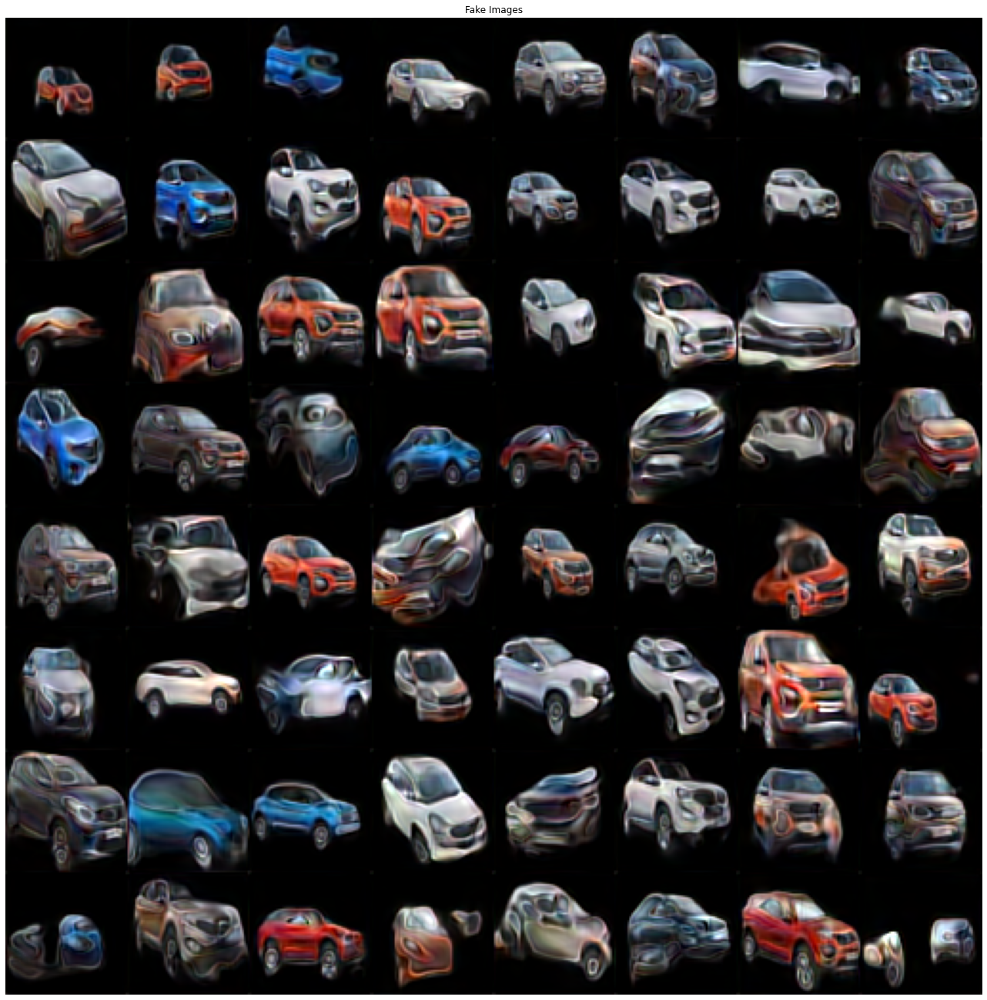

In [ ]:
# weights_path = "/content/ckpt/r1gan_adam_base037400.pth.tar"
# checkpoint = torch.load(weights_path)
# D.load_state_dict(checkpoint['D'])
# G.load_state_dict(checkpoint['G'])
# D_opt.load_state_dict(checkpoint['d_optim'])
# G_opt.load_state_dict(checkpoint['g_optim'])

# save_checkpoint({'global_step': step,
#         'D':D.state_dict(),
#         'G':G.state_dict(),
#         'd_optim': D_opt.state_dict(),
#         'g_optim' : G_opt.state_dict()},
#     'ckpt/r1gan_adam{:06d}.pth.tar'.format(step))

#rand_z = create_graphs_and_samples(img_list, data_loader,(50,50))

rand_z = generate_image_sample((50,50))

#create_graphs_and_samples(img_list, data_loader)

In [ ]:
!echo $(ls -1 /content/ckpt/*|tail -3)

/content/ckpt/r1gan_adam_base040000.pth.tar /content/ckpt/r1gan_adam_base040200.pth.tar /content/ckpt/r1gan_adambase040400.pth.tar


In [ ]:
!cp $(ls -1 /content/ckpt/*_base*|tail -3) /content/drive/My\ Drive/EVA4/S2GAN

In [ ]:
!ls -lrt /content/drive/My\ Drive/EVA4/S2GAN/*base*

-rw------- 1 root root 406940531 Sep 19 20:41 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base031200.pth.tar'
-rw------- 1 root root 406940531 Sep 19 20:41 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base031400.pth.tar'
-rw------- 1 root root 406940531 Sep 19 20:41 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base031600.pth.tar'
-rw------- 1 root root 406940531 Sep 19 22:33 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base037000.pth.tar'
-rw------- 1 root root 406940531 Sep 19 22:33 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base037200.pth.tar'
-rw------- 1 root root 406940531 Sep 19 22:33 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adam_base037400.pth.tar'
-rw------- 1 root root 406940531 Sep 20 11:42 '/content/drive/My Drive/EVA4/S2GAN/r1gan_adambase040400.pth.tar'


In [ ]:
!cp /content/drive/My\ Drive/EVA4/S2GAN/*base* /content/ckpt/

In [ ]:
len(img_list)

300

Animation size has reached 20982323 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


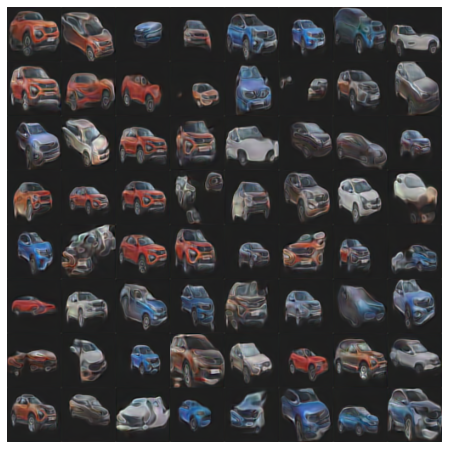

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in img_list[200:]]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


In [ ]:
torch.rand((1,256)).shape

torch.Size([1, 256])

In [ ]:
step_local=step
save_checkpoint({'global_step': step_local,
        'D':D.state_dict(),
        'G':G.state_dict(),
        'd_optim': D_opt.state_dict(),
        'g_optim' : G_opt.state_dict()},
    'ckpt/r1gan_adambase{:06d}.pth.tar'.format(step_local))

#!cp $(ls -1rt /content/ckpt/*|tail -1)  /content/drive/My\ Drive/EVA4/S2GAN

In [ ]:
!cp /content/ckpt/r1gan_adambase040400.pth.tar /content/drive/My\ Drive/EVA4/S2GAN/

cp: cannot stat 'r1gan009800.pth.tar': No such file or directory


In [ ]:
save_checkpoint({'global_step': step,
        'D':D.state_dict(),
        'G':G.state_dict(),
        'd_optim': D_opt.state_dict(),
        'g_optim' : G_opt.state_dict()},
    'ckpt/r1gan{:06d}.pth.tar'.format(step))

In [ ]:
!cp $(ls -1rt /content/ckpt/|tail -1)  /content/drive/My\ Drive/EVA4/S2GAN

cp: cannot stat 'r1gan009904.pth.tar': No such file or directory


In [ ]:
!rm -rf /content/drive/My\ Drive/EVA4/S2GAN/r1gan003600.pth.tar_R1GAN3_1

In [ ]:
#!cp /content/drive/My\ Drive/EVA4/S2GAN/r1gan000200.pth.tar_3 /content/ckpt/r1gan000200.pth.tar 


!cp /content/ckpt/r1gan006904.pth.tar /content/drive/My\ Drive/EVA4/S2GAN/r1gan006904.pth.tar_R1GAN3_1
!cp /content/ckpt/r1gan005200.pth.tar /content/drive/My\ Drive/EVA4/S2GAN/r1gan005200.pth.tar_R1GAN3_1

In [ ]:
next(iter(data_loader)).shape

torch.Size([128, 3, 64, 64])

In [ ]:
criterion = nn.BCELoss()
D_opt = torch.optim.Adam(D.parameters(), lr=0.001, betas=(0.5, 0.999))
G_opt = torch.optim.Adam(G.parameters(), lr=0.001, betas=(0.5, 0.999))

In [ ]:
max_epoch = 100
step = 0
n_critic = 1 # for training more k steps about Discriminator
n_noise = 100

In [ ]:
D_labels = torch.ones([batch_size, 1]).to(DEVICE) # Discriminator Label to real
D_fakes = torch.zeros([batch_size, 1]).to(DEVICE) # Discriminator Label to fake

In [ ]:
torch.rand(1,100).view(20,5).size()

torch.Size([20, 5])

## Sample

In [ ]:
import torchvision.utils as vutils
import matplotlib.pyplot as plt


def create_graphs_and_samples(img_list, data_loader,size_tuple=(30,30)):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()


    real_batch = next(iter(data_loader))

    # Plot the real images
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.axis("off")
    plt.title("Real Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

    # Plot the fake images from the last epoch
    # plt.subplot(1,2,2)
    # plt.axis("off")
    # plt.title("Fake Images")
    # plt.imshow(np.transpose(img_list[-1],(1,2,0)))
    # plt.show()

    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.array(img_list[-1]))#np.transpose(np.array(img_list[-1]),(1,2,0)))
    plt.show()

    return generate_image_sample(size_tuple)

def generate_image_sample(size_tuple=(30,30)):
    output_images,rand_z = get_sample_image(G, n_noise=n_noise, n_samples=64)
    #output_images_list = vutils.make_grid(output_images, padding=2, normalize=True)

    # img_data_np = output_images#.eval()
    # min_val = np.min(img_data_np)
    # max_val = np.max(img_data_np)
    # img_data_clamped = (img_data_np - min_val) / (max_val - min_val)
    plt.figure(figsize=size_tuple)

    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    #plt.imshow(np.transpose(output_images_list,(1,2,0)))
    plt.imshow(np.array(output_images))
    plt.show()
    return rand_z